# DCGAN with attribute
## Architecture:
* <b>image size: (H, W): from (218, 178) to (32, 32)</b>
* <b>Generator:</b> 1 FC + 4 deconv layer <br>
    [**(data)**+**(attr)**] 
    -> [FC] -> flatten -> BN1 -> lReLU1  <br>
    ->[Decv2] -> BN2 -> lReLU2 <br>
    ->[Decv3] -> BN3 -> lReLU3 <br>
    ->[Decv4] -> sigmoid<br>
* <b>Discriminator:</b>4 conv layer + 1 FC layer <br>
    [**(data)**] 
    ->[Conv1] -> lReLU1 -> <br>
    ->[Conv2] -> BN2 -> lReLU2 <br>
    ->[Conv3] -> BN3 -> lReLU3 <br>
    ->flatten + **(attr)** -> [FC]<br>

In [40]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import scipy.misc
import pandas as pd
import os
import math
%matplotlib inline

# for auto-reloading external modules
%load_ext autoreload
%autoreload 2

batchsize = 32
num_of_img = 1000
Z_dim = 100  # noize dim
X_dim = 116412 # 178 * 218 * 3
y_dim = 23 # total attr dim
h_dim = 128 # last FC hidden layer

H_ = 32 
W_ = 32 


### det directory
OUTPUT_DIR = 'o_1126_interactive_20k/'
MODEL_DIR = 'model1126_20k/'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Data preprocessing
* helper function for risizee image
* load data & attr
* choose choose specific features for observation

In [41]:
def center_crop(x, crop_h, crop_w,
                resize_h=64, resize_w=64):
    if crop_w is None:
        crop_w = crop_h
    h, w = x.shape[:2]
    j = int(round((h - crop_h)/2.))
    i = int(round((w - crop_w)/2.))
    return scipy.misc.imresize(
        x[j:j+crop_h, i:i+crop_w], [resize_h, resize_w])

def transform(image, input_height, input_width, 
              resize_height=64, resize_width=64, crop=True):
    if crop:
        cropped_image = center_crop(
          image, input_height, input_width, 
          resize_height, resize_width)
    else:
        cropped_image = scipy.misc.imresize(image, [resize_height, resize_width])
#     return np.array(cropped_image)/127.5 - 1.
    return np.array(cropped_image)/255.

In [42]:
def load_train_data():
#     cols = ["Arched_Eyebrows", "Bags_Under_Eyes", "Bangs", "Big_Lips", "Big_Nose", "Black_Hair", "Blond_Hair", "Brown_Hair",
#        "Bushy_Eyebrows","Eyeglasses","Heavy_Makeup","High_Cheekbones","Male", "Mouth_Slightly_Open","Narrow_Eyes",
#        "No_Beard","Oval_Face","Pointy_Nose","Smiling","Straight_Hair","Wavy_Hair","Wearing_Hat","Young"]
    cols = ["Black_Hair", "Blond_Hair", "Brown_Hair", "Heavy_Makeup", "Male", "Smiling"]
#     cols = ["Black_Hair", "Blond_Hair", "Eyeglasses", "Male", "Heavy_Makeup", "Smiling", "Wearing_Hat", "Young"]

    attr = pd.read_csv('data/list_attr_celeba.csv', delim_whitespace=True, skiprows=1, usecols=cols)

    attr = attr.values[:num_of_img]
    print("shape of attr: {}".format(attr.shape))
   
    X = []

    for i in range(num_of_img):
        X_ = scipy.misc.imread('data/img_align_celeba/{:06d}.jpg'.format(i + 1))
        X_ = transform(X_, 218, 178, H_, W_, True)
        X_ = X_.reshape(H_ * W_ * 3)
        #X_ = np.concatenate([X_, attr[i]])
        X.append(X_)

    X = np.array(X)
    
   
    #print
    print("shape of one image: {}".format(X[0].shape))
    print("min of one image: {}".format(np.amin(X[0])))
    print("max of one image: {}".format(np.amax(X[0])))
    print("shape of X: {}".format(X.shape))
    
    return X, attr


In [43]:
#####################################################################
###           choose specific features for observation            ###
#####################################################################
# features = [("Arched_Eyebrows", -1), ("Bags_Under_Eyes", -1), ("Bangs", 1), ("Big_Lips", -1), ("Big_Nose", -1),
#             ("Black_Hair", -1), ("Blond_Hair", 1), ("Brown_Hair", -1), ("Bushy_Eyebrows", -1), ("Eyeglasses", -1),
#             ("Heavy_Makeup", -1), ("High_Cheekbones", 1), ("Male", 1), ("Mouth_Slightly_Open", -1), ("Narrow_Eyes", 1),
#             ("No_Beard", -1), ("Oval_Face", 1), ("Pointy_Nose", -1), ("Smiling", 1), 
#             ("Straight_Hair", 1), ("Wavy_Hair", -1), ("Wearing_Hat", -1), ("Young", 1)]
# features = map(lambda x: x[1], features)

features = [1, 0, 0, 0, 0, 1] # Male, 1 # Smiling, 1
# features = [1, 0, 1, 1, 0, 1, 0, 1] 
# cols = ["Black_Hair", "Blond_Hair", "Eyeglasses", "Male", "No_Beard", "Smiling", "Wearing_Hat", "Young"]
# Black_Hair, 1  # Blond_Hair, 0 # Eyeglasses, 1  # Male, 1 #  No_Beard, 0 # Smiling, 1 # Wearing_Hat, 1  # Young, 1

# store sample feature
sample_features = np.array(features).reshape((-1,len(features)))
attr_dim = len(features) # desired sample attr dim
print(sample_features)
#####################################################################
###                        Load celeb data                        ###
#####################################################################
# (1) reshape date (2) select desired attributes
celeb_data, attr = load_train_data()
celeb_data = celeb_data.reshape((celeb_data.shape[0], H_, W_, 3))

[[1 0 0 0 0 1]]
shape of attr: (1000, 6)
shape of one image: (3072,)
min of one image: 0.0078431372549
max of one image: 0.996078431373
shape of X: (1000, 3072)


shape of desired_attr: (1000, 6)
shape of one image: (32, 32, 3)
feature of the image: [0 0 1 1 0 1]
shape of one image: (32, 32, 3)
feature of the image: [0 0 1 0 0 1]
shape of one image: (32, 32, 3)
feature of the image: [0 0 0 0 1 0]


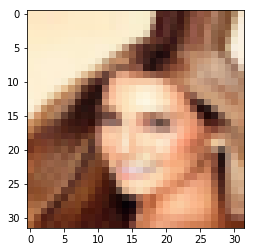

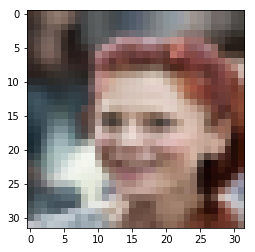

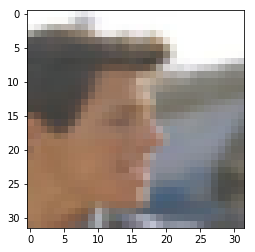

In [44]:
desired_attr = attr # index 12: Male, index 18: Smiling
print "shape of desired_attr: {}".format(desired_attr.shape)

# store training data and attr
train_samples = celeb_data, desired_attr.reshape((-1, attr_dim))

# cols = ["Black_Hair", "Blond_Hair", "Eyeglasses", "Male", "No_Beard", "Smiling", "Wearing_Hat", "Young"]
# check training data and feature
print("shape of one image: {}".format(train_samples[0][0].shape))
print("feature of the image: {}".format(train_samples[1][0]))
fig = plt.figure()
plt.imshow(train_samples[0][0])

print("shape of one image: {}".format(train_samples[0][1].shape))
print("feature of the image: {}".format(train_samples[1][1]))
fig = plt.figure()   
plt.imshow(train_samples[0][1])
print("shape of one image: {}".format(train_samples[0][2].shape))
print("feature of the image: {}".format(train_samples[1][2]))
fig = plt.figure()   
plt.imshow(train_samples[0][2])

## Implement GAN

* (1) define layer function
* (2) DCGAN

In [53]:
def viz_grid(Xs, padding):
    N, H, W, C = Xs.shape
    grid_size = int(math.ceil(math.sqrt(N)))
    grid_height = H * grid_size + padding * (grid_size + 1)
    grid_width = W * grid_size + padding * (grid_size + 1)
    grid = np.zeros((grid_height, grid_width, C))
    next_idx = 0
    y0, y1 = padding, H + padding
    for y in range(grid_size):
        x0, x1 = padding, W + padding
        for x in range(grid_size):
            if next_idx < N:
                img = Xs[next_idx]
                grid[y0:y1, x0:x1] = img
                next_idx += 1
            x0 += W + padding
            x1 += W + padding
        y0 += H + padding
        y1 += H + padding
    return grid

def conv2d(input, kernel_size, stride, num_filter, name = 'conv2d'):
    with tf.variable_scope(name):
        stride_shape = [1, stride, stride, 1]
        filter_shape = [kernel_size, kernel_size, input.get_shape()[3], num_filter]

        W = tf.get_variable('w', filter_shape, tf.float32, tf.random_normal_initializer(0.0, 0.02))
        b = tf.get_variable('b', [1, 1, 1, num_filter], initializer = tf.constant_initializer(0.0))
        return tf.nn.conv2d(input, W, stride_shape, padding = 'SAME') + b

def conv2d_transpose(input, kernel_size, stride, num_filter, name = 'conv2d_transpose'):
    with tf.variable_scope(name):
        stride_shape = [1, stride, stride, 1]
        filter_shape = [kernel_size, kernel_size, num_filter, input.get_shape()[3]]
        output_shape = tf.stack([tf.shape(input)[0], tf.shape(input)[1] * 2, tf.shape(input)[2] * 2, num_filter])

        W = tf.get_variable('w', filter_shape, tf.float32, tf.random_normal_initializer(0.0, 0.02))
        b = tf.get_variable('b', [1, 1, 1, num_filter], initializer = tf.constant_initializer(0.0))
        return tf.nn.conv2d_transpose(input, W, output_shape, stride_shape, padding = 'SAME') + b

def fc(input, num_output, name = 'fc'):
    with tf.variable_scope(name):
        num_input = input.get_shape()[1]
        W = tf.get_variable('w', [num_input, num_output], tf.float32, tf.random_normal_initializer(0.0, 0.02))
        b = tf.get_variable('b', [num_output], initializer = tf.constant_initializer(0.0))
        return tf.matmul(input, W) + b

def batch_norm(input, is_training):
    out = tf.contrib.layers.batch_norm(input, decay = 0.99, center = True, scale = True,
                                       is_training = is_training, updates_collections = None)
    return out

def leaky_relu(input, alpha = 0.2):
    return tf.maximum(alpha * input, input)

In [54]:
class DCGAN(object):

    def __init__(self):
        self.num_epoch = 20
        self.batch_size = batchsize
        self.log_step = 50
        self.visualize_step = 200
        #self.code_size = 100 #64
        #self.attr_size = 2
        self.attr_size = attr_dim
        self.learning_rate = 8e-5
        self.vis_learning_rate = 1e-2
        self.recon_steps = 100
        self.actmax_steps = 100
        self.rec_rate = 0.5
        
        self._dis_called = False
        self._gen_called = False
    
        self.tracked_noise = tf.placeholder(tf.float32, [None, H_, W_, 3])

        self.real_input = tf.placeholder(tf.float32, [None, H_, W_, 3])
        self.real_label = tf.placeholder(tf.float32, [None, 1])
        self.fake_label = tf.placeholder(tf.float32, [None, 1])
        self.noise = tf.placeholder(tf.float32, [None, H_, W_, 3])
        self.attr = tf.placeholder(tf.float32, [None, self.attr_size])
        self.mismatch_attr = tf.placeholder(tf.float32, [None, self.attr_size])
        
        
        self.is_train = tf.placeholder(tf.bool)
        
        self.recon_sample = tf.placeholder(tf.float32, [1, 32, 32, 3])
        self.actmax_label = tf.placeholder(tf.float32, [1, 1])
        
        with tf.variable_scope('actmax'):
            self.actmax_attr = tf.placeholder(tf.float32, [1, self.attr_size])
#             tf.get_variable('actmax_code', [1, self.attr_size])
            self.actmax_code = tf.get_variable('actmax_code', [1, H_, W_, 3],
                                               initializer = tf.constant_initializer(0.0))
        
        self._init_ops()

    def _discriminator(self, inputs, attr_):
        # We have multiple instances of the discriminator in the same computation graph,
        # so set variable sharing if this is not the first invocation of this function.
        with tf.variable_scope('dis', reuse = self._dis_called):
            self._dis_called = True
            print inputs
            attr_ = tf.tile(tf.expand_dims(tf.tile(tf.expand_dims(attr_, 1), [1, 32, 1]), 1), [1, 32, 1, 1])
            print "attr_: {}".format(attr_)
            inputs = tf.concat([inputs, attr_], axis = 3)
            print "inputs: {}".format(inputs)
            dis_conv1 = conv2d(inputs, 4, 2, 32, 'conv1')
            dis_lrelu1 = leaky_relu(dis_conv1)
            dis_conv2 = conv2d(dis_lrelu1, 4, 2, 64, 'conv2')
            dis_batchnorm2 = batch_norm(dis_conv2, self.is_train)
            dis_lrelu2 = leaky_relu(dis_batchnorm2)
            dis_conv3 = conv2d(dis_lrelu2, 4, 2, 128, 'conv3')
            dis_batchnorm3 = batch_norm(dis_conv3, self.is_train)
            dis_lrelu3 = leaky_relu(dis_batchnorm3)
            dis_reshape3 = tf.reshape(dis_lrelu3, [-1, 4 * 4 * 128])
            # dis_addAttr3 = tf.concat([dis_reshape3, attr_], axis = 1)
            dis_fc4 = fc(dis_reshape3, 1, 'fc4')
            dis_prob = tf.nn.sigmoid(dis_fc4)
            return tf.reduce_mean(dis_prob), dis_fc4

    def _generator(self, noise, attr_):
        with tf.variable_scope('gen', reuse = self._gen_called):
            self._gen_called = True
            
#             attr_ = tf.tile(tf.expand_dims(tf.tile(tf.expand_dims(attr_, 1), [1, 32, 1]), 1), [1, 32, 1, 1])
#             print "gen_attr_ dim: {}".format(attr_)
#             noise_attr = tf.concat([noise, attr_], axis = 3)
#             print "gen_input dim: {}".format(noise)
#             inputs = tf.reshape(noise_attr, [-1, H_*W_*int(noise_attr.shape[3])])
#             print "gen_flatten dim: {}".format(inputs)
            noise_flat = tf.reshape(noise, [-1, H_*W_*int(noise.shape[3])])
            
            attr_ = tf.reshape(attr_, [-1, int(attr_.shape[1]), 1])
            attr_ = tf.tile(attr_, [1, 1, 10])
            attr_ = tf.reshape(attr_, [-1, 10 * int(attr_.shape[1])])
            print "gen_attr_ dim: {}".format(attr_)
            
            noise_attr = tf.concat([noise_flat, attr_], axis = 1)
            gen_fc1 = fc(noise_attr, 4 * 4 * 128, 'fc1')
            gen_reshape1 = tf.reshape(gen_fc1, [-1, 4, 4, 128])
            gen_batchnorm1 = batch_norm(gen_reshape1, self.is_train)
            gen_lrelu1 = leaky_relu(gen_batchnorm1)
            gen_conv2 = conv2d_transpose(gen_lrelu1, 5, 2, 64, 'conv2')
            gen_batchnorm2 = batch_norm(gen_conv2, self.is_train)
            gen_lrelu2 = leaky_relu(gen_batchnorm2)
            gen_conv3 = conv2d_transpose(gen_lrelu2, 5, 2, 32, 'conv3')
            gen_batchnorm3 = batch_norm(gen_conv3, self.is_train)
            gen_lrelu3 = leaky_relu(gen_batchnorm3)
            gen_conv4 = conv2d_transpose(gen_lrelu3, 5, 2, 3, 'conv4')
            gen_sigmoid4 = tf.sigmoid(gen_conv4)
            return gen_sigmoid4

    def _loss(self, labels, logits):
        loss = tf.nn.sigmoid_cross_entropy_with_logits(labels = labels, logits = logits)
        return tf.reduce_mean(loss)

    def _reconstruction_L1loss(self, generated, target):
        loss = tf.abs(generated - target)
        return tf.reduce_mean(loss)
    
    def _reconstruction_L2loss(self, generated, target):
        loss = tf.nn.l2_loss(generated - target)
        return tf.reduce_mean(loss)
    
    # Define operations
    def _init_ops(self):
        
        self.fake_samples_op = self._generator(self.noise, self.attr)
        self.D_fake_prob, D_fake = self._discriminator(self.fake_samples_op, self.attr)
        self.D_real_prob, D_real = self._discriminator(self.real_input, self.attr)
        self.D_mis_prob, D_mismatch = self._discriminator(self.real_input, self.mismatch_attr)
        
        self.dis_loss_op = self._loss(self.real_label, D_real) + self._loss(self.fake_label, D_fake) + self._loss(self.fake_label, D_mismatch)
        self.gen_loss_op = self._loss(self.real_label, D_fake)
        self.recon_loss_op = self.rec_rate * self._reconstruction_L1loss(self.noise, self.fake_samples_op)
        
        all_vars = tf.trainable_variables()

        d_var = [v for v in all_vars if v.name.startswith('dis')]
        g_var = [v for v in all_vars if v.name.startswith('gen')]
        
        # print the var status to check var
        import tensorflow.contrib.slim as slim
        print("********* d_var ********** ")
        slim.model_analyzer.analyze_vars(d_var, print_info=True)
        print("********* g_var ********** ") 
        slim.model_analyzer.analyze_vars(g_var, print_info=True)

        dis_optimizer = tf.train.RMSPropOptimizer(self.learning_rate)
        self.dis_train_op = dis_optimizer.minimize(self.dis_loss_op, var_list = d_var)
        
        gen_optimizer = tf.train.RMSPropOptimizer(self.learning_rate)
        self.gen_train_op = gen_optimizer.minimize(self.gen_loss_op, var_list = g_var)
        
        recon_optimizer = tf.train.AdamOptimizer(self.learning_rate)
        self.reconstruct_op = recon_optimizer.minimize(self.recon_loss_op, var_list = g_var)
        
#         ##
#         self.actmax_sample_op = self._generator(self.actmax_code, self.actmax_attr)
#         actmax_dis = self._discriminator(self.actmax_sample_op, self.actmax_attr)
#         self.actmax_loss_op = self._loss(self.actmax_label, actmax_dis)

#         actmax_optimizer = tf.train.AdamOptimizer(self.vis_learning_rate)
#         self.actmax_op = actmax_optimizer.minimize(self.actmax_loss_op, var_list = [self.actmax_code])
        
#         ##
#         self.recon_loss_op = self._reconstruction_loss(self.actmax_sample_op, self.recon_sample)
        
#         recon_optimizer = tf.train.AdamOptimizer(self.vis_learning_rate)
#         self.reconstruct_op = recon_optimizer.minimize(self.recon_loss_op, var_list = [self.actmax_code])
    # Pretrain 
    # Training function
    def train(self, sess, train_samples, sample_features, load_flag = False):
        if not load_flag:
            sess.run(tf.global_variables_initializer())
    
        train_data, train_attr= train_samples
        num_train = train_data.shape[0]
        step = 0
        
        # smooth the loss curve so that it does not fluctuate too much
        smooth_factor = 0.95
        plot_dis_s = 0
        plot_gen_s = 0
        plot_recon_s = 0
        plot_ws = 0
        
        plot_dis_f = 0
        plot_dis_r = 0
        plot_dis_m = 0
        
        dis_losses = []
        fakes = []
        reals = []
        mismatchs = []
        gen_losses = []
        recon_losses = []
        
        import copy
        update_ratio = 2
        gen_loss = 0.0
        dis_loss = 0.0
        recon_loss = 0.0
        for epoch in range(self.num_epoch):
            for i in range(num_train // self.batch_size):
                step += 1
                                                          
                batch_data = train_data[i * self.batch_size : (i + 1) * self.batch_size]
                batch_attr = train_attr[i * self.batch_size : (i + 1) * self.batch_size]
#                 noise = np.random.normal(0, 1, [self.batch_size, H_, W_, 3])
                if i == 0:
                    noise = batch_data[0:self.batch_size]
#                     noise = np.random.normal(0, 1, [self.batch_size, H_, W_, 3])
                else:
                    noise = gen_out
                
                
                if i % 500 == 0:
                    print str(epoch) +" "+ str(i)
                    fig = plt.figure(figsize = (6, 6)) 
                    ax1 = plt.subplot(111)
                    image = viz_grid(noise, 1)
                    ax1.imshow(image)
                    plt.show()
                
                zeros = np.zeros([self.batch_size, 1])
                ones = np.ones([self.batch_size, 1])
                mismatch_attr = copy.deepcopy(batch_attr)
                for i in range(len(mismatch_attr)):
                    """
                    print("before")
                    print(mismatch_attr[i])
                    print(batch_attr[i])
                    """
                    for j in range(len(mismatch_attr[i])):
                        """
                        if i == 0:
                            print("before")
                            print(mismatch_attr[i][j])
                            print(batch_attr[i][j])
                        """
                        if mismatch_attr[i][j] == 0:
                            mismatch_attr[i][j] = 1
                        else:
                            mismatch_attr[i][j] = 0
                        """
                        if i == 0:
                            print("after")
                            print(mismatch_attr[i][j])
                            print(batch_attr[i][j])
                        """
                    """
                    print("after")
                    print(mismatch_attr[i])
                    print(batch_attr[i])
                    """
#                 print "attr shape: {} {}".format(batch_attr.shape, mismatch_attr.shape)
                if batch_attr.shape[0] != self.batch_size:
                    print "Error: attr shape not match: attr shape {}, batch size {}".format(batch_attr.shape, self.batch_size)
                    continue
                dis_feed_dict = {self.real_input: batch_data, 
                                 self.noise: noise, 
                                 self.attr: batch_attr,
                                 self.mismatch_attr: mismatch_attr,
                                 self.real_label: ones, 
                                 self.fake_label: zeros, 
                                 self.is_train:True}
                
                gen_feed_dict = {self.noise: noise, 
                                 self.attr: batch_attr,
                                 self.real_label: ones, 
                                 self.is_train: True}
                """
                if i % update_ratio == 0:
                    _, dis_loss = sess.run([self.dis_train_op, self.dis_loss_op], feed_dict = dis_feed_dict)
                else:
                    _, gen_loss = sess.run([self.gen_train_op, self.gen_loss_op], feed_dict = gen_feed_dict)
                """
                _, dis_loss, dis_fake, dis_real, dis_mis = sess.run([self.dis_train_op, self.dis_loss_op, self.D_fake_prob,
                                                                    self.D_real_prob, self.D_mis_prob], feed_dict = dis_feed_dict)
                if i == 0:
                    _, gen_loss, gen_out = sess.run([self.gen_train_op, self.gen_loss_op, self.fake_samples_op], feed_dict = gen_feed_dict)
                else:
                    _, gen_loss, gen_out, recon_loss, _ = sess.run([self.gen_train_op, self.gen_loss_op, self.fake_samples_op, self.recon_loss_op, self.reconstruct_op], feed_dict = gen_feed_dict)
                
                plot_dis_s = plot_dis_s * smooth_factor + dis_loss * (1 - smooth_factor)
                plot_gen_s = plot_gen_s * smooth_factor + gen_loss * (1 - smooth_factor)
                plot_recon_s = plot_recon_s * smooth_factor + recon_loss * (1 - smooth_factor)
                plot_ws = plot_ws * smooth_factor + (1 - smooth_factor)
                dis_losses.append(plot_dis_s / plot_ws)
                gen_losses.append(plot_gen_s / plot_ws)
                recon_losses.append(plot_recon_s / plot_ws)
                
                plot_dis_f = plot_dis_f * smooth_factor + dis_fake * (1 - smooth_factor)
                plot_dis_r = plot_dis_r * smooth_factor + dis_real * (1 - smooth_factor)
                plot_dis_m = plot_dis_m * smooth_factor + dis_mis * (1 - smooth_factor)
                fakes.append(plot_dis_f / plot_ws)
                reals.append(plot_dis_r / plot_ws)
                mismatchs.append(plot_dis_m / plot_ws)

                if step % self.log_step == 0:
                    print('Iteration {0}: dis loss = {1:.4f}, gen loss = {2:.4f}, recon loss = {2:.4f}'.format(step, dis_loss, gen_loss, recon_loss))
    
            
            if not os.path.exists(MODEL_DIR):
                os.mkdir(MODEL_DIR)
                
            if not os.path.exists(OUTPUT_DIR):
                os.mkdir(OUTPUT_DIR)
                
            filename = OUTPUT_DIR + '%d_%d.png' % (epoch,i)
            
            n = 50 # random number
            self.tracked_noise = train_data[n:n+64]
            fig = plt.figure(figsize = (8, 8)) 
            ax0 = plt.subplot(111)
            image = viz_grid(self.tracked_noise, 1)
            ax0.imshow(image)
            plt.show()
            
            fig = plt.figure(figsize = (8, 8)) 
            ax1 = plt.subplot(111)
            image = viz_grid(self.generate(self.tracked_noise, sample_features), 1)
            scipy.misc.imsave(filename, image)
            ax1.imshow(image)
            plt.show()

            plt.plot(dis_losses)
            plt.title('discriminator loss')
            plt.xlabel('iterations')
            plt.ylabel('loss')
            plt.show()
            
            plt.plot(fakes, label="fake", color="blue")
            plt.plot(reals, label="real", color="red")
            plt.plot(mismatchs, label="mismatch", color="green")
            plt.legend(['fake', 'real', 'mismatch'], loc='upper left')
            plt.title('D_fake_real_mis')
            plt.xlabel('iterations')
            plt.ylabel('prob')
            plt.show()

            plt.plot(gen_losses)
            plt.title('generator loss')
            plt.xlabel('iterations')
            plt.ylabel('loss')
            plt.show()
            
            plt.plot(recon_losses)
            plt.title('reconstruction loss')
            plt.xlabel('iterations')
            plt.ylabel('loss')
            plt.show()
            
            dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
            gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
            saver = tf.train.Saver(dis_var_list + gen_var_list)
            saver.save(sess, MODEL_DIR + 'dcgan_%d' % epoch)

    # Find the reconstruction of one input sample
    def reconstruct_one_sample(self, sample):
        ##
        code = np.random.random([1, H_, W_, 3])
        actmax_init_val = tf.convert_to_tensor(code, dtype = tf.float32)
        
        sess.run(self.actmax_code.assign(actmax_init_val))
        last_reconstruction = None
        last_loss = None
        for i in range(self.recon_steps):
        
            ##
            recon_feed_dict = {self.recon_sample: sample, 
                               self.is_train: False}
            
            run_ops = [self.recon_loss_op, self.reconstruct_op, self.actmax_sample_op]
            last_loss, _, last_reconstruction = sess.run(run_ops, feed_dict = recon_feed_dict)
        return last_loss, last_reconstruction

    # Find the reconstruction of a batch of samples
    def reconstruct(self, samples):
        reconstructions = np.zeros(samples.shape)
        total_loss = 0
        for i in range(samples.shape[0]):
            loss, reconstructions[i:i+1] = self.reconstruct_one_sample(samples[i:i+1])
            total_loss += loss
        return total_loss / samples.shape[0], reconstructions

    # Generates a single sample from input code
    def generate_one_sample(self, code, attr_):

        gen_vis_feed_dict = {self.noise: code, 
                             self.attr: attr_, 
                             self.is_train: False}
        
        generated = sess.run(self.fake_samples_op, feed_dict = gen_vis_feed_dict)
        return generated

    # Generates samples from input batch of codes
    def generate(self, codes, attr_):
        generated = np.zeros((codes.shape[0], H_, W_, 3))
        for i in range(codes.shape[0]):
            generated[i:i+1] = self.generate_one_sample(codes[i:i+1], attr_)
        return generated

    # Perform activation maximization on one initial code
    def actmax_one_sample(self, initial_code):
        
        ##
        actmax_init_val = tf.convert_to_tensor(initial_code, dtype = tf.float32)
        sess.run(self.actmax_code.assign(actmax_init_val))
        for i in range(self.actmax_steps):
            actmax_feed_dict = {
                self.actmax_label: np.ones([1, 1]),
                self.is_train: False
            }
            _, last_actmax = sess.run([self.actmax_op, self.actmax_sample_op], feed_dict = actmax_feed_dict)
        return last_actmax

    # Perform activation maximization on a batch of different initial codes
    def actmax(self, initial_codes):
        actmax_results = np.zeros((initial_codes.shape[0], 32, 32, 3))
        for i in range(initial_codes.shape[0]):
            actmax_results[i:i+1] = self.actmax_one_sample(initial_codes[i:i+1])
        return actmax_results.clip(0, 1)

## Training
* start to train
* save the trained model at 'model/dcgan' 
* save output image & loss curve at OUTPUT_DIR


gen_attr_ dim: Tensor("gen/Reshape_2:0", shape=(?, 60), dtype=float32, device=/device:CPU:0)
Tensor("gen/Sigmoid:0", shape=(?, ?, ?, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
Tensor("Placeholder_1:0", shape=(?, 32, 32, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis_1/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis_1/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
Tensor("Placeholder_1:0", shape=(?, 32, 32, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis_2/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis_2/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
********* d_var ********** 
---------
Variables: name (type shape) [size]
---------
dis/conv1/w:0 (float32_ref 

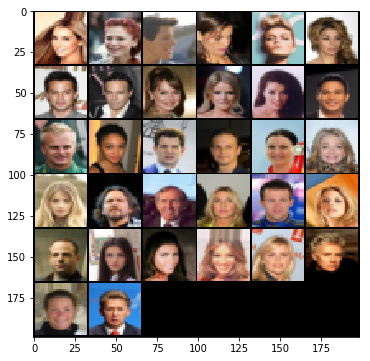

Iteration 50: dis loss = 1.4084, gen loss = 1.2436, recon loss = 1.2436
Iteration 100: dis loss = 0.3342, gen loss = 2.4849, recon loss = 2.4849
Iteration 150: dis loss = 0.0704, gen loss = 4.1237, recon loss = 4.1237
Iteration 200: dis loss = 0.0944, gen loss = 4.2844, recon loss = 4.2844
Iteration 250: dis loss = 0.0228, gen loss = 5.2904, recon loss = 5.2904
Iteration 300: dis loss = 0.0669, gen loss = 6.7947, recon loss = 6.7947
Iteration 350: dis loss = 0.0143, gen loss = 5.3951, recon loss = 5.3951
Iteration 400: dis loss = 0.0413, gen loss = 4.9065, recon loss = 4.9065
Iteration 450: dis loss = 0.0482, gen loss = 4.9270, recon loss = 4.9270
Iteration 500: dis loss = 0.0340, gen loss = 4.5624, recon loss = 4.5624
0 500


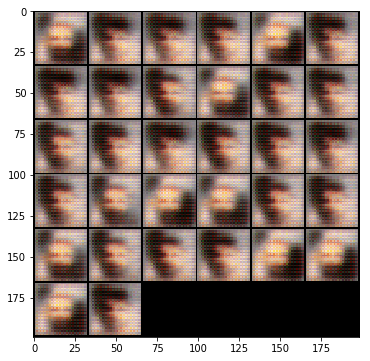

Iteration 550: dis loss = 0.2452, gen loss = 2.3018, recon loss = 2.3018
Iteration 600: dis loss = 1.4546, gen loss = 0.7636, recon loss = 0.7636
Iteration 650: dis loss = 0.8889, gen loss = 1.1457, recon loss = 1.1457
Iteration 700: dis loss = 0.8775, gen loss = 0.7265, recon loss = 0.7265
Iteration 750: dis loss = 1.2809, gen loss = 0.6257, recon loss = 0.6257
Iteration 800: dis loss = 1.0122, gen loss = 0.9524, recon loss = 0.9524
Iteration 850: dis loss = 1.3508, gen loss = 0.7715, recon loss = 0.7715
Iteration 900: dis loss = 1.6133, gen loss = 1.2285, recon loss = 1.2285
Iteration 950: dis loss = 1.2591, gen loss = 0.9455, recon loss = 0.9455
Iteration 1000: dis loss = 1.5856, gen loss = 0.7482, recon loss = 0.7482
0 1000


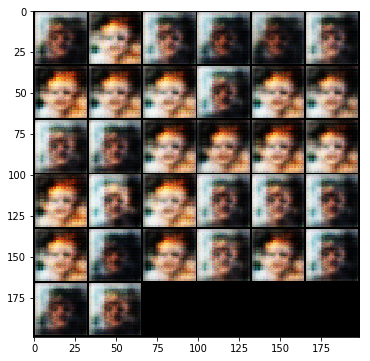

Iteration 1050: dis loss = 1.3813, gen loss = 0.9937, recon loss = 0.9937
Iteration 1100: dis loss = 1.4818, gen loss = 0.8252, recon loss = 0.8252
Iteration 1150: dis loss = 1.6133, gen loss = 0.6917, recon loss = 0.6917
Iteration 1200: dis loss = 1.5397, gen loss = 0.7535, recon loss = 0.7535
Iteration 1250: dis loss = 1.1999, gen loss = 0.9944, recon loss = 0.9944
Iteration 1300: dis loss = 1.2261, gen loss = 0.8484, recon loss = 0.8484
Iteration 1350: dis loss = 1.2489, gen loss = 0.8677, recon loss = 0.8677
Iteration 1400: dis loss = 1.8030, gen loss = 0.5912, recon loss = 0.5912
Iteration 1450: dis loss = 1.3728, gen loss = 0.9864, recon loss = 0.9864
Iteration 1500: dis loss = 1.4360, gen loss = 0.8991, recon loss = 0.8991
0 1500


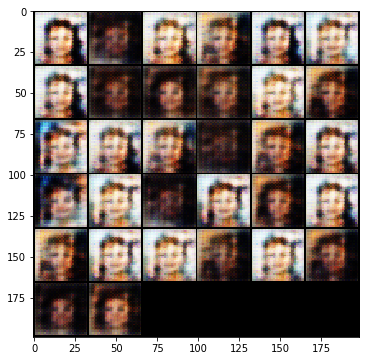

Iteration 1550: dis loss = 1.1971, gen loss = 1.2252, recon loss = 1.2252
Iteration 1600: dis loss = 1.2901, gen loss = 0.8249, recon loss = 0.8249
Iteration 1650: dis loss = 1.5873, gen loss = 0.8199, recon loss = 0.8199
Iteration 1700: dis loss = 1.1735, gen loss = 1.1840, recon loss = 1.1840
Iteration 1750: dis loss = 1.2404, gen loss = 1.0074, recon loss = 1.0074
Iteration 1800: dis loss = 1.0504, gen loss = 1.0545, recon loss = 1.0545
Iteration 1850: dis loss = 1.3811, gen loss = 0.7883, recon loss = 0.7883
Iteration 1900: dis loss = 1.0734, gen loss = 1.1711, recon loss = 1.1711
Iteration 1950: dis loss = 1.4937, gen loss = 0.6699, recon loss = 0.6699
Iteration 2000: dis loss = 1.6847, gen loss = 0.6259, recon loss = 0.6259
0 2000


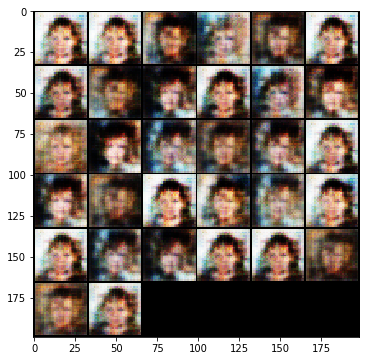

Iteration 2050: dis loss = 1.6152, gen loss = 0.6382, recon loss = 0.6382
Iteration 2100: dis loss = 1.2666, gen loss = 1.1590, recon loss = 1.1590
Iteration 2150: dis loss = 1.4478, gen loss = 0.8745, recon loss = 0.8745
Iteration 2200: dis loss = 1.0770, gen loss = 0.9754, recon loss = 0.9754
Iteration 2250: dis loss = 1.1925, gen loss = 1.0130, recon loss = 1.0130
Iteration 2300: dis loss = 1.1129, gen loss = 1.1668, recon loss = 1.1668
Iteration 2350: dis loss = 0.9657, gen loss = 0.9976, recon loss = 0.9976
Iteration 2400: dis loss = 1.3196, gen loss = 0.8573, recon loss = 0.8573
Iteration 2450: dis loss = 1.1772, gen loss = 1.0203, recon loss = 1.0203
Iteration 2500: dis loss = 1.0938, gen loss = 1.1056, recon loss = 1.1056
0 2500


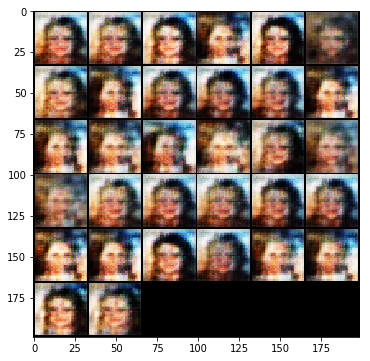

Iteration 2550: dis loss = 1.5201, gen loss = 0.9212, recon loss = 0.9212
Iteration 2600: dis loss = 1.4218, gen loss = 0.7232, recon loss = 0.7232
Iteration 2650: dis loss = 1.1430, gen loss = 1.0965, recon loss = 1.0965
Iteration 2700: dis loss = 1.0142, gen loss = 1.2264, recon loss = 1.2264
Iteration 2750: dis loss = 1.0155, gen loss = 1.2112, recon loss = 1.2112
Iteration 2800: dis loss = 1.6177, gen loss = 0.8575, recon loss = 0.8575
Iteration 2850: dis loss = 1.5558, gen loss = 0.7806, recon loss = 0.7806
Iteration 2900: dis loss = 1.5693, gen loss = 0.6998, recon loss = 0.6998
Iteration 2950: dis loss = 1.3463, gen loss = 1.0860, recon loss = 1.0860
Iteration 3000: dis loss = 1.1010, gen loss = 0.9803, recon loss = 0.9803
0 3000


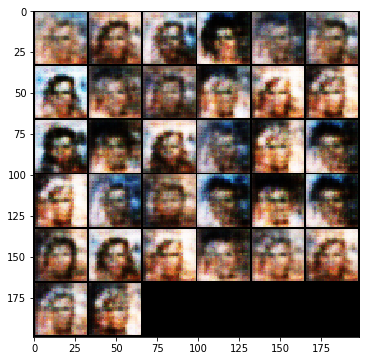

Iteration 3050: dis loss = 1.2150, gen loss = 0.8711, recon loss = 0.8711
Iteration 3100: dis loss = 1.0528, gen loss = 1.0152, recon loss = 1.0152
Iteration 3150: dis loss = 1.3902, gen loss = 1.0164, recon loss = 1.0164
Iteration 3200: dis loss = 1.3235, gen loss = 0.9344, recon loss = 0.9344
Iteration 3250: dis loss = 1.1613, gen loss = 0.8629, recon loss = 0.8629
Iteration 3300: dis loss = 1.6431, gen loss = 0.7158, recon loss = 0.7158
Iteration 3350: dis loss = 1.1756, gen loss = 1.0624, recon loss = 1.0624
Iteration 3400: dis loss = 0.9944, gen loss = 1.1253, recon loss = 1.1253
Iteration 3450: dis loss = 1.1267, gen loss = 1.0325, recon loss = 1.0325
Iteration 3500: dis loss = 1.1346, gen loss = 0.9794, recon loss = 0.9794
0 3500


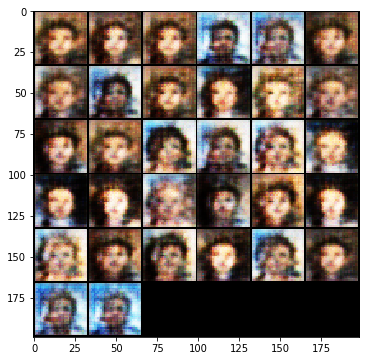

Iteration 3550: dis loss = 1.5002, gen loss = 0.7663, recon loss = 0.7663
Iteration 3600: dis loss = 1.0560, gen loss = 1.1030, recon loss = 1.1030
Iteration 3650: dis loss = 1.5383, gen loss = 0.7794, recon loss = 0.7794
Iteration 3700: dis loss = 1.4502, gen loss = 0.8582, recon loss = 0.8582
Iteration 3750: dis loss = 1.3670, gen loss = 0.6842, recon loss = 0.6842
Iteration 3800: dis loss = 1.1892, gen loss = 0.9760, recon loss = 0.9760
Iteration 3850: dis loss = 1.1053, gen loss = 1.2720, recon loss = 1.2720
Iteration 3900: dis loss = 1.4535, gen loss = 0.7499, recon loss = 0.7499
Iteration 3950: dis loss = 1.2663, gen loss = 1.0154, recon loss = 1.0154
Iteration 4000: dis loss = 1.4098, gen loss = 0.8779, recon loss = 0.8779
0 4000


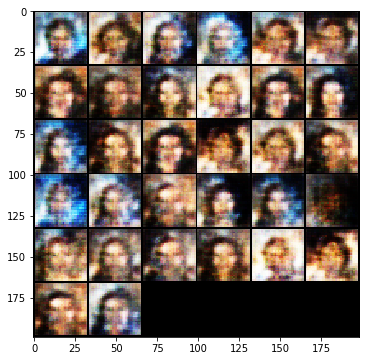

Iteration 4050: dis loss = 1.7015, gen loss = 0.6488, recon loss = 0.6488
Iteration 4100: dis loss = 1.0601, gen loss = 1.1017, recon loss = 1.1017
Iteration 4150: dis loss = 1.5217, gen loss = 0.8567, recon loss = 0.8567
Iteration 4200: dis loss = 1.3041, gen loss = 0.7416, recon loss = 0.7416
Iteration 4250: dis loss = 1.1538, gen loss = 0.7696, recon loss = 0.7696
Iteration 4300: dis loss = 1.1934, gen loss = 1.3188, recon loss = 1.3188
Iteration 4350: dis loss = 1.1775, gen loss = 0.9175, recon loss = 0.9175
Iteration 4400: dis loss = 1.7906, gen loss = 0.6808, recon loss = 0.6808
Iteration 4450: dis loss = 1.5217, gen loss = 0.8965, recon loss = 0.8965
Iteration 4500: dis loss = 1.5290, gen loss = 0.7561, recon loss = 0.7561
0 4500


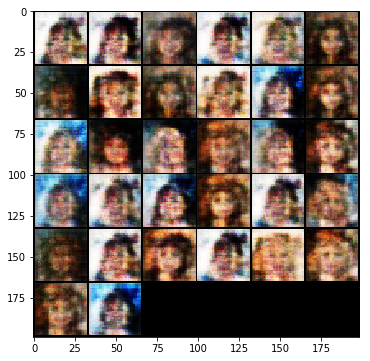

Iteration 4550: dis loss = 1.6323, gen loss = 0.7856, recon loss = 0.7856
Iteration 4600: dis loss = 1.1276, gen loss = 1.0293, recon loss = 1.0293
Iteration 4650: dis loss = 1.4001, gen loss = 0.7988, recon loss = 0.7988
Iteration 4700: dis loss = 1.1908, gen loss = 0.9625, recon loss = 0.9625
Iteration 4750: dis loss = 1.2957, gen loss = 1.0521, recon loss = 1.0521
Iteration 4800: dis loss = 1.3952, gen loss = 0.8291, recon loss = 0.8291
Iteration 4850: dis loss = 1.1812, gen loss = 1.0252, recon loss = 1.0252
Iteration 4900: dis loss = 1.1242, gen loss = 0.9527, recon loss = 0.9527
Iteration 4950: dis loss = 1.3673, gen loss = 0.8417, recon loss = 0.8417
Iteration 5000: dis loss = 1.2195, gen loss = 0.9427, recon loss = 0.9427
0 5000


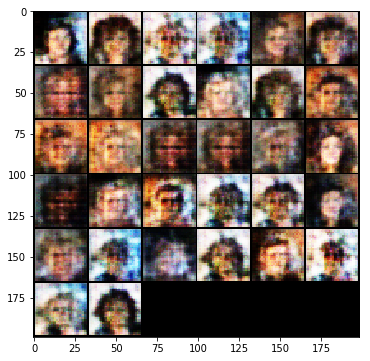

Iteration 5050: dis loss = 1.2534, gen loss = 0.9810, recon loss = 0.9810
Iteration 5100: dis loss = 1.5126, gen loss = 0.8310, recon loss = 0.8310
Iteration 5150: dis loss = 1.1949, gen loss = 0.9106, recon loss = 0.9106
Iteration 5200: dis loss = 1.0758, gen loss = 0.9769, recon loss = 0.9769
Iteration 5250: dis loss = 1.2330, gen loss = 0.7629, recon loss = 0.7629
Iteration 5300: dis loss = 1.1993, gen loss = 0.9015, recon loss = 0.9015
Iteration 5350: dis loss = 1.4633, gen loss = 0.7518, recon loss = 0.7518
Iteration 5400: dis loss = 1.0690, gen loss = 1.0127, recon loss = 1.0127
Iteration 5450: dis loss = 1.2744, gen loss = 0.9391, recon loss = 0.9391
Iteration 5500: dis loss = 1.5816, gen loss = 0.6990, recon loss = 0.6990
0 5500


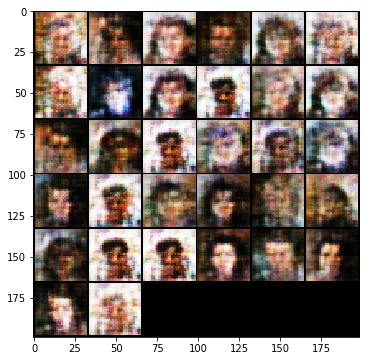

Iteration 5550: dis loss = 1.5291, gen loss = 0.7333, recon loss = 0.7333
Iteration 5600: dis loss = 1.0505, gen loss = 1.0168, recon loss = 1.0168
Iteration 5650: dis loss = 1.5567, gen loss = 0.8593, recon loss = 0.8593
Iteration 5700: dis loss = 1.6819, gen loss = 0.7969, recon loss = 0.7969
Iteration 5750: dis loss = 1.5649, gen loss = 0.7296, recon loss = 0.7296
Iteration 5800: dis loss = 1.3434, gen loss = 0.7845, recon loss = 0.7845
Iteration 5850: dis loss = 1.3856, gen loss = 0.9057, recon loss = 0.9057
Iteration 5900: dis loss = 1.7426, gen loss = 0.6471, recon loss = 0.6471
Iteration 5950: dis loss = 1.5228, gen loss = 0.9220, recon loss = 0.9220
Iteration 6000: dis loss = 1.2315, gen loss = 1.0134, recon loss = 1.0134
0 6000


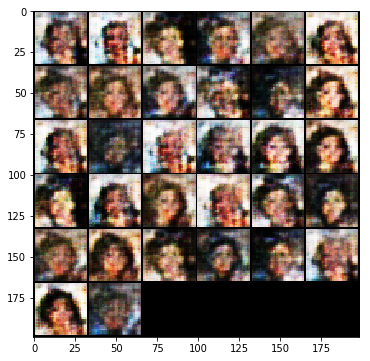

Iteration 6050: dis loss = 1.3871, gen loss = 1.0006, recon loss = 1.0006
Iteration 6100: dis loss = 1.4726, gen loss = 0.8691, recon loss = 0.8691
Iteration 6150: dis loss = 1.4591, gen loss = 0.8760, recon loss = 0.8760
Iteration 6200: dis loss = 1.2802, gen loss = 0.8563, recon loss = 0.8563
Iteration 6250: dis loss = 1.3762, gen loss = 1.0913, recon loss = 1.0913


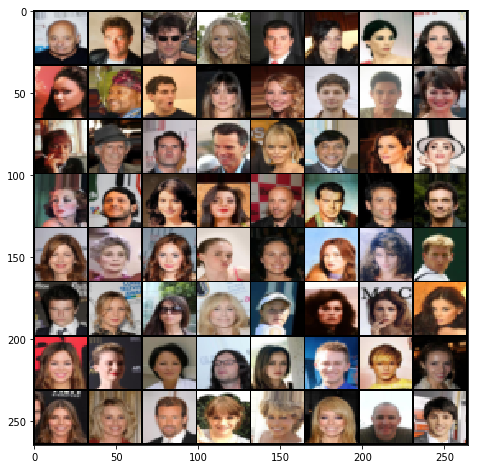

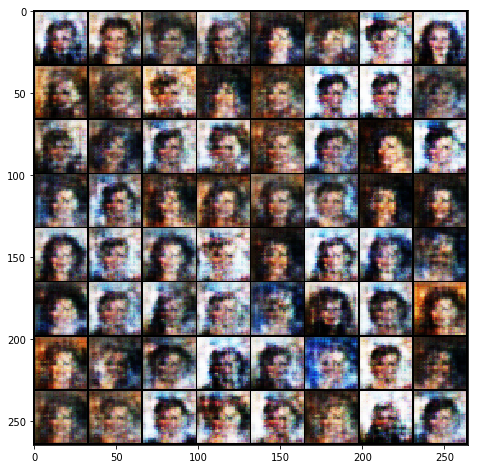

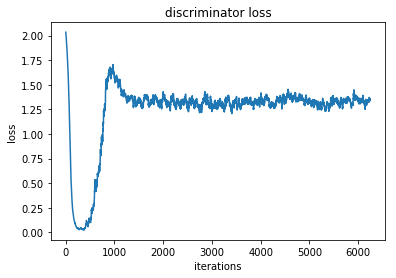

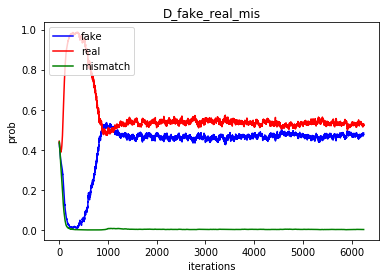

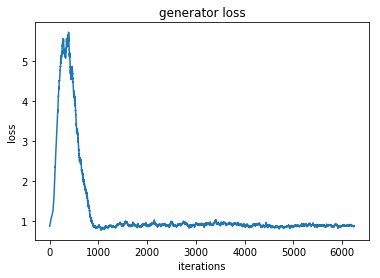

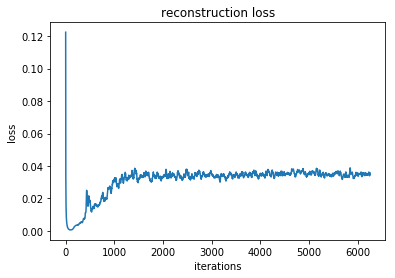

1 0


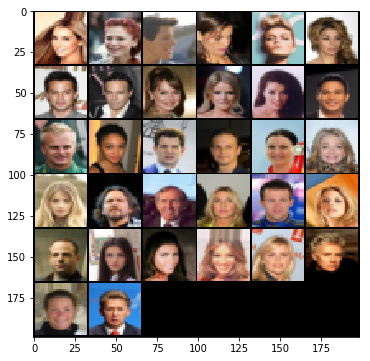

Iteration 6300: dis loss = 1.5103, gen loss = 0.7859, recon loss = 0.7859
Iteration 6350: dis loss = 1.4537, gen loss = 0.9076, recon loss = 0.9076
Iteration 6400: dis loss = 1.3017, gen loss = 0.8141, recon loss = 0.8141
Iteration 6450: dis loss = 1.1097, gen loss = 0.8979, recon loss = 0.8979
Iteration 6500: dis loss = 1.3058, gen loss = 1.0662, recon loss = 1.0662
Iteration 6550: dis loss = 1.6251, gen loss = 0.8803, recon loss = 0.8803
Iteration 6600: dis loss = 1.2904, gen loss = 0.8302, recon loss = 0.8302
Iteration 6650: dis loss = 1.4460, gen loss = 0.9444, recon loss = 0.9444
Iteration 6700: dis loss = 1.3778, gen loss = 0.8788, recon loss = 0.8788
Iteration 6750: dis loss = 1.3094, gen loss = 0.8870, recon loss = 0.8870
1 500


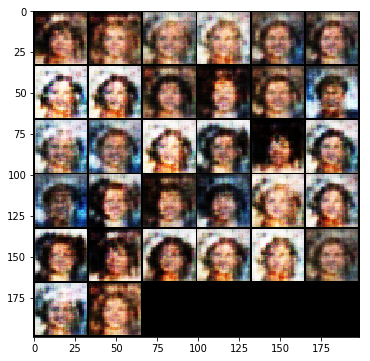

Iteration 6800: dis loss = 1.5344, gen loss = 0.7747, recon loss = 0.7747
Iteration 6850: dis loss = 1.3725, gen loss = 0.8104, recon loss = 0.8104
Iteration 6900: dis loss = 1.3702, gen loss = 0.8901, recon loss = 0.8901
Iteration 6950: dis loss = 1.3711, gen loss = 0.8939, recon loss = 0.8939
Iteration 7000: dis loss = 1.2727, gen loss = 0.8563, recon loss = 0.8563
Iteration 7050: dis loss = 1.1691, gen loss = 0.9191, recon loss = 0.9191
Iteration 7100: dis loss = 1.4247, gen loss = 0.8714, recon loss = 0.8714
Iteration 7150: dis loss = 1.2185, gen loss = 0.8420, recon loss = 0.8420
Iteration 7200: dis loss = 1.2663, gen loss = 0.8838, recon loss = 0.8838
Iteration 7250: dis loss = 1.3034, gen loss = 0.8439, recon loss = 0.8439
1 1000


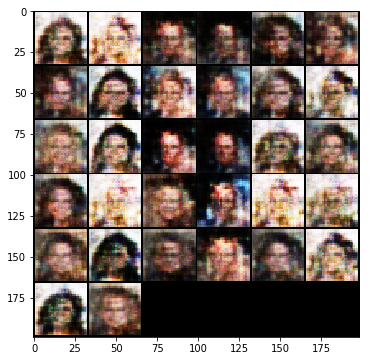

Iteration 7300: dis loss = 1.2858, gen loss = 0.8692, recon loss = 0.8692
Iteration 7350: dis loss = 1.3806, gen loss = 0.7944, recon loss = 0.7944
Iteration 7400: dis loss = 1.4172, gen loss = 0.8993, recon loss = 0.8993
Iteration 7450: dis loss = 1.6534, gen loss = 0.7130, recon loss = 0.7130
Iteration 7500: dis loss = 1.2211, gen loss = 0.8518, recon loss = 0.8518
Iteration 7550: dis loss = 1.4965, gen loss = 0.9141, recon loss = 0.9141
Iteration 7600: dis loss = 1.3271, gen loss = 0.8732, recon loss = 0.8732
Iteration 7650: dis loss = 1.5576, gen loss = 0.7473, recon loss = 0.7473
Iteration 7700: dis loss = 1.2578, gen loss = 0.8498, recon loss = 0.8498
Iteration 7750: dis loss = 1.3615, gen loss = 0.8060, recon loss = 0.8060
1 1500


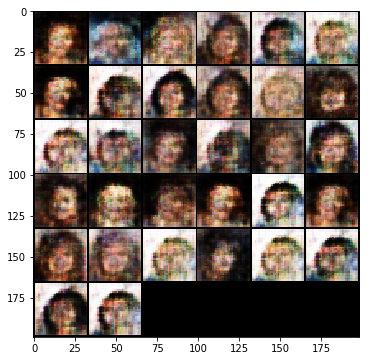

Iteration 7800: dis loss = 1.4807, gen loss = 0.9679, recon loss = 0.9679
Iteration 7850: dis loss = 1.1590, gen loss = 0.9238, recon loss = 0.9238
Iteration 7900: dis loss = 1.1963, gen loss = 0.9018, recon loss = 0.9018
Iteration 7950: dis loss = 1.2410, gen loss = 0.9229, recon loss = 0.9229
Iteration 8000: dis loss = 1.3938, gen loss = 0.8932, recon loss = 0.8932
Iteration 8050: dis loss = 1.1115, gen loss = 0.9711, recon loss = 0.9711
Iteration 8100: dis loss = 1.3323, gen loss = 1.0087, recon loss = 1.0087
Iteration 8150: dis loss = 1.2015, gen loss = 1.0353, recon loss = 1.0353
Iteration 8200: dis loss = 1.6911, gen loss = 0.6521, recon loss = 0.6521
Iteration 8250: dis loss = 1.2815, gen loss = 0.8119, recon loss = 0.8119
1 2000


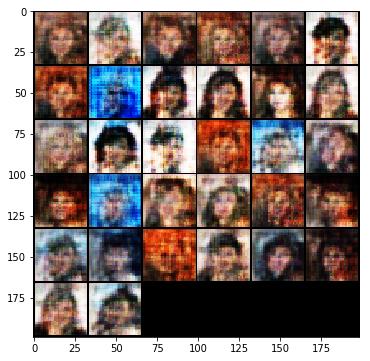

Iteration 8300: dis loss = 1.4972, gen loss = 0.8554, recon loss = 0.8554
Iteration 8350: dis loss = 1.2795, gen loss = 0.8546, recon loss = 0.8546
Iteration 8400: dis loss = 1.5725, gen loss = 0.7286, recon loss = 0.7286
Iteration 8450: dis loss = 1.3360, gen loss = 0.9770, recon loss = 0.9770
Iteration 8500: dis loss = 1.4277, gen loss = 0.7897, recon loss = 0.7897
Iteration 8550: dis loss = 1.1731, gen loss = 1.1025, recon loss = 1.1025
Iteration 8600: dis loss = 0.9990, gen loss = 0.9758, recon loss = 0.9758
Iteration 8650: dis loss = 1.6436, gen loss = 0.7572, recon loss = 0.7572
Iteration 8700: dis loss = 1.5180, gen loss = 0.8512, recon loss = 0.8512
Iteration 8750: dis loss = 1.2124, gen loss = 1.0334, recon loss = 1.0334
1 2500


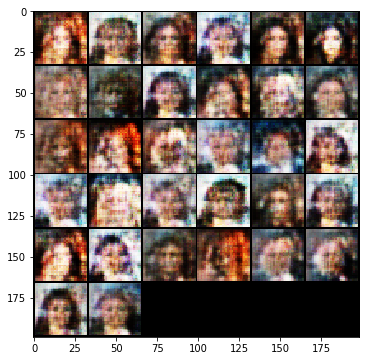

Iteration 8800: dis loss = 1.4379, gen loss = 0.8356, recon loss = 0.8356
Iteration 8850: dis loss = 1.5708, gen loss = 0.7671, recon loss = 0.7671
Iteration 8900: dis loss = 1.4675, gen loss = 0.7693, recon loss = 0.7693
Iteration 8950: dis loss = 1.2670, gen loss = 0.9403, recon loss = 0.9403
Iteration 9000: dis loss = 1.3539, gen loss = 0.8524, recon loss = 0.8524
Iteration 9050: dis loss = 1.3362, gen loss = 0.9520, recon loss = 0.9520
Iteration 9100: dis loss = 1.2218, gen loss = 0.9362, recon loss = 0.9362
Iteration 9150: dis loss = 1.7897, gen loss = 0.6838, recon loss = 0.6838
Iteration 9200: dis loss = 1.2289, gen loss = 0.9989, recon loss = 0.9989
Iteration 9250: dis loss = 1.1348, gen loss = 1.0313, recon loss = 1.0313
1 3000


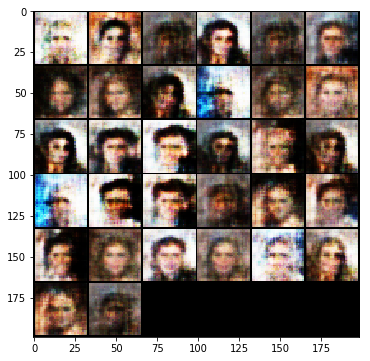

Iteration 9300: dis loss = 1.1279, gen loss = 0.9376, recon loss = 0.9376
Iteration 9350: dis loss = 1.2018, gen loss = 0.8861, recon loss = 0.8861
Iteration 9400: dis loss = 1.3777, gen loss = 0.7765, recon loss = 0.7765
Iteration 9450: dis loss = 1.6568, gen loss = 0.6582, recon loss = 0.6582
Iteration 9500: dis loss = 1.3103, gen loss = 0.7649, recon loss = 0.7649
Iteration 9550: dis loss = 1.4460, gen loss = 0.7753, recon loss = 0.7753
Iteration 9600: dis loss = 1.2634, gen loss = 0.9090, recon loss = 0.9090
Iteration 9650: dis loss = 1.3513, gen loss = 0.9101, recon loss = 0.9101
Iteration 9700: dis loss = 1.3545, gen loss = 0.8311, recon loss = 0.8311
Iteration 9750: dis loss = 1.1149, gen loss = 0.9572, recon loss = 0.9572
1 3500


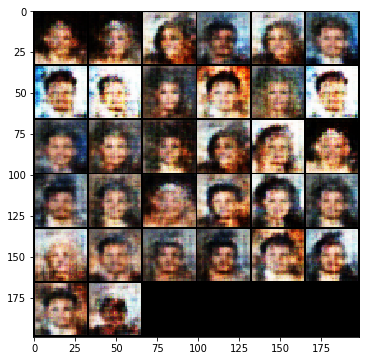

Iteration 9800: dis loss = 1.5766, gen loss = 0.8143, recon loss = 0.8143
Iteration 9850: dis loss = 1.2263, gen loss = 0.9744, recon loss = 0.9744
Iteration 9900: dis loss = 1.6027, gen loss = 0.6172, recon loss = 0.6172
Iteration 9950: dis loss = 1.3860, gen loss = 0.8129, recon loss = 0.8129
Iteration 10000: dis loss = 1.2670, gen loss = 0.8388, recon loss = 0.8388
Iteration 10050: dis loss = 1.1988, gen loss = 0.9810, recon loss = 0.9810
Iteration 10100: dis loss = 0.9431, gen loss = 1.1053, recon loss = 1.1053
Iteration 10150: dis loss = 1.3470, gen loss = 1.0124, recon loss = 1.0124
Iteration 10200: dis loss = 1.3039, gen loss = 0.9572, recon loss = 0.9572
Iteration 10250: dis loss = 1.3427, gen loss = 0.9958, recon loss = 0.9958
1 4000


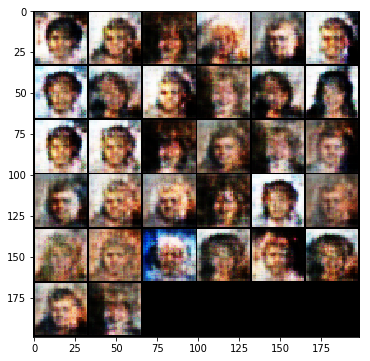

Iteration 10300: dis loss = 1.8308, gen loss = 0.6734, recon loss = 0.6734
Iteration 10350: dis loss = 1.1147, gen loss = 0.9756, recon loss = 0.9756
Iteration 10400: dis loss = 1.2483, gen loss = 0.9287, recon loss = 0.9287
Iteration 10450: dis loss = 1.3046, gen loss = 0.7625, recon loss = 0.7625
Iteration 10500: dis loss = 1.0948, gen loss = 0.9478, recon loss = 0.9478
Iteration 10550: dis loss = 1.4392, gen loss = 0.9132, recon loss = 0.9132
Iteration 10600: dis loss = 1.2973, gen loss = 0.8988, recon loss = 0.8988
Iteration 10650: dis loss = 1.1433, gen loss = 0.9049, recon loss = 0.9049
Iteration 10700: dis loss = 1.4190, gen loss = 1.0459, recon loss = 1.0459
Iteration 10750: dis loss = 1.4162, gen loss = 0.8106, recon loss = 0.8106
1 4500


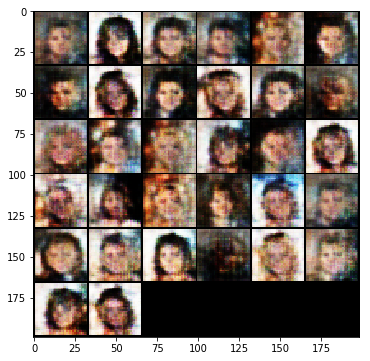

Iteration 10800: dis loss = 1.5215, gen loss = 0.7401, recon loss = 0.7401
Iteration 10850: dis loss = 1.1111, gen loss = 1.0228, recon loss = 1.0228
Iteration 10900: dis loss = 1.1854, gen loss = 0.9964, recon loss = 0.9964
Iteration 10950: dis loss = 1.1817, gen loss = 1.0142, recon loss = 1.0142
Iteration 11000: dis loss = 1.1324, gen loss = 1.2362, recon loss = 1.2362
Iteration 11050: dis loss = 1.1740, gen loss = 0.9011, recon loss = 0.9011
Iteration 11100: dis loss = 1.3721, gen loss = 0.9688, recon loss = 0.9688
Iteration 11150: dis loss = 1.0048, gen loss = 1.0714, recon loss = 1.0714
Iteration 11200: dis loss = 1.2736, gen loss = 0.9217, recon loss = 0.9217
Iteration 11250: dis loss = 0.9410, gen loss = 1.3101, recon loss = 1.3101
1 5000


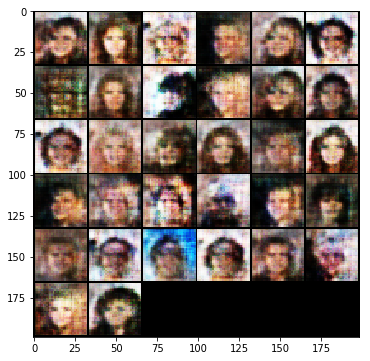

Iteration 11300: dis loss = 1.0573, gen loss = 1.0280, recon loss = 1.0280
Iteration 11350: dis loss = 0.8884, gen loss = 1.1832, recon loss = 1.1832
Iteration 11400: dis loss = 0.9901, gen loss = 1.1561, recon loss = 1.1561
Iteration 11450: dis loss = 1.3512, gen loss = 0.9836, recon loss = 0.9836
Iteration 11500: dis loss = 1.0756, gen loss = 0.8465, recon loss = 0.8465
Iteration 11550: dis loss = 1.2327, gen loss = 0.9592, recon loss = 0.9592
Iteration 11600: dis loss = 1.4582, gen loss = 0.8020, recon loss = 0.8020
Iteration 11650: dis loss = 1.2911, gen loss = 1.0362, recon loss = 1.0362
Iteration 11700: dis loss = 1.4525, gen loss = 0.6934, recon loss = 0.6934
Iteration 11750: dis loss = 1.4330, gen loss = 0.8761, recon loss = 0.8761
1 5500


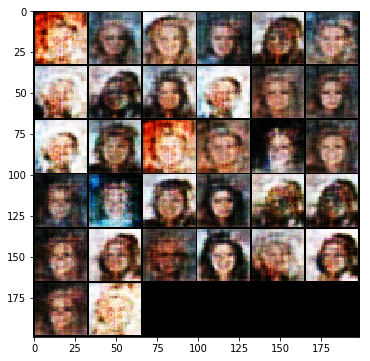

Iteration 11800: dis loss = 1.5751, gen loss = 0.6756, recon loss = 0.6756
Iteration 11850: dis loss = 1.1149, gen loss = 0.9393, recon loss = 0.9393
Iteration 11900: dis loss = 1.2477, gen loss = 0.8437, recon loss = 0.8437
Iteration 11950: dis loss = 1.3851, gen loss = 0.9536, recon loss = 0.9536
Iteration 12000: dis loss = 1.2231, gen loss = 0.7956, recon loss = 0.7956
Iteration 12050: dis loss = 1.2959, gen loss = 0.9727, recon loss = 0.9727
Iteration 12100: dis loss = 1.0566, gen loss = 0.9024, recon loss = 0.9024
Iteration 12150: dis loss = 1.6975, gen loss = 0.7011, recon loss = 0.7011
Iteration 12200: dis loss = 1.4102, gen loss = 0.9444, recon loss = 0.9444
Iteration 12250: dis loss = 0.9839, gen loss = 1.1302, recon loss = 1.1302
1 6000


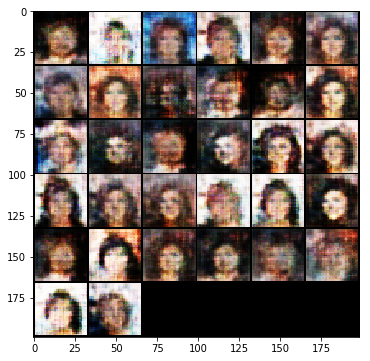

Iteration 12300: dis loss = 1.0576, gen loss = 1.0360, recon loss = 1.0360
Iteration 12350: dis loss = 1.1621, gen loss = 0.9417, recon loss = 0.9417
Iteration 12400: dis loss = 1.1729, gen loss = 0.9415, recon loss = 0.9415
Iteration 12450: dis loss = 0.8613, gen loss = 1.2291, recon loss = 1.2291
Iteration 12500: dis loss = 1.1017, gen loss = 1.3151, recon loss = 1.3151


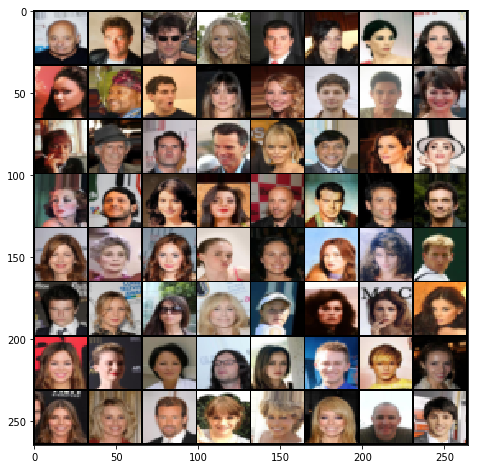

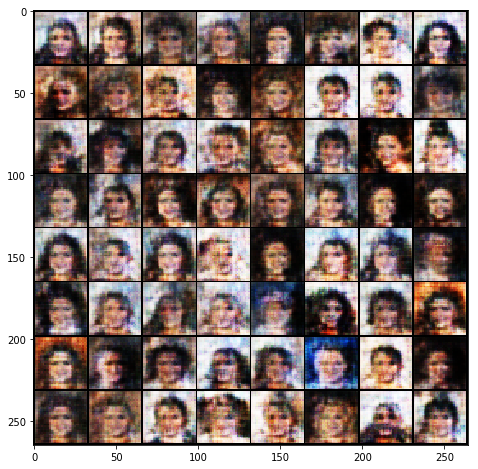

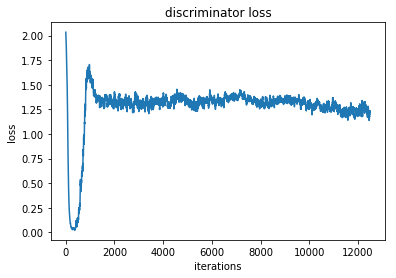

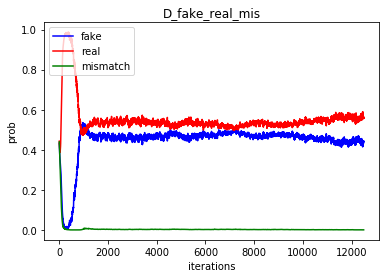

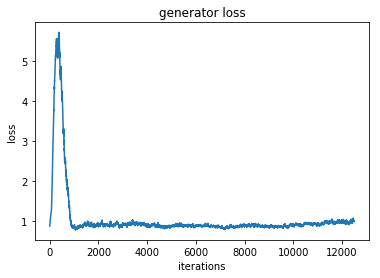

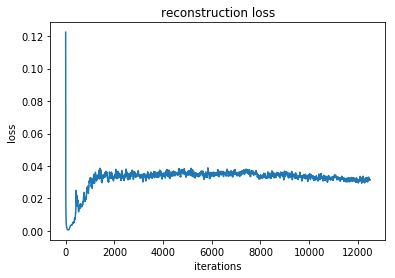

2 0


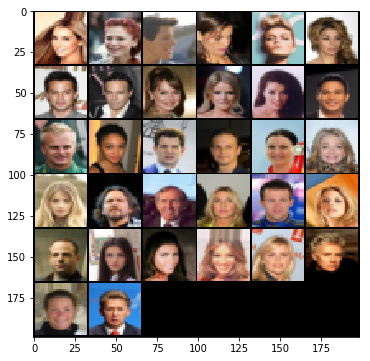

Iteration 12550: dis loss = 1.5401, gen loss = 0.8305, recon loss = 0.8305
Iteration 12600: dis loss = 1.2446, gen loss = 1.0443, recon loss = 1.0443
Iteration 12650: dis loss = 1.2356, gen loss = 0.8480, recon loss = 0.8480
Iteration 12700: dis loss = 0.8060, gen loss = 1.1231, recon loss = 1.1231
Iteration 12750: dis loss = 1.0447, gen loss = 1.1827, recon loss = 1.1827
Iteration 12800: dis loss = 1.5024, gen loss = 1.0625, recon loss = 1.0625
Iteration 12850: dis loss = 1.1346, gen loss = 1.2434, recon loss = 1.2434
Iteration 12900: dis loss = 1.4495, gen loss = 1.1072, recon loss = 1.1072
Iteration 12950: dis loss = 1.1637, gen loss = 1.0242, recon loss = 1.0242
Iteration 13000: dis loss = 1.1085, gen loss = 1.1214, recon loss = 1.1214
2 500


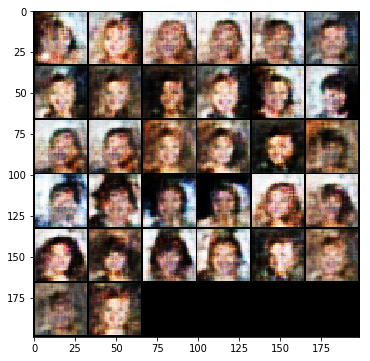

Iteration 13050: dis loss = 1.3498, gen loss = 1.0913, recon loss = 1.0913
Iteration 13100: dis loss = 1.3333, gen loss = 0.8688, recon loss = 0.8688
Iteration 13150: dis loss = 1.0716, gen loss = 1.1992, recon loss = 1.1992
Iteration 13200: dis loss = 1.0793, gen loss = 1.0579, recon loss = 1.0579
Iteration 13250: dis loss = 0.8821, gen loss = 1.1233, recon loss = 1.1233
Iteration 13300: dis loss = 1.3011, gen loss = 0.8667, recon loss = 0.8667
Iteration 13350: dis loss = 1.1991, gen loss = 1.1371, recon loss = 1.1371
Iteration 13400: dis loss = 0.9819, gen loss = 1.0931, recon loss = 1.0931
Iteration 13450: dis loss = 1.0251, gen loss = 1.0684, recon loss = 1.0684
Iteration 13500: dis loss = 1.1548, gen loss = 0.8793, recon loss = 0.8793
2 1000


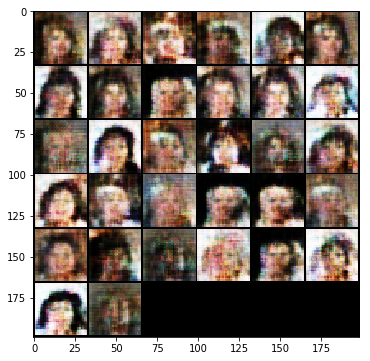

Iteration 13550: dis loss = 1.3422, gen loss = 0.7756, recon loss = 0.7756
Iteration 13600: dis loss = 1.0887, gen loss = 1.0466, recon loss = 1.0466
Iteration 13650: dis loss = 1.4059, gen loss = 1.0513, recon loss = 1.0513
Iteration 13700: dis loss = 1.2682, gen loss = 0.8856, recon loss = 0.8856
Iteration 13750: dis loss = 0.9884, gen loss = 0.9956, recon loss = 0.9956
Iteration 13800: dis loss = 1.6417, gen loss = 1.0079, recon loss = 1.0079
Iteration 13850: dis loss = 0.9942, gen loss = 1.0461, recon loss = 1.0461
Iteration 13900: dis loss = 1.6093, gen loss = 0.6913, recon loss = 0.6913
Iteration 13950: dis loss = 1.0276, gen loss = 0.9373, recon loss = 0.9373
Iteration 14000: dis loss = 1.3445, gen loss = 0.8746, recon loss = 0.8746
2 1500


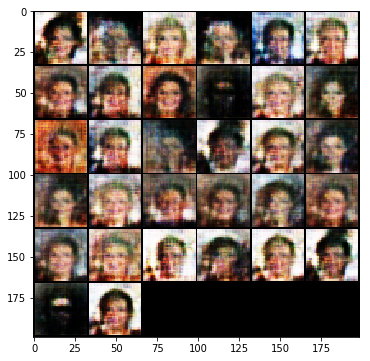

Iteration 14050: dis loss = 1.5563, gen loss = 0.9610, recon loss = 0.9610
Iteration 14100: dis loss = 1.0951, gen loss = 1.1496, recon loss = 1.1496
Iteration 14150: dis loss = 1.2888, gen loss = 0.8619, recon loss = 0.8619
Iteration 14200: dis loss = 1.4124, gen loss = 1.0900, recon loss = 1.0900
Iteration 14250: dis loss = 1.5572, gen loss = 0.7019, recon loss = 0.7019
Iteration 14300: dis loss = 0.8992, gen loss = 1.5037, recon loss = 1.5037
Iteration 14350: dis loss = 1.3469, gen loss = 1.1830, recon loss = 1.1830
Iteration 14400: dis loss = 0.9788, gen loss = 1.2265, recon loss = 1.2265
Iteration 14450: dis loss = 1.6215, gen loss = 0.7476, recon loss = 0.7476
Iteration 14500: dis loss = 1.3865, gen loss = 0.7545, recon loss = 0.7545
2 2000


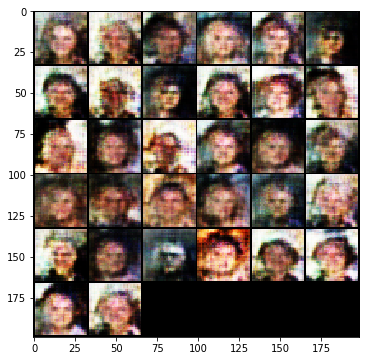

Iteration 14550: dis loss = 1.2102, gen loss = 0.8987, recon loss = 0.8987
Iteration 14600: dis loss = 0.8752, gen loss = 1.1796, recon loss = 1.1796
Iteration 14650: dis loss = 1.5993, gen loss = 0.7177, recon loss = 0.7177
Iteration 14700: dis loss = 1.1132, gen loss = 1.0999, recon loss = 1.0999
Iteration 14750: dis loss = 1.5324, gen loss = 0.9103, recon loss = 0.9103
Iteration 14800: dis loss = 1.5457, gen loss = 1.2733, recon loss = 1.2733
Iteration 14850: dis loss = 1.0589, gen loss = 0.9951, recon loss = 0.9951
Iteration 14900: dis loss = 1.3111, gen loss = 0.9049, recon loss = 0.9049
Iteration 14950: dis loss = 1.2038, gen loss = 1.2980, recon loss = 1.2980
Iteration 15000: dis loss = 1.2127, gen loss = 1.0278, recon loss = 1.0278
2 2500


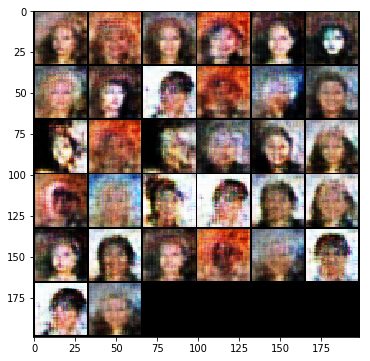

Iteration 15050: dis loss = 1.6035, gen loss = 0.9388, recon loss = 0.9388
Iteration 15100: dis loss = 1.1492, gen loss = 1.1137, recon loss = 1.1137
Iteration 15150: dis loss = 1.1725, gen loss = 0.9842, recon loss = 0.9842
Iteration 15200: dis loss = 0.9518, gen loss = 1.2751, recon loss = 1.2751
Iteration 15250: dis loss = 0.8775, gen loss = 1.1552, recon loss = 1.1552
Iteration 15300: dis loss = 1.3400, gen loss = 1.0934, recon loss = 1.0934
Iteration 15350: dis loss = 1.3857, gen loss = 0.9721, recon loss = 0.9721
Iteration 15400: dis loss = 1.5643, gen loss = 0.5748, recon loss = 0.5748
Iteration 15450: dis loss = 1.2023, gen loss = 1.2669, recon loss = 1.2669
Iteration 15500: dis loss = 0.9111, gen loss = 1.2419, recon loss = 1.2419
2 3000


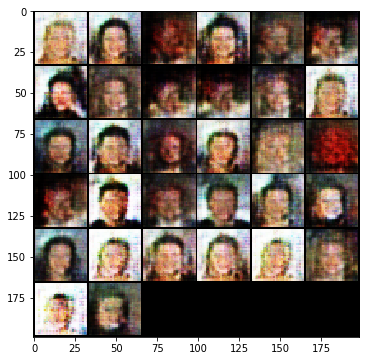

Iteration 15550: dis loss = 1.1984, gen loss = 1.4086, recon loss = 1.4086
Iteration 15600: dis loss = 0.9672, gen loss = 1.0311, recon loss = 1.0311
Iteration 15650: dis loss = 1.5651, gen loss = 0.9674, recon loss = 0.9674
Iteration 15700: dis loss = 1.5642, gen loss = 0.6828, recon loss = 0.6828
Iteration 15750: dis loss = 1.1005, gen loss = 0.8564, recon loss = 0.8564
Iteration 15800: dis loss = 1.5011, gen loss = 0.8050, recon loss = 0.8050
Iteration 15850: dis loss = 1.6223, gen loss = 1.1005, recon loss = 1.1005
Iteration 15900: dis loss = 1.2729, gen loss = 1.1427, recon loss = 1.1427
Iteration 15950: dis loss = 0.9176, gen loss = 1.4401, recon loss = 1.4401
Iteration 16000: dis loss = 0.9714, gen loss = 1.0644, recon loss = 1.0644
2 3500


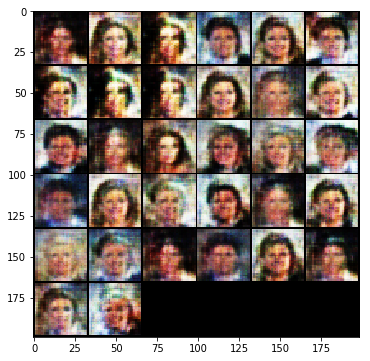

Iteration 16050: dis loss = 1.2013, gen loss = 0.7767, recon loss = 0.7767
Iteration 16100: dis loss = 1.2690, gen loss = 1.1291, recon loss = 1.1291
Iteration 16150: dis loss = 1.4135, gen loss = 0.6849, recon loss = 0.6849
Iteration 16200: dis loss = 1.4492, gen loss = 1.0079, recon loss = 1.0079
Iteration 16250: dis loss = 1.0095, gen loss = 1.0254, recon loss = 1.0254
Iteration 16300: dis loss = 0.9929, gen loss = 1.3782, recon loss = 1.3782
Iteration 16350: dis loss = 1.0407, gen loss = 1.5102, recon loss = 1.5102
Iteration 16400: dis loss = 1.2521, gen loss = 1.3026, recon loss = 1.3026
Iteration 16450: dis loss = 0.9170, gen loss = 1.3101, recon loss = 1.3101
Iteration 16500: dis loss = 1.4354, gen loss = 1.1928, recon loss = 1.1928
2 4000


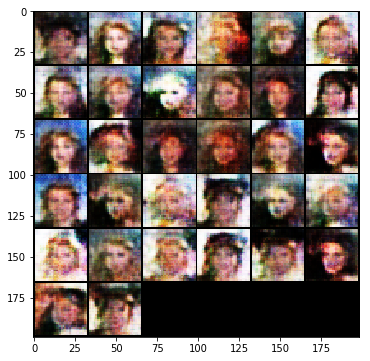

Iteration 16550: dis loss = 1.6812, gen loss = 0.7607, recon loss = 0.7607
Iteration 16600: dis loss = 0.6645, gen loss = 1.5232, recon loss = 1.5232
Iteration 16650: dis loss = 1.1553, gen loss = 0.8801, recon loss = 0.8801
Iteration 16700: dis loss = 1.0454, gen loss = 0.9985, recon loss = 0.9985
Iteration 16750: dis loss = 1.2123, gen loss = 1.5880, recon loss = 1.5880
Iteration 16800: dis loss = 1.1203, gen loss = 1.1133, recon loss = 1.1133
Iteration 16850: dis loss = 0.7292, gen loss = 1.6828, recon loss = 1.6828
Iteration 16900: dis loss = 1.2163, gen loss = 0.8817, recon loss = 0.8817
Iteration 16950: dis loss = 1.1111, gen loss = 1.3867, recon loss = 1.3867
Iteration 17000: dis loss = 1.7186, gen loss = 1.1553, recon loss = 1.1553
2 4500


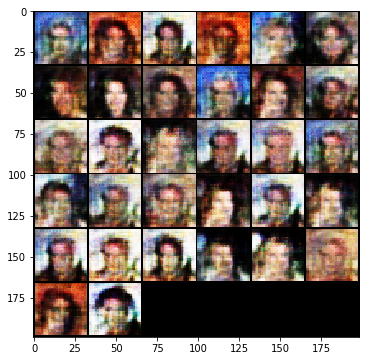

Iteration 17050: dis loss = 1.7472, gen loss = 0.6599, recon loss = 0.6599
Iteration 17100: dis loss = 1.1563, gen loss = 1.2294, recon loss = 1.2294
Iteration 17150: dis loss = 1.2292, gen loss = 0.8928, recon loss = 0.8928
Iteration 17200: dis loss = 0.8558, gen loss = 1.5899, recon loss = 1.5899
Iteration 17250: dis loss = 1.0411, gen loss = 1.6502, recon loss = 1.6502
Iteration 17300: dis loss = 0.8116, gen loss = 1.2324, recon loss = 1.2324
Iteration 17350: dis loss = 0.7778, gen loss = 1.3306, recon loss = 1.3306
Iteration 17400: dis loss = 0.8051, gen loss = 1.5718, recon loss = 1.5718
Iteration 17450: dis loss = 1.0680, gen loss = 1.1467, recon loss = 1.1467
Iteration 17500: dis loss = 1.2673, gen loss = 1.4904, recon loss = 1.4904
2 5000


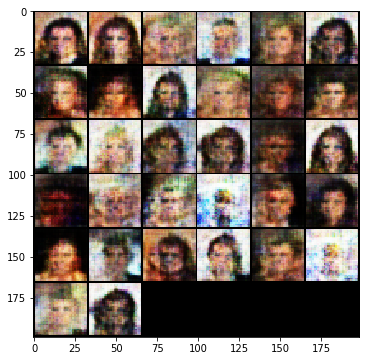

Iteration 17550: dis loss = 1.2623, gen loss = 0.8287, recon loss = 0.8287
Iteration 17600: dis loss = 1.2091, gen loss = 1.1407, recon loss = 1.1407
Iteration 17650: dis loss = 1.3896, gen loss = 1.1455, recon loss = 1.1455
Iteration 17700: dis loss = 1.3290, gen loss = 1.0675, recon loss = 1.0675
Iteration 17750: dis loss = 1.3904, gen loss = 1.2710, recon loss = 1.2710
Iteration 17800: dis loss = 0.9908, gen loss = 1.1633, recon loss = 1.1633
Iteration 17850: dis loss = 1.3584, gen loss = 1.0735, recon loss = 1.0735
Iteration 17900: dis loss = 0.9329, gen loss = 1.5098, recon loss = 1.5098
Iteration 17950: dis loss = 1.0188, gen loss = 1.2060, recon loss = 1.2060
Iteration 18000: dis loss = 1.2987, gen loss = 0.8852, recon loss = 0.8852
2 5500


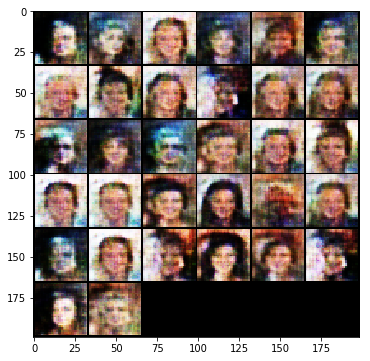

Iteration 18050: dis loss = 1.6086, gen loss = 0.8173, recon loss = 0.8173
Iteration 18100: dis loss = 0.9568, gen loss = 1.2392, recon loss = 1.2392
Iteration 18150: dis loss = 1.2254, gen loss = 0.8945, recon loss = 0.8945
Iteration 18200: dis loss = 1.5654, gen loss = 0.9440, recon loss = 0.9440
Iteration 18250: dis loss = 1.3161, gen loss = 0.8607, recon loss = 0.8607
Iteration 18300: dis loss = 1.3581, gen loss = 1.0365, recon loss = 1.0365
Iteration 18350: dis loss = 1.1603, gen loss = 0.8901, recon loss = 0.8901
Iteration 18400: dis loss = 1.3653, gen loss = 0.8370, recon loss = 0.8370
Iteration 18450: dis loss = 1.3026, gen loss = 1.0192, recon loss = 1.0192
Iteration 18500: dis loss = 0.8874, gen loss = 1.1772, recon loss = 1.1772
2 6000


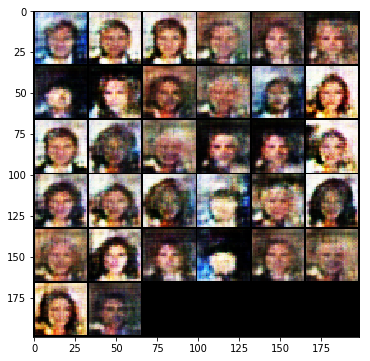

Iteration 18550: dis loss = 1.0943, gen loss = 1.4006, recon loss = 1.4006
Iteration 18600: dis loss = 1.0508, gen loss = 0.9418, recon loss = 0.9418
Iteration 18650: dis loss = 0.9908, gen loss = 1.2127, recon loss = 1.2127
Iteration 18700: dis loss = 0.9004, gen loss = 1.2513, recon loss = 1.2513
Iteration 18750: dis loss = 0.9797, gen loss = 1.8947, recon loss = 1.8947


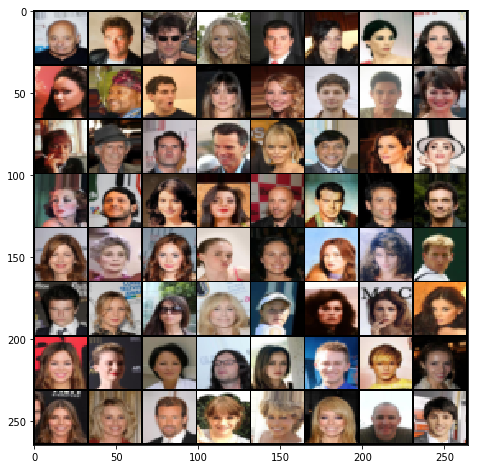

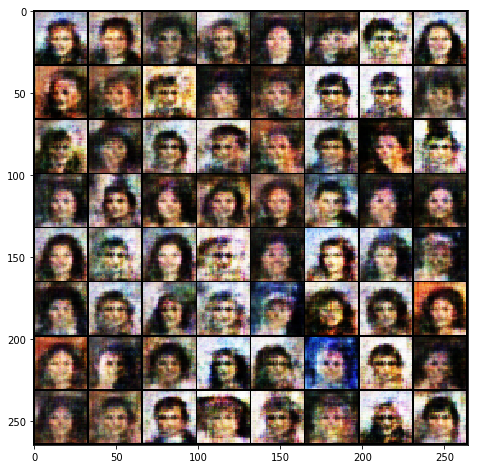

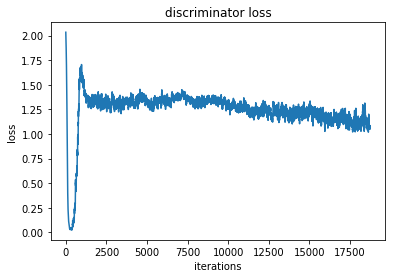

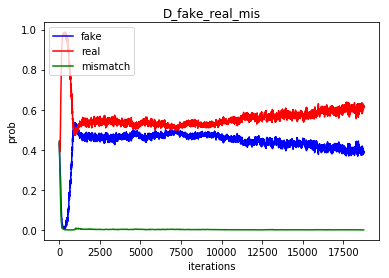

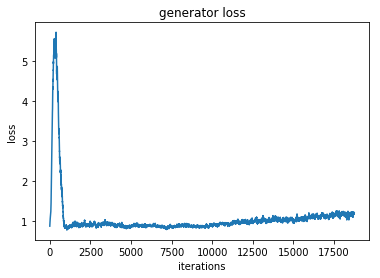

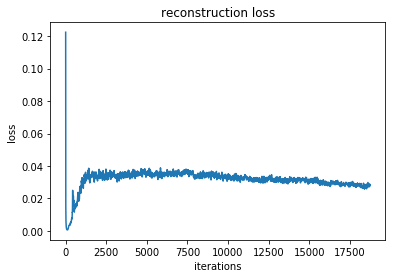

3 0


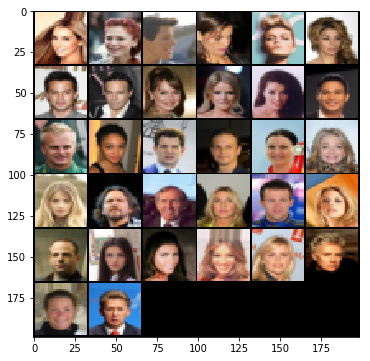

Iteration 18800: dis loss = 1.4415, gen loss = 1.0693, recon loss = 1.0693
Iteration 18850: dis loss = 1.2249, gen loss = 1.3465, recon loss = 1.3465
Iteration 18900: dis loss = 1.2642, gen loss = 1.0789, recon loss = 1.0789
Iteration 18950: dis loss = 0.5249, gen loss = 1.6808, recon loss = 1.6808
Iteration 19000: dis loss = 0.7589, gen loss = 1.4137, recon loss = 1.4137
Iteration 19050: dis loss = 1.3201, gen loss = 1.3195, recon loss = 1.3195
Iteration 19100: dis loss = 1.0040, gen loss = 1.1497, recon loss = 1.1497
Iteration 19150: dis loss = 1.3552, gen loss = 1.1125, recon loss = 1.1125
Iteration 19200: dis loss = 1.1090, gen loss = 1.3140, recon loss = 1.3140
Iteration 19250: dis loss = 0.8241, gen loss = 1.4482, recon loss = 1.4482
3 500


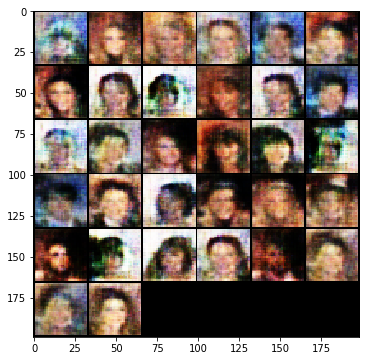

Iteration 19300: dis loss = 1.2616, gen loss = 1.1367, recon loss = 1.1367
Iteration 19350: dis loss = 1.1259, gen loss = 0.9871, recon loss = 0.9871
Iteration 19400: dis loss = 0.8820, gen loss = 1.5110, recon loss = 1.5110
Iteration 19450: dis loss = 1.0015, gen loss = 1.2200, recon loss = 1.2200
Iteration 19500: dis loss = 1.0501, gen loss = 1.2558, recon loss = 1.2558
Iteration 19550: dis loss = 1.0947, gen loss = 1.0302, recon loss = 1.0302
Iteration 19600: dis loss = 1.1386, gen loss = 0.9894, recon loss = 0.9894
Iteration 19650: dis loss = 0.6203, gen loss = 1.4747, recon loss = 1.4747
Iteration 19700: dis loss = 0.6168, gen loss = 1.5300, recon loss = 1.5300
Iteration 19750: dis loss = 1.0271, gen loss = 0.9246, recon loss = 0.9246
3 1000


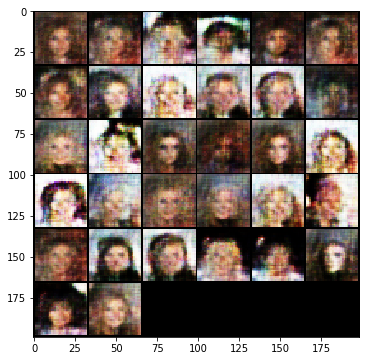

Iteration 19800: dis loss = 0.9894, gen loss = 1.0086, recon loss = 1.0086
Iteration 19850: dis loss = 1.0011, gen loss = 1.0031, recon loss = 1.0031
Iteration 19900: dis loss = 1.0833, gen loss = 1.1371, recon loss = 1.1371
Iteration 19950: dis loss = 1.1699, gen loss = 1.1378, recon loss = 1.1378
Iteration 20000: dis loss = 0.9864, gen loss = 1.2834, recon loss = 1.2834
Iteration 20050: dis loss = 1.3838, gen loss = 1.2884, recon loss = 1.2884
Iteration 20100: dis loss = 0.6638, gen loss = 1.4096, recon loss = 1.4096
Iteration 20150: dis loss = 1.5974, gen loss = 0.8579, recon loss = 0.8579
Iteration 20200: dis loss = 0.7655, gen loss = 1.3329, recon loss = 1.3329
Iteration 20250: dis loss = 1.3435, gen loss = 0.9231, recon loss = 0.9231
3 1500


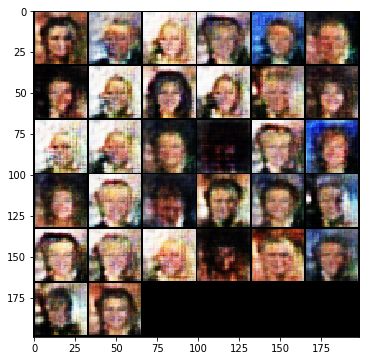

Iteration 20300: dis loss = 1.2630, gen loss = 1.3912, recon loss = 1.3912
Iteration 20350: dis loss = 0.7634, gen loss = 1.3271, recon loss = 1.3271
Iteration 20400: dis loss = 1.1872, gen loss = 1.0785, recon loss = 1.0785
Iteration 20450: dis loss = 1.1410, gen loss = 1.2243, recon loss = 1.2243
Iteration 20500: dis loss = 1.4842, gen loss = 0.7280, recon loss = 0.7280
Iteration 20550: dis loss = 0.8306, gen loss = 1.9406, recon loss = 1.9406
Iteration 20600: dis loss = 1.3856, gen loss = 1.3971, recon loss = 1.3971
Iteration 20650: dis loss = 1.1204, gen loss = 1.3698, recon loss = 1.3698
Iteration 20700: dis loss = 1.6729, gen loss = 0.6255, recon loss = 0.6255
Iteration 20750: dis loss = 1.0610, gen loss = 1.0884, recon loss = 1.0884
3 2000


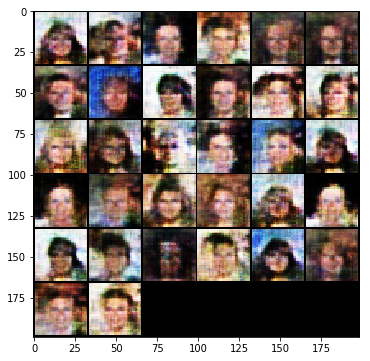

Iteration 20800: dis loss = 1.3508, gen loss = 1.4142, recon loss = 1.4142
Iteration 20850: dis loss = 0.9702, gen loss = 1.7271, recon loss = 1.7271
Iteration 20900: dis loss = 1.9217, gen loss = 0.6213, recon loss = 0.6213
Iteration 20950: dis loss = 1.0158, gen loss = 1.5785, recon loss = 1.5785
Iteration 21000: dis loss = 1.1367, gen loss = 1.2611, recon loss = 1.2611
Iteration 21050: dis loss = 0.5523, gen loss = 2.1060, recon loss = 2.1060
Iteration 21100: dis loss = 0.6023, gen loss = 1.5046, recon loss = 1.5046
Iteration 21150: dis loss = 1.2809, gen loss = 0.8795, recon loss = 0.8795
Iteration 21200: dis loss = 1.4843, gen loss = 1.3070, recon loss = 1.3070
Iteration 21250: dis loss = 0.9910, gen loss = 1.3268, recon loss = 1.3268
3 2500


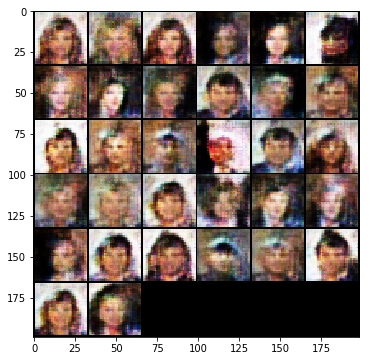

Iteration 21300: dis loss = 1.5258, gen loss = 1.1454, recon loss = 1.1454
Iteration 21350: dis loss = 0.8938, gen loss = 1.1967, recon loss = 1.1967
Iteration 21400: dis loss = 0.9977, gen loss = 1.5932, recon loss = 1.5932
Iteration 21450: dis loss = 0.7361, gen loss = 1.6565, recon loss = 1.6565
Iteration 21500: dis loss = 0.6552, gen loss = 1.4406, recon loss = 1.4406
Iteration 21550: dis loss = 1.1127, gen loss = 1.3632, recon loss = 1.3632
Iteration 21600: dis loss = 0.9590, gen loss = 1.4108, recon loss = 1.4108
Iteration 21650: dis loss = 1.6722, gen loss = 0.7340, recon loss = 0.7340
Iteration 21700: dis loss = 0.8244, gen loss = 1.6593, recon loss = 1.6593
Iteration 21750: dis loss = 0.6589, gen loss = 1.6811, recon loss = 1.6811
3 3000


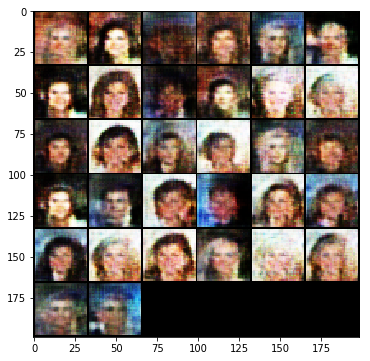

Iteration 21800: dis loss = 0.4218, gen loss = 1.9252, recon loss = 1.9252
Iteration 21850: dis loss = 0.6781, gen loss = 1.4496, recon loss = 1.4496
Iteration 21900: dis loss = 1.0661, gen loss = 1.1332, recon loss = 1.1332
Iteration 21950: dis loss = 1.5896, gen loss = 0.7396, recon loss = 0.7396
Iteration 22000: dis loss = 0.9353, gen loss = 1.0254, recon loss = 1.0254
Iteration 22050: dis loss = 0.9705, gen loss = 1.1140, recon loss = 1.1140
Iteration 22100: dis loss = 1.0310, gen loss = 1.5902, recon loss = 1.5902
Iteration 22150: dis loss = 1.0788, gen loss = 0.9468, recon loss = 0.9468
Iteration 22200: dis loss = 0.6622, gen loss = 1.4839, recon loss = 1.4839
Iteration 22250: dis loss = 0.8873, gen loss = 1.1231, recon loss = 1.1231
3 3500


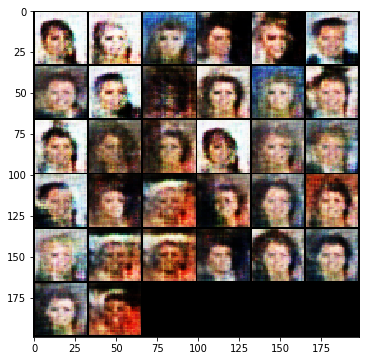

Iteration 22300: dis loss = 1.0716, gen loss = 0.9596, recon loss = 0.9596
Iteration 22350: dis loss = 0.8426, gen loss = 1.5157, recon loss = 1.5157
Iteration 22400: dis loss = 1.6542, gen loss = 0.9743, recon loss = 0.9743
Iteration 22450: dis loss = 1.3613, gen loss = 1.4037, recon loss = 1.4037
Iteration 22500: dis loss = 0.7499, gen loss = 1.2933, recon loss = 1.2933
Iteration 22550: dis loss = 0.9461, gen loss = 1.7210, recon loss = 1.7210
Iteration 22600: dis loss = 0.7627, gen loss = 1.9222, recon loss = 1.9222
Iteration 22650: dis loss = 0.9046, gen loss = 1.5071, recon loss = 1.5071
Iteration 22700: dis loss = 0.6451, gen loss = 1.6322, recon loss = 1.6322
Iteration 22750: dis loss = 0.8934, gen loss = 1.0161, recon loss = 1.0161
3 4000


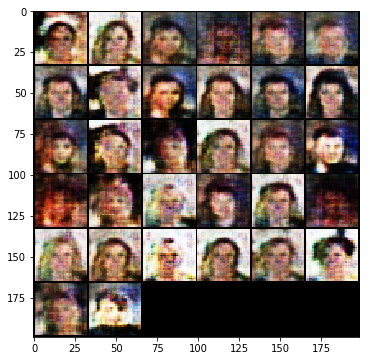

Iteration 22800: dis loss = 1.4762, gen loss = 0.7642, recon loss = 0.7642
Iteration 22850: dis loss = 0.7030, gen loss = 1.4735, recon loss = 1.4735
Iteration 22900: dis loss = 0.7504, gen loss = 1.1970, recon loss = 1.1970
Iteration 22950: dis loss = 1.0712, gen loss = 1.1887, recon loss = 1.1887
Iteration 23000: dis loss = 0.7116, gen loss = 1.5934, recon loss = 1.5934
Iteration 23050: dis loss = 0.7669, gen loss = 1.5889, recon loss = 1.5889
Iteration 23100: dis loss = 0.6969, gen loss = 1.9401, recon loss = 1.9401
Iteration 23150: dis loss = 1.0567, gen loss = 1.3674, recon loss = 1.3674
Iteration 23200: dis loss = 1.4953, gen loss = 1.7526, recon loss = 1.7526
Iteration 23250: dis loss = 1.4759, gen loss = 0.8396, recon loss = 0.8396
3 4500


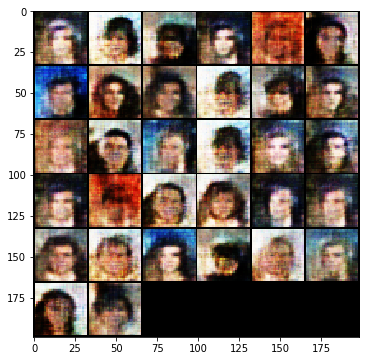

Iteration 23300: dis loss = 1.5035, gen loss = 0.6246, recon loss = 0.6246
Iteration 23350: dis loss = 0.7446, gen loss = 1.6028, recon loss = 1.6028
Iteration 23400: dis loss = 0.9665, gen loss = 1.0575, recon loss = 1.0575
Iteration 23450: dis loss = 1.1750, gen loss = 1.6294, recon loss = 1.6294
Iteration 23500: dis loss = 0.6126, gen loss = 1.7988, recon loss = 1.7988
Iteration 23550: dis loss = 0.6716, gen loss = 1.4560, recon loss = 1.4560
Iteration 23600: dis loss = 0.6939, gen loss = 1.7624, recon loss = 1.7624
Iteration 23650: dis loss = 0.4318, gen loss = 2.1395, recon loss = 2.1395
Iteration 23700: dis loss = 0.8371, gen loss = 1.2401, recon loss = 1.2401
Iteration 23750: dis loss = 1.0813, gen loss = 1.1998, recon loss = 1.1998
3 5000


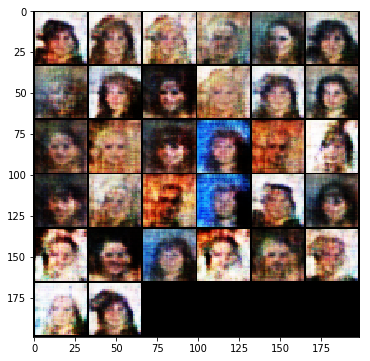

Iteration 23800: dis loss = 0.8825, gen loss = 1.2089, recon loss = 1.2089
Iteration 23850: dis loss = 1.0524, gen loss = 1.3309, recon loss = 1.3309
Iteration 23900: dis loss = 1.2372, gen loss = 1.4177, recon loss = 1.4177
Iteration 23950: dis loss = 1.1980, gen loss = 0.9022, recon loss = 0.9022
Iteration 24000: dis loss = 1.0431, gen loss = 1.3035, recon loss = 1.3035
Iteration 24050: dis loss = 0.7382, gen loss = 1.4136, recon loss = 1.4136
Iteration 24100: dis loss = 1.7629, gen loss = 1.1112, recon loss = 1.1112
Iteration 24150: dis loss = 1.0601, gen loss = 1.7726, recon loss = 1.7726
Iteration 24200: dis loss = 0.9829, gen loss = 1.1119, recon loss = 1.1119
Iteration 24250: dis loss = 0.8344, gen loss = 1.2710, recon loss = 1.2710
3 5500


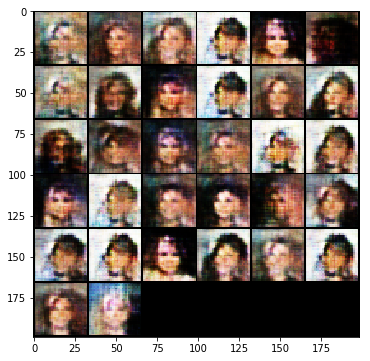

Iteration 24300: dis loss = 1.3561, gen loss = 0.9184, recon loss = 0.9184
Iteration 24350: dis loss = 0.5342, gen loss = 1.7373, recon loss = 1.7373
Iteration 24400: dis loss = 0.7654, gen loss = 1.4207, recon loss = 1.4207
Iteration 24450: dis loss = 1.3066, gen loss = 0.9476, recon loss = 0.9476
Iteration 24500: dis loss = 1.3982, gen loss = 1.0653, recon loss = 1.0653
Iteration 24550: dis loss = 0.9818, gen loss = 1.0358, recon loss = 1.0358
Iteration 24600: dis loss = 0.7225, gen loss = 1.5403, recon loss = 1.5403
Iteration 24650: dis loss = 1.4708, gen loss = 0.8949, recon loss = 0.8949
Iteration 24700: dis loss = 0.8572, gen loss = 1.5670, recon loss = 1.5670
Iteration 24750: dis loss = 0.6070, gen loss = 1.6181, recon loss = 1.6181
3 6000


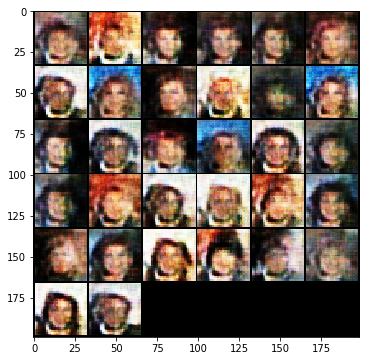

Iteration 24800: dis loss = 0.8442, gen loss = 1.7139, recon loss = 1.7139
Iteration 24850: dis loss = 0.9368, gen loss = 1.1605, recon loss = 1.1605
Iteration 24900: dis loss = 0.9069, gen loss = 1.8519, recon loss = 1.8519
Iteration 24950: dis loss = 0.7344, gen loss = 1.5299, recon loss = 1.5299
Iteration 25000: dis loss = 0.9454, gen loss = 2.4274, recon loss = 2.4274


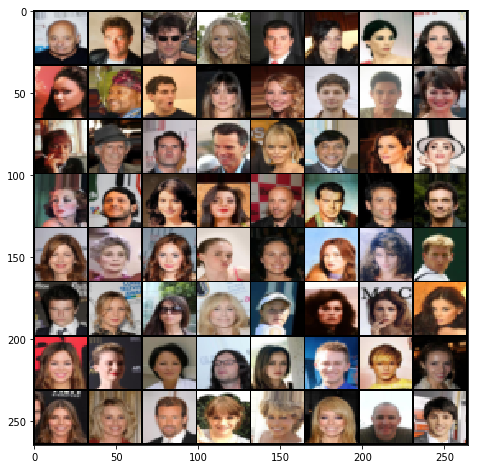

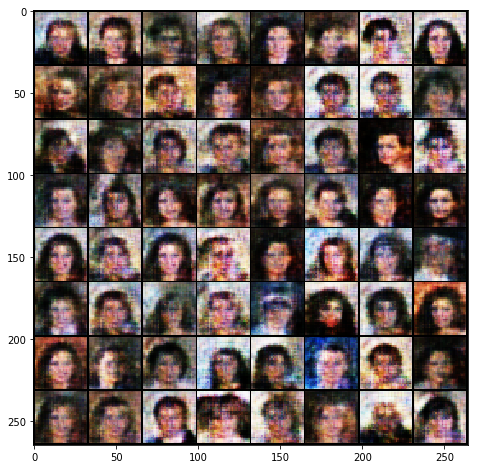

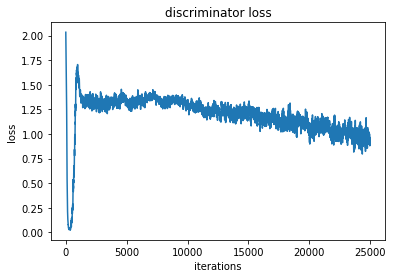

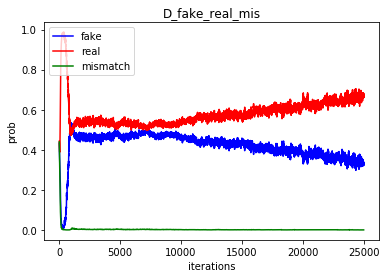

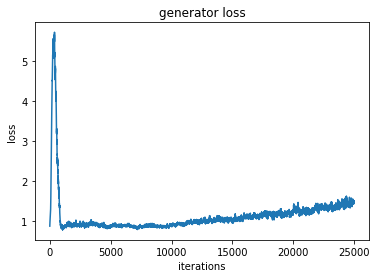

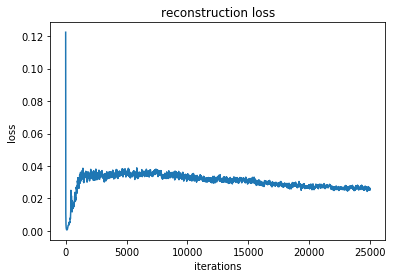

4 0


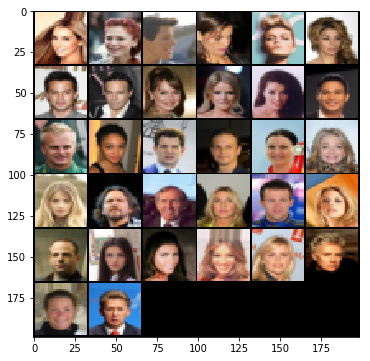

Iteration 25050: dis loss = 1.3398, gen loss = 1.4699, recon loss = 1.4699
Iteration 25100: dis loss = 1.4673, gen loss = 1.7073, recon loss = 1.7073
Iteration 25150: dis loss = 1.0181, gen loss = 1.5325, recon loss = 1.5325
Iteration 25200: dis loss = 0.3307, gen loss = 2.1816, recon loss = 2.1816
Iteration 25250: dis loss = 0.5279, gen loss = 2.2797, recon loss = 2.2797
Iteration 25300: dis loss = 1.7826, gen loss = 1.3230, recon loss = 1.3230
Iteration 25350: dis loss = 1.1933, gen loss = 1.1953, recon loss = 1.1953
Iteration 25400: dis loss = 1.3567, gen loss = 1.7626, recon loss = 1.7626
Iteration 25450: dis loss = 0.7889, gen loss = 1.4943, recon loss = 1.4943
Iteration 25500: dis loss = 0.8669, gen loss = 2.2231, recon loss = 2.2231
4 500


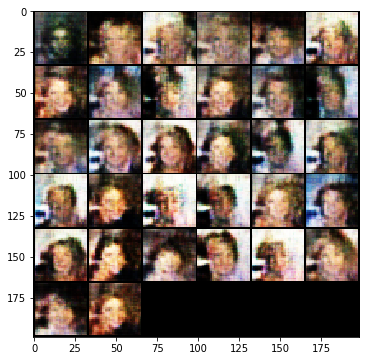

Iteration 25550: dis loss = 1.1381, gen loss = 1.1519, recon loss = 1.1519
Iteration 25600: dis loss = 1.3063, gen loss = 0.9744, recon loss = 0.9744
Iteration 25650: dis loss = 1.3051, gen loss = 1.6738, recon loss = 1.6738
Iteration 25700: dis loss = 0.7004, gen loss = 1.4702, recon loss = 1.4702
Iteration 25750: dis loss = 0.8639, gen loss = 1.6915, recon loss = 1.6915
Iteration 25800: dis loss = 0.4957, gen loss = 1.7334, recon loss = 1.7334
Iteration 25850: dis loss = 0.9896, gen loss = 1.0241, recon loss = 1.0241
Iteration 25900: dis loss = 0.8009, gen loss = 1.3074, recon loss = 1.3074
Iteration 25950: dis loss = 0.8111, gen loss = 1.3747, recon loss = 1.3747
Iteration 26000: dis loss = 0.9772, gen loss = 1.0455, recon loss = 1.0455
4 1000


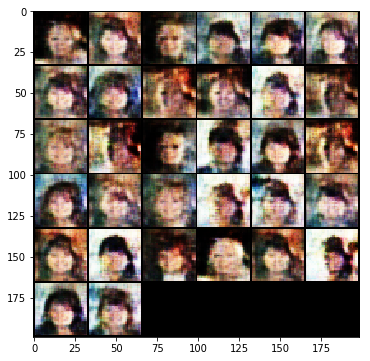

Iteration 26050: dis loss = 0.9995, gen loss = 1.9556, recon loss = 1.9556
Iteration 26100: dis loss = 0.7866, gen loss = 1.5536, recon loss = 1.5536
Iteration 26150: dis loss = 1.0514, gen loss = 1.2804, recon loss = 1.2804
Iteration 26200: dis loss = 0.9344, gen loss = 1.4554, recon loss = 1.4554
Iteration 26250: dis loss = 0.8070, gen loss = 1.1634, recon loss = 1.1634
Iteration 26300: dis loss = 0.4178, gen loss = 1.8772, recon loss = 1.8772
Iteration 26350: dis loss = 0.7001, gen loss = 1.5752, recon loss = 1.5752
Iteration 26400: dis loss = 1.4794, gen loss = 0.8371, recon loss = 0.8371
Iteration 26450: dis loss = 1.1668, gen loss = 1.3678, recon loss = 1.3678
Iteration 26500: dis loss = 0.9424, gen loss = 1.1019, recon loss = 1.1019
4 1500


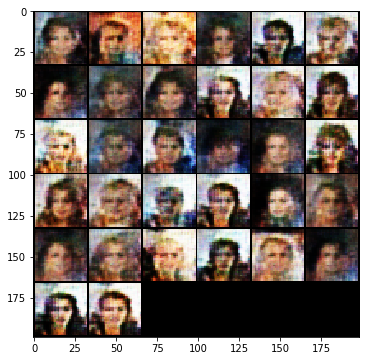

Iteration 26550: dis loss = 1.4880, gen loss = 1.3430, recon loss = 1.3430
Iteration 26600: dis loss = 0.5817, gen loss = 1.6672, recon loss = 1.6672
Iteration 26650: dis loss = 0.7515, gen loss = 1.5279, recon loss = 1.5279
Iteration 26700: dis loss = 0.7028, gen loss = 1.9734, recon loss = 1.9734
Iteration 26750: dis loss = 1.0658, gen loss = 1.0656, recon loss = 1.0656
Iteration 26800: dis loss = 0.6577, gen loss = 1.9499, recon loss = 1.9499
Iteration 26850: dis loss = 0.9464, gen loss = 1.7758, recon loss = 1.7758
Iteration 26900: dis loss = 0.6076, gen loss = 1.7432, recon loss = 1.7432
Iteration 26950: dis loss = 1.2937, gen loss = 0.8066, recon loss = 0.8066
Iteration 27000: dis loss = 1.0195, gen loss = 1.2525, recon loss = 1.2525
4 2000


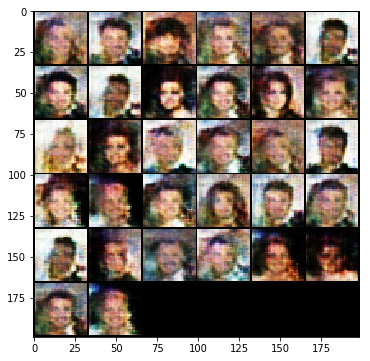

Iteration 27050: dis loss = 0.7557, gen loss = 1.3812, recon loss = 1.3812
Iteration 27100: dis loss = 0.5085, gen loss = 1.7807, recon loss = 1.7807
Iteration 27150: dis loss = 1.4406, gen loss = 0.7952, recon loss = 0.7952
Iteration 27200: dis loss = 0.6390, gen loss = 1.7205, recon loss = 1.7205
Iteration 27250: dis loss = 0.9228, gen loss = 1.1997, recon loss = 1.1997
Iteration 27300: dis loss = 0.8386, gen loss = 1.8964, recon loss = 1.8964
Iteration 27350: dis loss = 0.4177, gen loss = 2.2003, recon loss = 2.2003
Iteration 27400: dis loss = 1.4410, gen loss = 1.3258, recon loss = 1.3258
Iteration 27450: dis loss = 0.8571, gen loss = 1.9859, recon loss = 1.9859
Iteration 27500: dis loss = 0.8730, gen loss = 2.1110, recon loss = 2.1110
4 2500


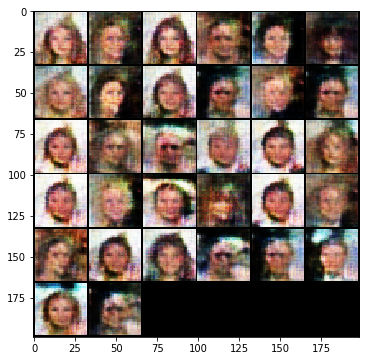

Iteration 27550: dis loss = 1.3476, gen loss = 1.8312, recon loss = 1.8312
Iteration 27600: dis loss = 0.6945, gen loss = 1.6575, recon loss = 1.6575
Iteration 27650: dis loss = 1.1894, gen loss = 1.6029, recon loss = 1.6029
Iteration 27700: dis loss = 0.5064, gen loss = 1.9636, recon loss = 1.9636
Iteration 27750: dis loss = 0.3865, gen loss = 2.0537, recon loss = 2.0537
Iteration 27800: dis loss = 0.5779, gen loss = 1.8874, recon loss = 1.8874
Iteration 27850: dis loss = 0.8545, gen loss = 1.5621, recon loss = 1.5621
Iteration 27900: dis loss = 1.9578, gen loss = 0.4376, recon loss = 0.4376
Iteration 27950: dis loss = 0.9543, gen loss = 1.9541, recon loss = 1.9541
Iteration 28000: dis loss = 0.6425, gen loss = 1.8314, recon loss = 1.8314
4 3000


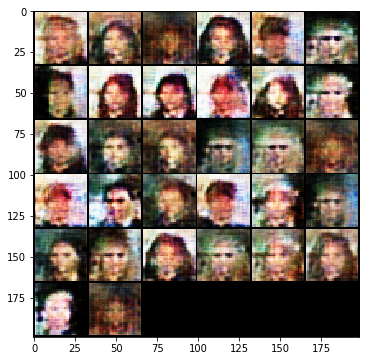

Iteration 28050: dis loss = 0.4126, gen loss = 2.1024, recon loss = 2.1024
Iteration 28100: dis loss = 0.7745, gen loss = 1.3587, recon loss = 1.3587
Iteration 28150: dis loss = 2.0493, gen loss = 1.6021, recon loss = 1.6021
Iteration 28200: dis loss = 1.8198, gen loss = 0.7158, recon loss = 0.7158
Iteration 28250: dis loss = 0.4866, gen loss = 3.1452, recon loss = 3.1452
Iteration 28300: dis loss = 1.2961, gen loss = 0.8369, recon loss = 0.8369
Iteration 28350: dis loss = 0.7172, gen loss = 1.7293, recon loss = 1.7293
Iteration 28400: dis loss = 1.0328, gen loss = 0.9903, recon loss = 0.9903
Iteration 28450: dis loss = 0.9943, gen loss = 1.0828, recon loss = 1.0828
Iteration 28500: dis loss = 0.8596, gen loss = 1.0619, recon loss = 1.0619
4 3500


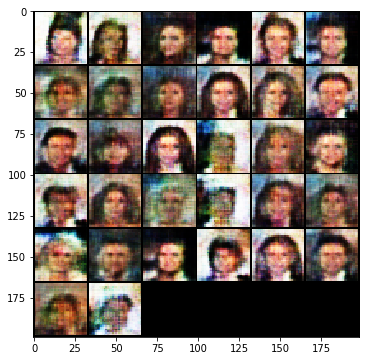

Iteration 28550: dis loss = 1.3376, gen loss = 0.7801, recon loss = 0.7801
Iteration 28600: dis loss = 1.1230, gen loss = 1.4949, recon loss = 1.4949
Iteration 28650: dis loss = 1.6450, gen loss = 0.6553, recon loss = 0.6553
Iteration 28700: dis loss = 0.9476, gen loss = 1.8072, recon loss = 1.8072
Iteration 28750: dis loss = 0.7574, gen loss = 1.3258, recon loss = 1.3258
Iteration 28800: dis loss = 0.6395, gen loss = 2.3201, recon loss = 2.3201
Iteration 28850: dis loss = 0.4430, gen loss = 1.8323, recon loss = 1.8323
Iteration 28900: dis loss = 0.8353, gen loss = 1.6893, recon loss = 1.6893
Iteration 28950: dis loss = 0.3984, gen loss = 2.1148, recon loss = 2.1148
Iteration 29000: dis loss = 0.4481, gen loss = 1.8730, recon loss = 1.8730
4 4000


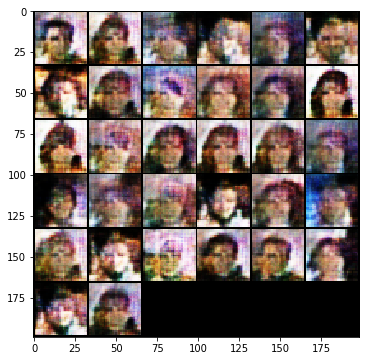

Iteration 29050: dis loss = 1.4198, gen loss = 1.1964, recon loss = 1.1964
Iteration 29100: dis loss = 0.4070, gen loss = 2.0475, recon loss = 2.0475
Iteration 29150: dis loss = 1.0148, gen loss = 0.9107, recon loss = 0.9107
Iteration 29200: dis loss = 0.6858, gen loss = 1.4548, recon loss = 1.4548
Iteration 29250: dis loss = 1.0098, gen loss = 1.7754, recon loss = 1.7754
Iteration 29300: dis loss = 0.6276, gen loss = 1.8221, recon loss = 1.8221
Iteration 29350: dis loss = 0.3323, gen loss = 2.1066, recon loss = 2.1066
Iteration 29400: dis loss = 0.9204, gen loss = 1.3039, recon loss = 1.3039
Iteration 29450: dis loss = 1.2581, gen loss = 2.0053, recon loss = 2.0053
Iteration 29500: dis loss = 1.0694, gen loss = 1.1201, recon loss = 1.1201
4 4500


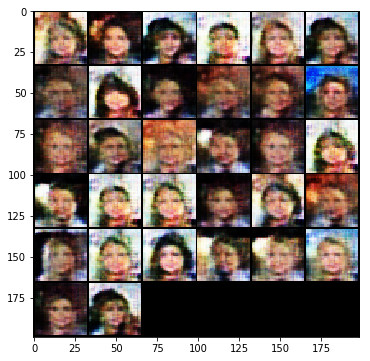

Iteration 29550: dis loss = 2.0287, gen loss = 0.5804, recon loss = 0.5804
Iteration 29600: dis loss = 1.0604, gen loss = 2.1861, recon loss = 2.1861
Iteration 29650: dis loss = 0.6853, gen loss = 1.3451, recon loss = 1.3451
Iteration 29700: dis loss = 0.6245, gen loss = 2.0642, recon loss = 2.0642
Iteration 29750: dis loss = 0.3710, gen loss = 2.1335, recon loss = 2.1335
Iteration 29800: dis loss = 0.4797, gen loss = 2.0210, recon loss = 2.0210
Iteration 29850: dis loss = 0.5029, gen loss = 1.8308, recon loss = 1.8308
Iteration 29900: dis loss = 0.5030, gen loss = 1.8320, recon loss = 1.8320
Iteration 29950: dis loss = 0.9299, gen loss = 1.2599, recon loss = 1.2599
Iteration 30000: dis loss = 1.3902, gen loss = 1.6489, recon loss = 1.6489
4 5000


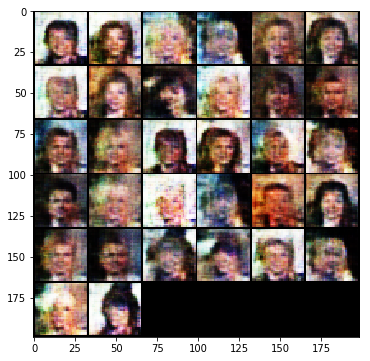

Iteration 30050: dis loss = 0.9433, gen loss = 1.1425, recon loss = 1.1425
Iteration 30100: dis loss = 0.4982, gen loss = 1.8374, recon loss = 1.8374
Iteration 30150: dis loss = 1.0711, gen loss = 1.3440, recon loss = 1.3440
Iteration 30200: dis loss = 1.1167, gen loss = 1.4458, recon loss = 1.4458
Iteration 30250: dis loss = 0.7167, gen loss = 1.5190, recon loss = 1.5190
Iteration 30300: dis loss = 0.8815, gen loss = 1.5803, recon loss = 1.5803
Iteration 30350: dis loss = 1.2145, gen loss = 1.6538, recon loss = 1.6538
Iteration 30400: dis loss = 1.5639, gen loss = 1.7122, recon loss = 1.7122
Iteration 30450: dis loss = 0.6721, gen loss = 1.4805, recon loss = 1.4805
Iteration 30500: dis loss = 1.0799, gen loss = 1.2496, recon loss = 1.2496
4 5500


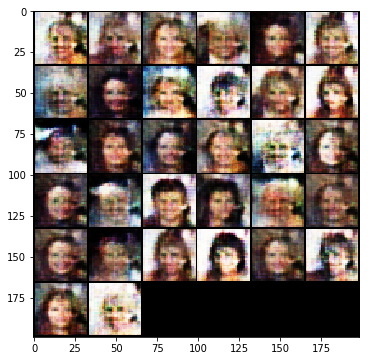

Iteration 30550: dis loss = 1.3484, gen loss = 1.1420, recon loss = 1.1420
Iteration 30600: dis loss = 0.5658, gen loss = 1.8366, recon loss = 1.8366
Iteration 30650: dis loss = 0.8901, gen loss = 1.2744, recon loss = 1.2744
Iteration 30700: dis loss = 1.6182, gen loss = 1.3593, recon loss = 1.3593
Iteration 30750: dis loss = 0.7986, gen loss = 1.3233, recon loss = 1.3233
Iteration 30800: dis loss = 1.1466, gen loss = 1.1541, recon loss = 1.1541
Iteration 30850: dis loss = 0.8987, gen loss = 1.3469, recon loss = 1.3469
Iteration 30900: dis loss = 1.4046, gen loss = 1.1023, recon loss = 1.1023
Iteration 30950: dis loss = 0.8586, gen loss = 1.7215, recon loss = 1.7215
Iteration 31000: dis loss = 0.5723, gen loss = 1.6792, recon loss = 1.6792
4 6000


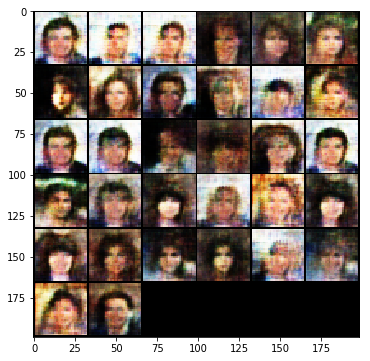

Iteration 31050: dis loss = 0.8065, gen loss = 2.2011, recon loss = 2.2011
Iteration 31100: dis loss = 0.8536, gen loss = 1.1659, recon loss = 1.1659
Iteration 31150: dis loss = 0.6110, gen loss = 1.7601, recon loss = 1.7601
Iteration 31200: dis loss = 0.8951, gen loss = 1.2283, recon loss = 1.2283
Iteration 31250: dis loss = 0.6926, gen loss = 1.6558, recon loss = 1.6558


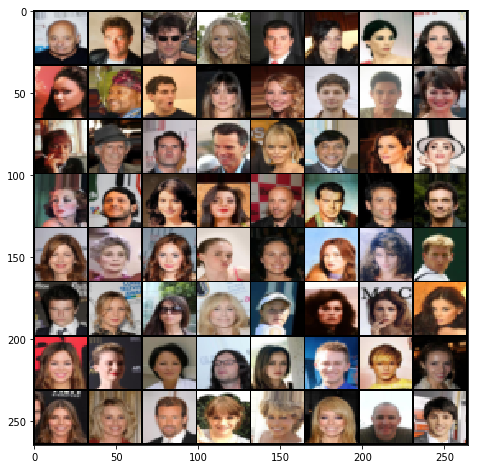

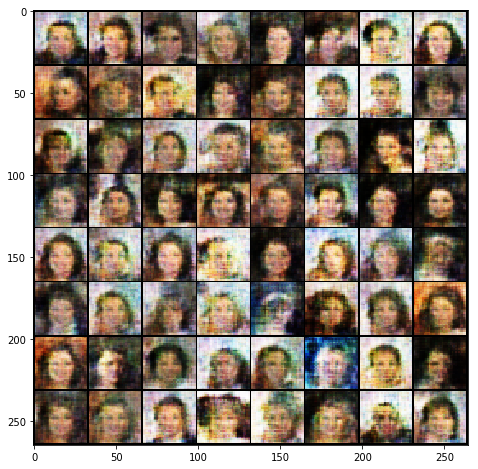

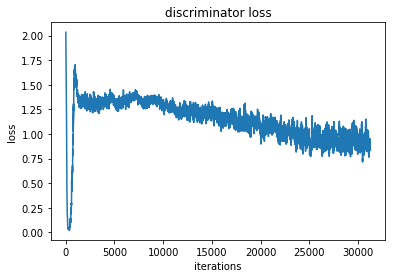

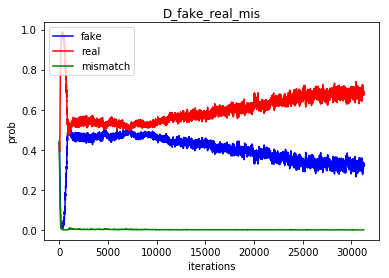

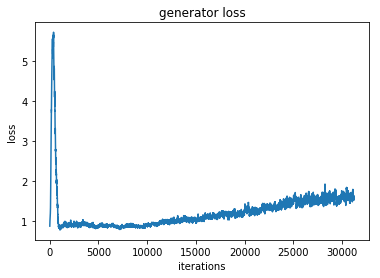

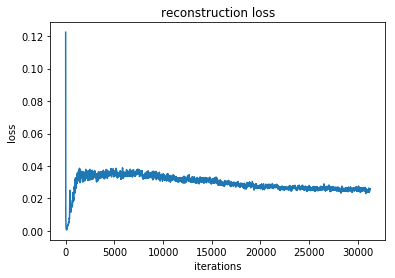

5 0


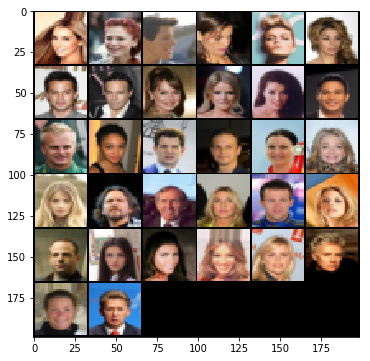

Iteration 31300: dis loss = 1.1999, gen loss = 0.9265, recon loss = 0.9265
Iteration 31350: dis loss = 1.0555, gen loss = 1.9034, recon loss = 1.9034
Iteration 31400: dis loss = 0.4141, gen loss = 1.9828, recon loss = 1.9828
Iteration 31450: dis loss = 0.3252, gen loss = 2.2740, recon loss = 2.2740
Iteration 31500: dis loss = 0.4988, gen loss = 1.8159, recon loss = 1.8159
Iteration 31550: dis loss = 1.9004, gen loss = 1.4296, recon loss = 1.4296
Iteration 31600: dis loss = 0.7701, gen loss = 1.6750, recon loss = 1.6750
Iteration 31650: dis loss = 0.9052, gen loss = 1.6978, recon loss = 1.6978
Iteration 31700: dis loss = 0.5192, gen loss = 1.8186, recon loss = 1.8186
Iteration 31750: dis loss = 0.4634, gen loss = 2.2334, recon loss = 2.2334
5 500


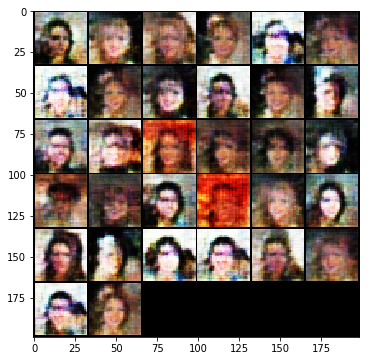

Iteration 31800: dis loss = 0.8615, gen loss = 1.4969, recon loss = 1.4969
Iteration 31850: dis loss = 1.3016, gen loss = 1.0342, recon loss = 1.0342
Iteration 31900: dis loss = 1.0603, gen loss = 1.9613, recon loss = 1.9613
Iteration 31950: dis loss = 0.8547, gen loss = 1.9040, recon loss = 1.9040
Iteration 32000: dis loss = 0.6701, gen loss = 1.8858, recon loss = 1.8858
Iteration 32050: dis loss = 0.6192, gen loss = 2.0710, recon loss = 2.0710
Iteration 32100: dis loss = 0.7873, gen loss = 1.2477, recon loss = 1.2477
Iteration 32150: dis loss = 0.7819, gen loss = 1.3049, recon loss = 1.3049
Iteration 32200: dis loss = 0.6783, gen loss = 1.7808, recon loss = 1.7808
Iteration 32250: dis loss = 1.2878, gen loss = 1.1506, recon loss = 1.1506
5 1000


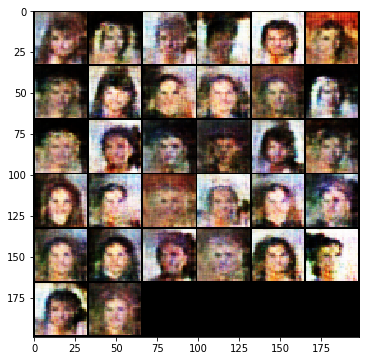

Iteration 32300: dis loss = 1.2301, gen loss = 1.6422, recon loss = 1.6422
Iteration 32350: dis loss = 0.7866, gen loss = 1.1019, recon loss = 1.1019
Iteration 32400: dis loss = 0.9174, gen loss = 1.4169, recon loss = 1.4169
Iteration 32450: dis loss = 1.1765, gen loss = 1.5597, recon loss = 1.5597
Iteration 32500: dis loss = 0.9956, gen loss = 1.2661, recon loss = 1.2661
Iteration 32550: dis loss = 0.5470, gen loss = 2.3826, recon loss = 2.3826
Iteration 32600: dis loss = 0.7262, gen loss = 1.2795, recon loss = 1.2795
Iteration 32650: dis loss = 1.3024, gen loss = 0.9657, recon loss = 0.9657
Iteration 32700: dis loss = 1.6939, gen loss = 0.9933, recon loss = 0.9933
Iteration 32750: dis loss = 0.7659, gen loss = 1.2750, recon loss = 1.2750
5 1500


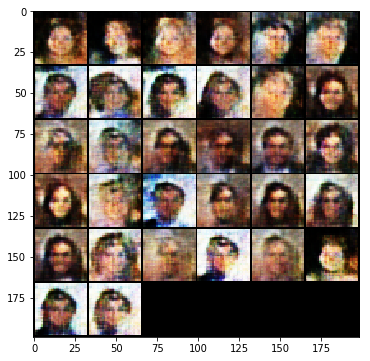

Iteration 32800: dis loss = 1.4943, gen loss = 1.9919, recon loss = 1.9919
Iteration 32850: dis loss = 0.3937, gen loss = 2.0317, recon loss = 2.0317
Iteration 32900: dis loss = 0.9266, gen loss = 1.1334, recon loss = 1.1334
Iteration 32950: dis loss = 0.6218, gen loss = 2.5659, recon loss = 2.5659
Iteration 33000: dis loss = 0.7497, gen loss = 1.3285, recon loss = 1.3285
Iteration 33050: dis loss = 0.2729, gen loss = 3.0570, recon loss = 3.0570
Iteration 33100: dis loss = 2.0344, gen loss = 1.6784, recon loss = 1.6784
Iteration 33150: dis loss = 0.3494, gen loss = 2.4707, recon loss = 2.4707
Iteration 33200: dis loss = 1.3539, gen loss = 0.6356, recon loss = 0.6356
Iteration 33250: dis loss = 0.7536, gen loss = 1.5495, recon loss = 1.5495
5 2000


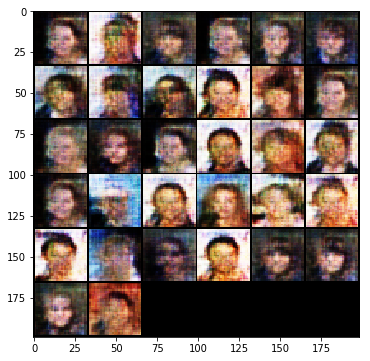

Iteration 33300: dis loss = 0.7709, gen loss = 1.4584, recon loss = 1.4584
Iteration 33350: dis loss = 0.5105, gen loss = 1.9319, recon loss = 1.9319
Iteration 33400: dis loss = 1.3646, gen loss = 1.0970, recon loss = 1.0970
Iteration 33450: dis loss = 0.7966, gen loss = 1.4624, recon loss = 1.4624
Iteration 33500: dis loss = 1.6971, gen loss = 1.7028, recon loss = 1.7028
Iteration 33550: dis loss = 0.5954, gen loss = 2.3944, recon loss = 2.3944
Iteration 33600: dis loss = 0.2451, gen loss = 2.6279, recon loss = 2.6279
Iteration 33650: dis loss = 0.9021, gen loss = 1.3360, recon loss = 1.3360
Iteration 33700: dis loss = 1.3248, gen loss = 1.9058, recon loss = 1.9058
Iteration 33750: dis loss = 0.6018, gen loss = 1.5845, recon loss = 1.5845
5 2500


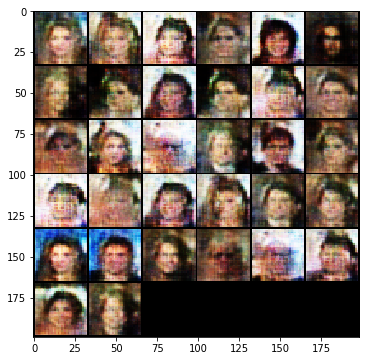

Iteration 33800: dis loss = 1.0454, gen loss = 1.5350, recon loss = 1.5350
Iteration 33850: dis loss = 1.3281, gen loss = 2.3095, recon loss = 2.3095
Iteration 33900: dis loss = 0.8931, gen loss = 2.3766, recon loss = 2.3766
Iteration 33950: dis loss = 0.4443, gen loss = 2.0272, recon loss = 2.0272
Iteration 34000: dis loss = 0.1620, gen loss = 3.5555, recon loss = 3.5555
Iteration 34050: dis loss = 0.5496, gen loss = 2.1871, recon loss = 2.1871
Iteration 34100: dis loss = 0.4824, gen loss = 1.9537, recon loss = 1.9537
Iteration 34150: dis loss = 2.6607, gen loss = 0.7666, recon loss = 0.7666
Iteration 34200: dis loss = 0.5388, gen loss = 2.3692, recon loss = 2.3692
Iteration 34250: dis loss = 0.4103, gen loss = 2.1794, recon loss = 2.1794
5 3000


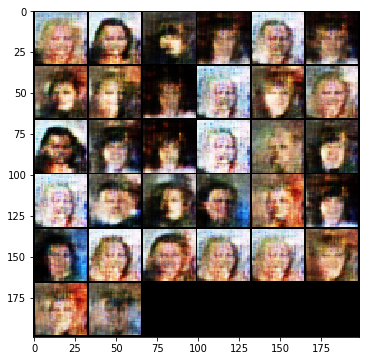

Iteration 34300: dis loss = 0.4271, gen loss = 2.4637, recon loss = 2.4637
Iteration 34350: dis loss = 0.5637, gen loss = 1.6989, recon loss = 1.6989
Iteration 34400: dis loss = 1.3502, gen loss = 1.3096, recon loss = 1.3096
Iteration 34450: dis loss = 1.5543, gen loss = 0.8630, recon loss = 0.8630
Iteration 34500: dis loss = 0.5032, gen loss = 2.5576, recon loss = 2.5576
Iteration 34550: dis loss = 1.2652, gen loss = 1.4373, recon loss = 1.4373
Iteration 34600: dis loss = 0.9053, gen loss = 1.6121, recon loss = 1.6121
Iteration 34650: dis loss = 1.1049, gen loss = 1.0108, recon loss = 1.0108
Iteration 34700: dis loss = 0.8097, gen loss = 1.8909, recon loss = 1.8909
Iteration 34750: dis loss = 0.5199, gen loss = 1.6012, recon loss = 1.6012
5 3500


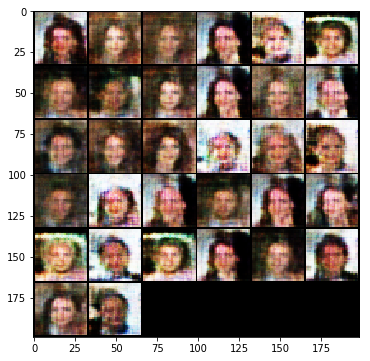

Iteration 34800: dis loss = 1.1264, gen loss = 0.8510, recon loss = 0.8510
Iteration 34850: dis loss = 0.5465, gen loss = 2.2212, recon loss = 2.2212
Iteration 34900: dis loss = 2.6423, gen loss = 2.2990, recon loss = 2.2990
Iteration 34950: dis loss = 2.0028, gen loss = 1.6170, recon loss = 1.6170
Iteration 35000: dis loss = 0.5824, gen loss = 1.9796, recon loss = 1.9796
Iteration 35050: dis loss = 0.9441, gen loss = 1.9525, recon loss = 1.9525
Iteration 35100: dis loss = 0.2266, gen loss = 2.5819, recon loss = 2.5819
Iteration 35150: dis loss = 0.4600, gen loss = 2.2294, recon loss = 2.2294
Iteration 35200: dis loss = 0.3996, gen loss = 2.2971, recon loss = 2.2971
Iteration 35250: dis loss = 0.6547, gen loss = 2.1369, recon loss = 2.1369
5 4000


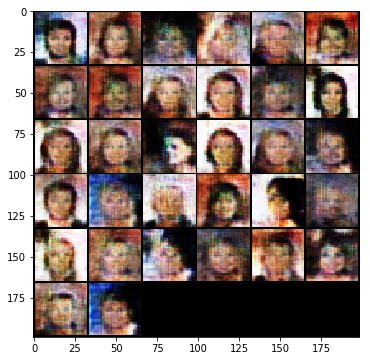

Iteration 35300: dis loss = 1.5910, gen loss = 1.0208, recon loss = 1.0208
Iteration 35350: dis loss = 0.3702, gen loss = 2.4151, recon loss = 2.4151
Iteration 35400: dis loss = 0.8511, gen loss = 1.2881, recon loss = 1.2881
Iteration 35450: dis loss = 0.8879, gen loss = 1.6441, recon loss = 1.6441
Iteration 35500: dis loss = 1.5158, gen loss = 2.1495, recon loss = 2.1495
Iteration 35550: dis loss = 0.5706, gen loss = 1.7797, recon loss = 1.7797
Iteration 35600: dis loss = 0.5943, gen loss = 2.1842, recon loss = 2.1842
Iteration 35650: dis loss = 0.6885, gen loss = 1.8948, recon loss = 1.8948
Iteration 35700: dis loss = 1.2333, gen loss = 2.4020, recon loss = 2.4020
Iteration 35750: dis loss = 1.3677, gen loss = 0.6908, recon loss = 0.6908
5 4500


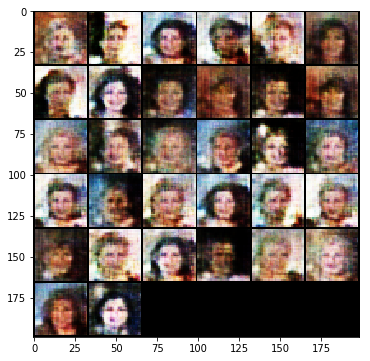

Iteration 35800: dis loss = 1.7115, gen loss = 0.7125, recon loss = 0.7125
Iteration 35850: dis loss = 0.6638, gen loss = 1.5435, recon loss = 1.5435
Iteration 35900: dis loss = 0.5864, gen loss = 1.6698, recon loss = 1.6698
Iteration 35950: dis loss = 0.7294, gen loss = 2.4944, recon loss = 2.4944
Iteration 36000: dis loss = 0.7444, gen loss = 2.4393, recon loss = 2.4393
Iteration 36050: dis loss = 0.2800, gen loss = 2.4566, recon loss = 2.4566
Iteration 36100: dis loss = 0.6881, gen loss = 1.9314, recon loss = 1.9314
Iteration 36150: dis loss = 0.2657, gen loss = 2.4946, recon loss = 2.4946
Iteration 36200: dis loss = 0.7362, gen loss = 1.6075, recon loss = 1.6075
Iteration 36250: dis loss = 0.4715, gen loss = 2.3782, recon loss = 2.3782
5 5000


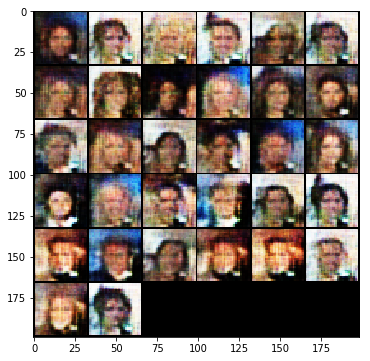

Iteration 36300: dis loss = 0.7359, gen loss = 1.3892, recon loss = 1.3892
Iteration 36350: dis loss = 0.6082, gen loss = 2.3343, recon loss = 2.3343
Iteration 36400: dis loss = 1.5321, gen loss = 1.5370, recon loss = 1.5370
Iteration 36450: dis loss = 0.7162, gen loss = 1.3102, recon loss = 1.3102
Iteration 36500: dis loss = 0.9575, gen loss = 0.7933, recon loss = 0.7933
Iteration 36550: dis loss = 0.9729, gen loss = 1.2280, recon loss = 1.2280
Iteration 36600: dis loss = 1.0779, gen loss = 1.2041, recon loss = 1.2041
Iteration 36650: dis loss = 0.5857, gen loss = 2.6580, recon loss = 2.6580
Iteration 36700: dis loss = 0.5739, gen loss = 1.7789, recon loss = 1.7789
Iteration 36750: dis loss = 1.3511, gen loss = 0.8691, recon loss = 0.8691
5 5500


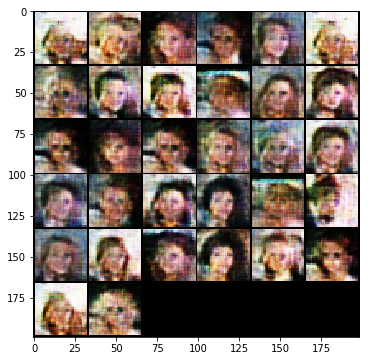

Iteration 36800: dis loss = 1.1442, gen loss = 1.1858, recon loss = 1.1858
Iteration 36850: dis loss = 0.3725, gen loss = 2.3908, recon loss = 2.3908
Iteration 36900: dis loss = 0.8778, gen loss = 1.5259, recon loss = 1.5259
Iteration 36950: dis loss = 1.3749, gen loss = 1.1354, recon loss = 1.1354
Iteration 37000: dis loss = 1.0544, gen loss = 1.4697, recon loss = 1.4697
Iteration 37050: dis loss = 0.5022, gen loss = 2.1350, recon loss = 2.1350
Iteration 37100: dis loss = 0.9366, gen loss = 1.6823, recon loss = 1.6823
Iteration 37150: dis loss = 0.9501, gen loss = 1.4247, recon loss = 1.4247
Iteration 37200: dis loss = 0.5624, gen loss = 1.9588, recon loss = 1.9588
Iteration 37250: dis loss = 0.5315, gen loss = 2.0000, recon loss = 2.0000
5 6000


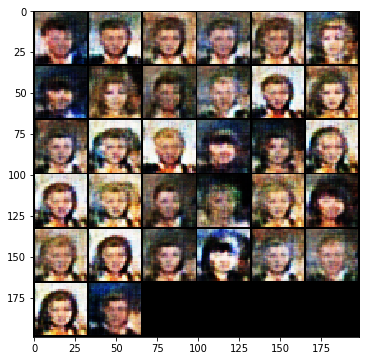

Iteration 37300: dis loss = 0.6040, gen loss = 2.3339, recon loss = 2.3339
Iteration 37350: dis loss = 0.7921, gen loss = 1.4176, recon loss = 1.4176
Iteration 37400: dis loss = 0.7187, gen loss = 2.0667, recon loss = 2.0667
Iteration 37450: dis loss = 0.5006, gen loss = 2.4787, recon loss = 2.4787
Iteration 37500: dis loss = 1.0898, gen loss = 1.8925, recon loss = 1.8925


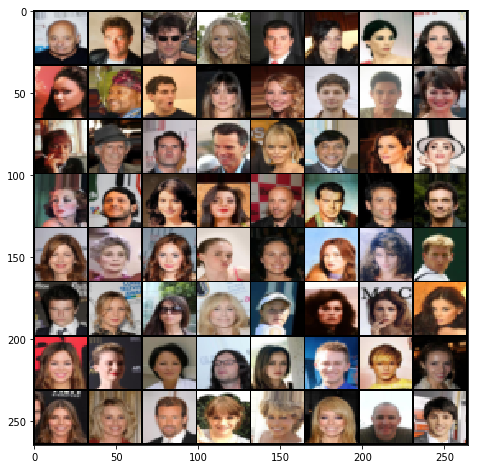

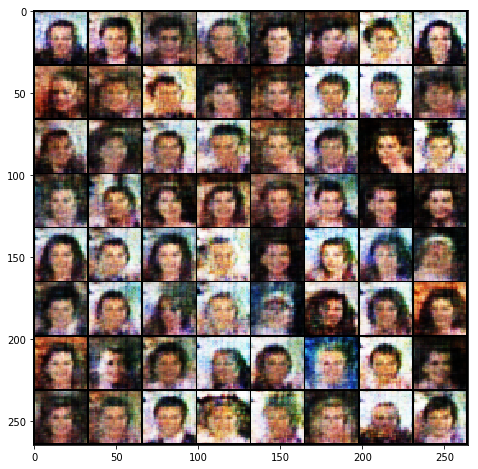

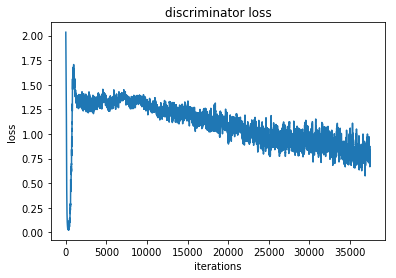

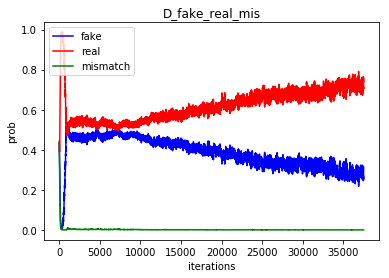

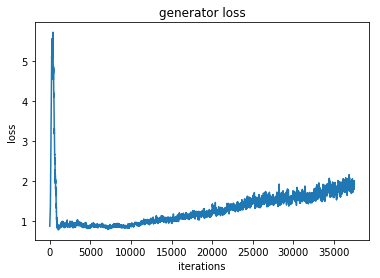

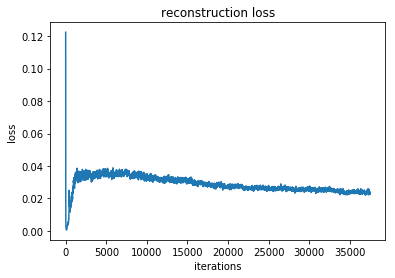

6 0


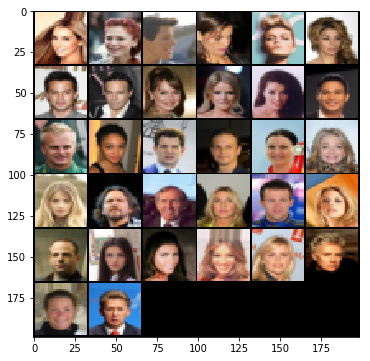

Iteration 37550: dis loss = 1.1529, gen loss = 1.4936, recon loss = 1.4936
Iteration 37600: dis loss = 0.5808, gen loss = 2.3330, recon loss = 2.3330
Iteration 37650: dis loss = 0.3929, gen loss = 2.4339, recon loss = 2.4339
Iteration 37700: dis loss = 0.2655, gen loss = 2.9800, recon loss = 2.9800
Iteration 37750: dis loss = 0.2484, gen loss = 2.9630, recon loss = 2.9630
Iteration 37800: dis loss = 2.1679, gen loss = 1.4180, recon loss = 1.4180
Iteration 37850: dis loss = 0.7870, gen loss = 2.1610, recon loss = 2.1610
Iteration 37900: dis loss = 0.5877, gen loss = 2.4591, recon loss = 2.4591
Iteration 37950: dis loss = 0.5752, gen loss = 2.3806, recon loss = 2.3806
Iteration 38000: dis loss = 0.6574, gen loss = 2.1875, recon loss = 2.1875
6 500


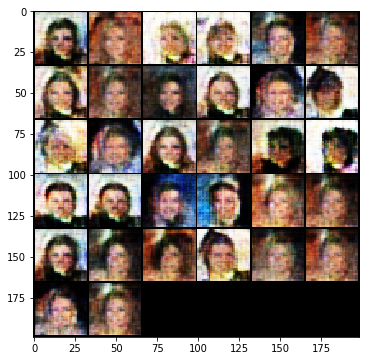

Iteration 38050: dis loss = 0.8135, gen loss = 1.4582, recon loss = 1.4582
Iteration 38100: dis loss = 1.0675, gen loss = 1.5840, recon loss = 1.5840
Iteration 38150: dis loss = 0.7072, gen loss = 2.5744, recon loss = 2.5744
Iteration 38200: dis loss = 0.7900, gen loss = 2.1542, recon loss = 2.1542
Iteration 38250: dis loss = 0.9321, gen loss = 1.9103, recon loss = 1.9103
Iteration 38300: dis loss = 0.5783, gen loss = 1.8235, recon loss = 1.8235
Iteration 38350: dis loss = 0.9078, gen loss = 1.1676, recon loss = 1.1676
Iteration 38400: dis loss = 0.6129, gen loss = 2.3401, recon loss = 2.3401
Iteration 38450: dis loss = 0.7513, gen loss = 1.5929, recon loss = 1.5929
Iteration 38500: dis loss = 0.7690, gen loss = 1.3071, recon loss = 1.3071
6 1000


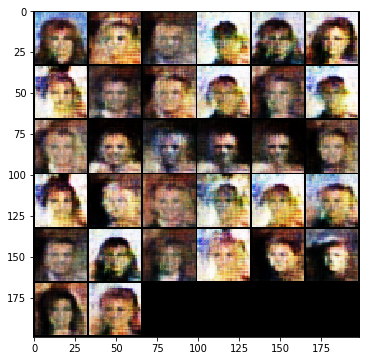

Iteration 38550: dis loss = 1.2214, gen loss = 2.0392, recon loss = 2.0392
Iteration 38600: dis loss = 1.4471, gen loss = 0.6901, recon loss = 0.6901
Iteration 38650: dis loss = 1.7201, gen loss = 1.7477, recon loss = 1.7477
Iteration 38700: dis loss = 1.0201, gen loss = 1.7455, recon loss = 1.7455
Iteration 38750: dis loss = 0.6930, gen loss = 1.7102, recon loss = 1.7102
Iteration 38800: dis loss = 0.3968, gen loss = 2.4098, recon loss = 2.4098
Iteration 38850: dis loss = 0.4627, gen loss = 2.0478, recon loss = 2.0478
Iteration 38900: dis loss = 1.1413, gen loss = 0.8690, recon loss = 0.8690
Iteration 38950: dis loss = 1.0549, gen loss = 1.1537, recon loss = 1.1537
Iteration 39000: dis loss = 0.5983, gen loss = 1.9982, recon loss = 1.9982
6 1500


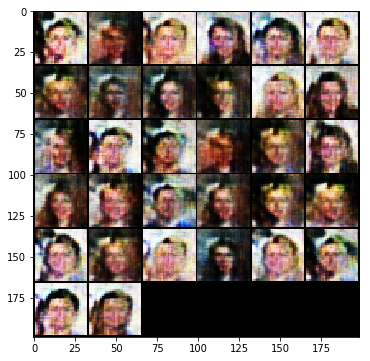

Iteration 39050: dis loss = 1.3447, gen loss = 1.6113, recon loss = 1.6113
Iteration 39100: dis loss = 0.8300, gen loss = 1.5231, recon loss = 1.5231
Iteration 39150: dis loss = 0.7368, gen loss = 1.9170, recon loss = 1.9170
Iteration 39200: dis loss = 0.5095, gen loss = 2.4734, recon loss = 2.4734
Iteration 39250: dis loss = 0.8908, gen loss = 1.2529, recon loss = 1.2529
Iteration 39300: dis loss = 0.1960, gen loss = 2.7707, recon loss = 2.7707
Iteration 39350: dis loss = 0.7437, gen loss = 1.5444, recon loss = 1.5444
Iteration 39400: dis loss = 0.5339, gen loss = 2.5157, recon loss = 2.5157
Iteration 39450: dis loss = 1.9212, gen loss = 0.4368, recon loss = 0.4368
Iteration 39500: dis loss = 0.7601, gen loss = 1.8758, recon loss = 1.8758
6 2000


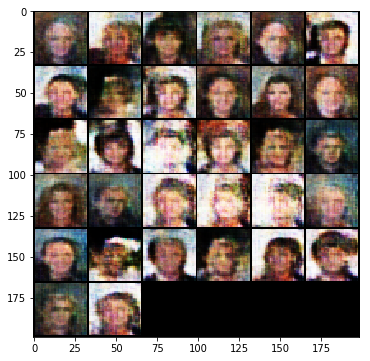

Iteration 39550: dis loss = 1.0816, gen loss = 1.1337, recon loss = 1.1337
Iteration 39600: dis loss = 0.7768, gen loss = 2.3720, recon loss = 2.3720
Iteration 39650: dis loss = 1.6932, gen loss = 1.2993, recon loss = 1.2993
Iteration 39700: dis loss = 0.7380, gen loss = 1.9166, recon loss = 1.9166
Iteration 39750: dis loss = 1.7893, gen loss = 1.2981, recon loss = 1.2981
Iteration 39800: dis loss = 0.3134, gen loss = 2.4623, recon loss = 2.4623
Iteration 39850: dis loss = 0.3262, gen loss = 2.5315, recon loss = 2.5315
Iteration 39900: dis loss = 0.6216, gen loss = 1.9255, recon loss = 1.9255
Iteration 39950: dis loss = 1.8677, gen loss = 1.7910, recon loss = 1.7910
Iteration 40000: dis loss = 0.6411, gen loss = 1.6487, recon loss = 1.6487
6 2500


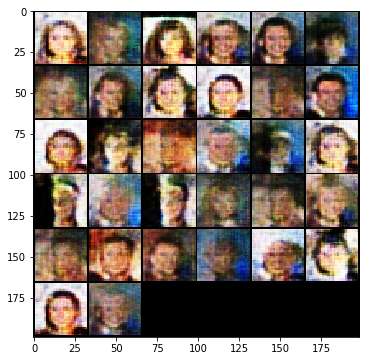

Iteration 40050: dis loss = 1.2080, gen loss = 1.5148, recon loss = 1.5148
Iteration 40100: dis loss = 1.0642, gen loss = 2.0560, recon loss = 2.0560
Iteration 40150: dis loss = 0.8695, gen loss = 1.9562, recon loss = 1.9562
Iteration 40200: dis loss = 1.4667, gen loss = 2.0363, recon loss = 2.0363
Iteration 40250: dis loss = 0.4491, gen loss = 1.9183, recon loss = 1.9183
Iteration 40300: dis loss = 0.5862, gen loss = 1.9894, recon loss = 1.9894
Iteration 40350: dis loss = 0.8175, gen loss = 1.5456, recon loss = 1.5456
Iteration 40400: dis loss = 1.9343, gen loss = 0.8264, recon loss = 0.8264
Iteration 40450: dis loss = 0.5640, gen loss = 2.2212, recon loss = 2.2212
Iteration 40500: dis loss = 0.5103, gen loss = 2.1292, recon loss = 2.1292
6 3000


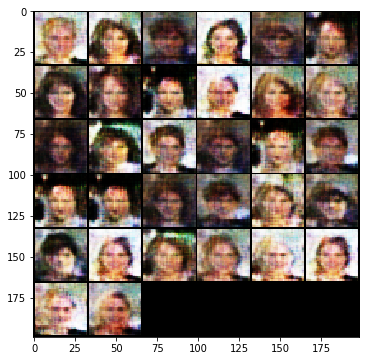

Iteration 40550: dis loss = 0.2435, gen loss = 2.9324, recon loss = 2.9324
Iteration 40600: dis loss = 0.4768, gen loss = 2.0929, recon loss = 2.0929
Iteration 40650: dis loss = 2.3964, gen loss = 1.5283, recon loss = 1.5283
Iteration 40700: dis loss = 1.5432, gen loss = 0.7472, recon loss = 0.7472
Iteration 40750: dis loss = 0.5068, gen loss = 1.7836, recon loss = 1.7836
Iteration 40800: dis loss = 1.6319, gen loss = 1.3413, recon loss = 1.3413
Iteration 40850: dis loss = 1.0397, gen loss = 2.1424, recon loss = 2.1424
Iteration 40900: dis loss = 0.9139, gen loss = 1.0384, recon loss = 1.0384
Iteration 40950: dis loss = 0.5317, gen loss = 2.2053, recon loss = 2.2053
Iteration 41000: dis loss = 0.4980, gen loss = 2.1201, recon loss = 2.1201
6 3500


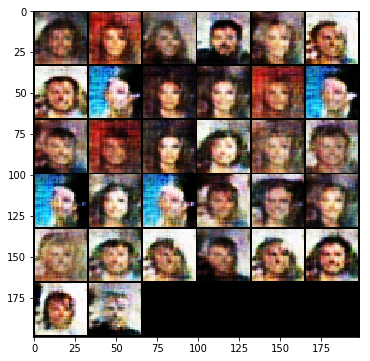

Iteration 41050: dis loss = 0.5702, gen loss = 1.7041, recon loss = 1.7041
Iteration 41100: dis loss = 0.3288, gen loss = 2.2821, recon loss = 2.2821
Iteration 41150: dis loss = 3.7732, gen loss = 2.4606, recon loss = 2.4606
Iteration 41200: dis loss = 0.9660, gen loss = 1.8195, recon loss = 1.8195
Iteration 41250: dis loss = 0.7263, gen loss = 2.1933, recon loss = 2.1933
Iteration 41300: dis loss = 0.4514, gen loss = 2.3087, recon loss = 2.3087
Iteration 41350: dis loss = 1.1291, gen loss = 2.7296, recon loss = 2.7296
Iteration 41400: dis loss = 0.7060, gen loss = 1.5720, recon loss = 1.5720
Iteration 41450: dis loss = 0.5661, gen loss = 1.9513, recon loss = 1.9513
Iteration 41500: dis loss = 0.3522, gen loss = 2.5846, recon loss = 2.5846
6 4000


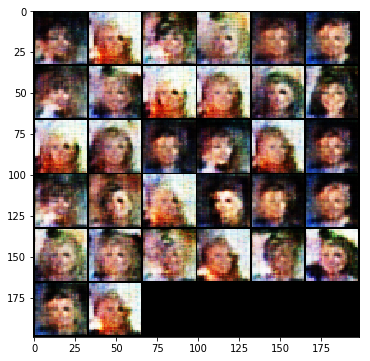

Iteration 41550: dis loss = 1.3040, gen loss = 1.4626, recon loss = 1.4626
Iteration 41600: dis loss = 0.2851, gen loss = 2.7678, recon loss = 2.7678
Iteration 41650: dis loss = 0.8371, gen loss = 1.1161, recon loss = 1.1161
Iteration 41700: dis loss = 1.2680, gen loss = 0.8789, recon loss = 0.8789
Iteration 41750: dis loss = 0.7974, gen loss = 2.1630, recon loss = 2.1630
Iteration 41800: dis loss = 0.6173, gen loss = 2.1016, recon loss = 2.1016
Iteration 41850: dis loss = 0.1849, gen loss = 2.9132, recon loss = 2.9132
Iteration 41900: dis loss = 0.4782, gen loss = 2.0775, recon loss = 2.0775
Iteration 41950: dis loss = 0.9251, gen loss = 2.1871, recon loss = 2.1871
Iteration 42000: dis loss = 1.4546, gen loss = 1.5158, recon loss = 1.5158
6 4500


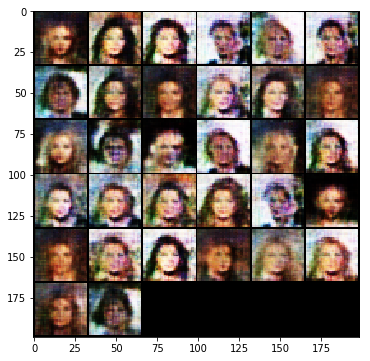

Iteration 42050: dis loss = 1.0835, gen loss = 0.9950, recon loss = 0.9950
Iteration 42100: dis loss = 0.4930, gen loss = 1.9506, recon loss = 1.9506
Iteration 42150: dis loss = 0.5234, gen loss = 1.9640, recon loss = 1.9640
Iteration 42200: dis loss = 0.9534, gen loss = 2.4419, recon loss = 2.4419
Iteration 42250: dis loss = 0.5857, gen loss = 2.6535, recon loss = 2.6535
Iteration 42300: dis loss = 0.3060, gen loss = 2.5919, recon loss = 2.5919
Iteration 42350: dis loss = 0.6418, gen loss = 1.7836, recon loss = 1.7836
Iteration 42400: dis loss = 0.2212, gen loss = 2.7655, recon loss = 2.7655
Iteration 42450: dis loss = 0.4944, gen loss = 1.9230, recon loss = 1.9230
Iteration 42500: dis loss = 0.5299, gen loss = 1.9862, recon loss = 1.9862
6 5000


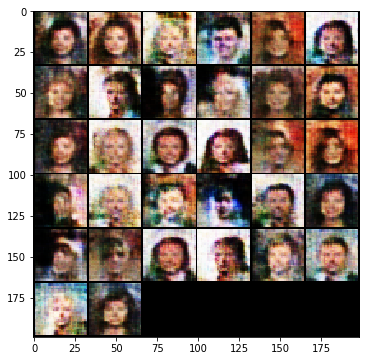

Iteration 42550: dis loss = 0.3635, gen loss = 2.2693, recon loss = 2.2693
Iteration 42600: dis loss = 0.3178, gen loss = 2.2795, recon loss = 2.2795
Iteration 42650: dis loss = 0.8429, gen loss = 1.7479, recon loss = 1.7479
Iteration 42700: dis loss = 1.5698, gen loss = 0.9764, recon loss = 0.9764
Iteration 42750: dis loss = 0.7479, gen loss = 1.4063, recon loss = 1.4063
Iteration 42800: dis loss = 1.1513, gen loss = 1.6926, recon loss = 1.6926
Iteration 42850: dis loss = 1.0520, gen loss = 1.4619, recon loss = 1.4619
Iteration 42900: dis loss = 0.7364, gen loss = 2.3858, recon loss = 2.3858
Iteration 42950: dis loss = 0.6864, gen loss = 1.5645, recon loss = 1.5645
Iteration 43000: dis loss = 1.1784, gen loss = 1.7673, recon loss = 1.7673
6 5500


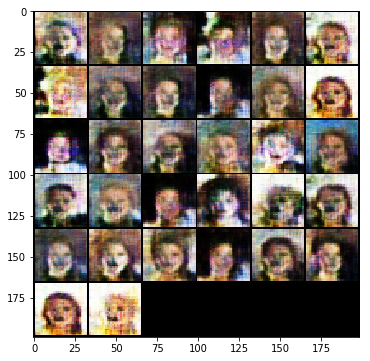

Iteration 43050: dis loss = 1.2744, gen loss = 1.3152, recon loss = 1.3152
Iteration 43100: dis loss = 0.2267, gen loss = 3.2976, recon loss = 3.2976
Iteration 43150: dis loss = 0.8424, gen loss = 1.5186, recon loss = 1.5186
Iteration 43200: dis loss = 1.2149, gen loss = 1.0169, recon loss = 1.0169
Iteration 43250: dis loss = 0.5851, gen loss = 1.6344, recon loss = 1.6344
Iteration 43300: dis loss = 0.7429, gen loss = 1.5340, recon loss = 1.5340
Iteration 43350: dis loss = 1.2256, gen loss = 0.9714, recon loss = 0.9714
Iteration 43400: dis loss = 1.0969, gen loss = 1.0308, recon loss = 1.0308
Iteration 43450: dis loss = 0.8040, gen loss = 1.6298, recon loss = 1.6298
Iteration 43500: dis loss = 0.3684, gen loss = 2.7188, recon loss = 2.7188
6 6000


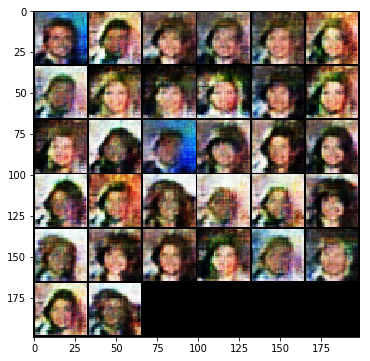

Iteration 43550: dis loss = 0.3219, gen loss = 2.3716, recon loss = 2.3716
Iteration 43600: dis loss = 0.6636, gen loss = 1.5826, recon loss = 1.5826
Iteration 43650: dis loss = 1.5723, gen loss = 1.8134, recon loss = 1.8134
Iteration 43700: dis loss = 0.4652, gen loss = 2.5084, recon loss = 2.5084
Iteration 43750: dis loss = 0.4756, gen loss = 2.3432, recon loss = 2.3432


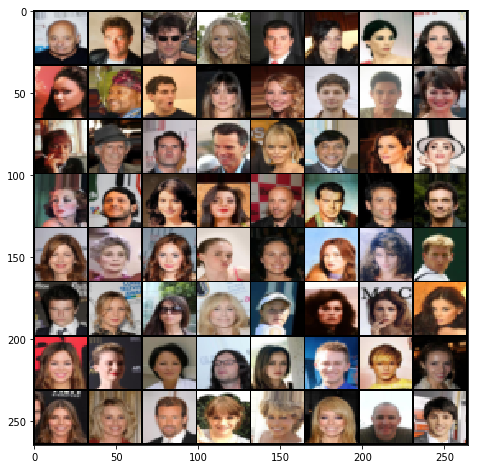

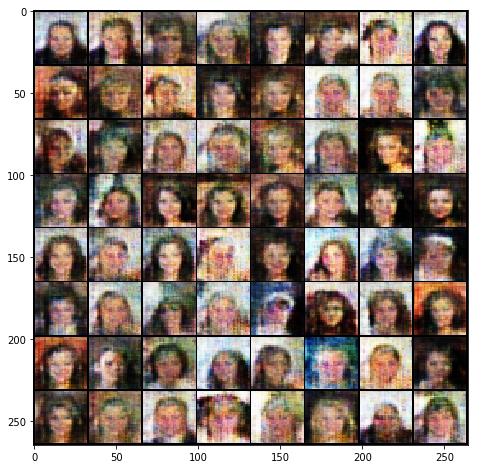

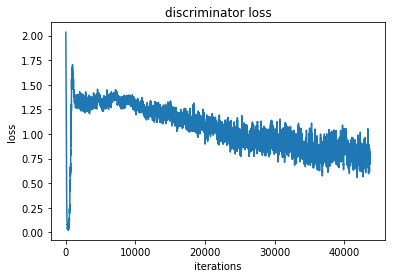

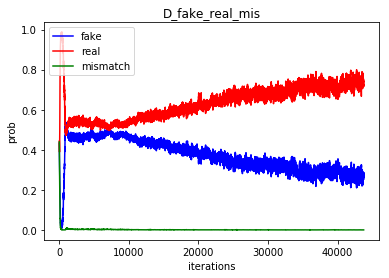

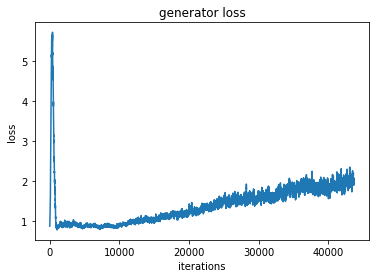

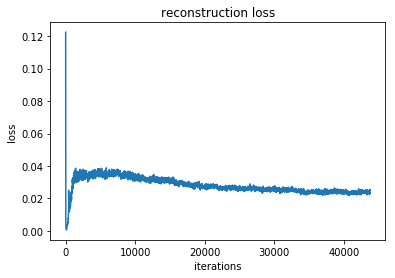

7 0


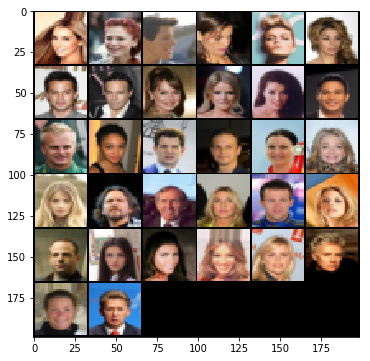

Iteration 43800: dis loss = 0.6871, gen loss = 1.8276, recon loss = 1.8276
Iteration 43850: dis loss = 0.4570, gen loss = 2.3771, recon loss = 2.3771
Iteration 43900: dis loss = 0.5862, gen loss = 1.7449, recon loss = 1.7449
Iteration 43950: dis loss = 0.3064, gen loss = 3.3106, recon loss = 3.3106
Iteration 44000: dis loss = 0.2568, gen loss = 3.7382, recon loss = 3.7382
Iteration 44050: dis loss = 2.2798, gen loss = 1.5287, recon loss = 1.5287
Iteration 44100: dis loss = 0.7304, gen loss = 1.6349, recon loss = 1.6349
Iteration 44150: dis loss = 0.9911, gen loss = 2.2576, recon loss = 2.2576
Iteration 44200: dis loss = 0.4024, gen loss = 2.2935, recon loss = 2.2935
Iteration 44250: dis loss = 0.5651, gen loss = 2.6034, recon loss = 2.6034
7 500


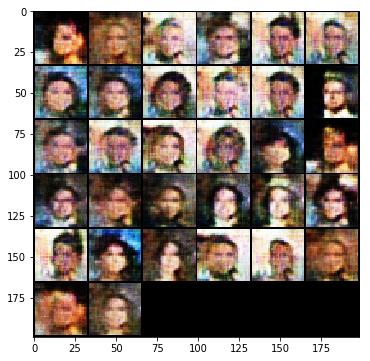

Iteration 44300: dis loss = 0.6667, gen loss = 1.6250, recon loss = 1.6250
Iteration 44350: dis loss = 0.9361, gen loss = 1.3691, recon loss = 1.3691
Iteration 44400: dis loss = 0.1789, gen loss = 2.9725, recon loss = 2.9725
Iteration 44450: dis loss = 0.3434, gen loss = 2.2854, recon loss = 2.2854
Iteration 44500: dis loss = 0.4687, gen loss = 1.9398, recon loss = 1.9398
Iteration 44550: dis loss = 0.3193, gen loss = 2.3619, recon loss = 2.3619
Iteration 44600: dis loss = 0.6218, gen loss = 1.5824, recon loss = 1.5824
Iteration 44650: dis loss = 0.5401, gen loss = 1.8469, recon loss = 1.8469
Iteration 44700: dis loss = 0.6281, gen loss = 1.8112, recon loss = 1.8112
Iteration 44750: dis loss = 1.0001, gen loss = 1.5558, recon loss = 1.5558
7 1000


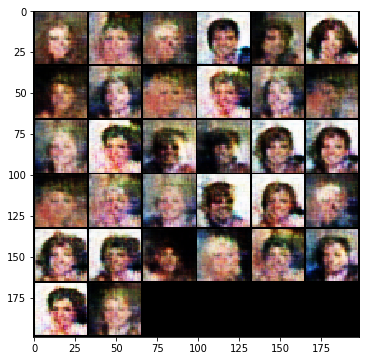

Iteration 44800: dis loss = 1.0908, gen loss = 0.9667, recon loss = 0.9667
Iteration 44850: dis loss = 0.8546, gen loss = 1.4290, recon loss = 1.4290
Iteration 44900: dis loss = 0.7526, gen loss = 1.5914, recon loss = 1.5914
Iteration 44950: dis loss = 0.4549, gen loss = 2.2458, recon loss = 2.2458
Iteration 45000: dis loss = 0.5266, gen loss = 1.8934, recon loss = 1.8934
Iteration 45050: dis loss = 0.2232, gen loss = 2.8819, recon loss = 2.8819
Iteration 45100: dis loss = 0.3677, gen loss = 2.3028, recon loss = 2.3028
Iteration 45150: dis loss = 1.2013, gen loss = 1.5240, recon loss = 1.5240
Iteration 45200: dis loss = 0.6556, gen loss = 1.5923, recon loss = 1.5923
Iteration 45250: dis loss = 0.8127, gen loss = 2.1185, recon loss = 2.1185
7 1500


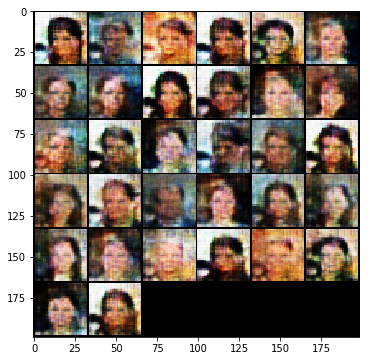

Iteration 45300: dis loss = 0.4587, gen loss = 2.0021, recon loss = 2.0021
Iteration 45350: dis loss = 0.3377, gen loss = 2.5066, recon loss = 2.5066
Iteration 45400: dis loss = 0.8574, gen loss = 2.1177, recon loss = 2.1177
Iteration 45450: dis loss = 1.5508, gen loss = 2.6826, recon loss = 2.6826
Iteration 45500: dis loss = 0.5198, gen loss = 1.6963, recon loss = 1.6963
Iteration 45550: dis loss = 0.2903, gen loss = 2.8524, recon loss = 2.8524
Iteration 45600: dis loss = 0.7917, gen loss = 2.5274, recon loss = 2.5274
Iteration 45650: dis loss = 0.1936, gen loss = 2.9200, recon loss = 2.9200
Iteration 45700: dis loss = 1.1590, gen loss = 1.5837, recon loss = 1.5837
Iteration 45750: dis loss = 0.4932, gen loss = 2.6027, recon loss = 2.6027
7 2000


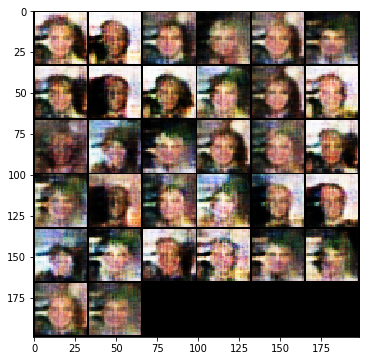

Iteration 45800: dis loss = 0.8614, gen loss = 2.4590, recon loss = 2.4590
Iteration 45850: dis loss = 0.2515, gen loss = 2.5389, recon loss = 2.5389
Iteration 45900: dis loss = 1.8811, gen loss = 1.1831, recon loss = 1.1831
Iteration 45950: dis loss = 0.3522, gen loss = 2.2394, recon loss = 2.2394
Iteration 46000: dis loss = 1.1175, gen loss = 1.8174, recon loss = 1.8174
Iteration 46050: dis loss = 0.3782, gen loss = 2.6334, recon loss = 2.6334
Iteration 46100: dis loss = 0.2963, gen loss = 4.9450, recon loss = 4.9450
Iteration 46150: dis loss = 0.8271, gen loss = 1.5098, recon loss = 1.5098
Iteration 46200: dis loss = 0.4619, gen loss = 2.1978, recon loss = 2.1978
Iteration 46250: dis loss = 0.4896, gen loss = 2.4508, recon loss = 2.4508
7 2500


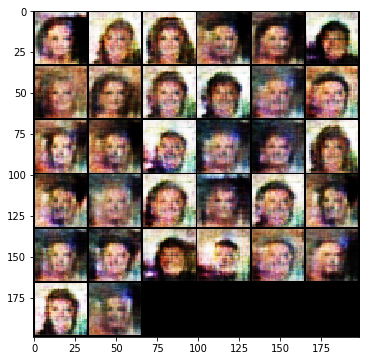

Iteration 46300: dis loss = 0.5710, gen loss = 2.0692, recon loss = 2.0692
Iteration 46350: dis loss = 0.3650, gen loss = 2.3448, recon loss = 2.3448
Iteration 46400: dis loss = 0.9422, gen loss = 2.8970, recon loss = 2.8970
Iteration 46450: dis loss = 0.2885, gen loss = 2.6730, recon loss = 2.6730
Iteration 46500: dis loss = 0.1729, gen loss = 3.0564, recon loss = 3.0564
Iteration 46550: dis loss = 0.4378, gen loss = 2.2634, recon loss = 2.2634
Iteration 46600: dis loss = 0.5177, gen loss = 2.3212, recon loss = 2.3212
Iteration 46650: dis loss = 2.0114, gen loss = 0.5705, recon loss = 0.5705
Iteration 46700: dis loss = 0.6153, gen loss = 2.8700, recon loss = 2.8700
Iteration 46750: dis loss = 0.3608, gen loss = 2.6492, recon loss = 2.6492
7 3000


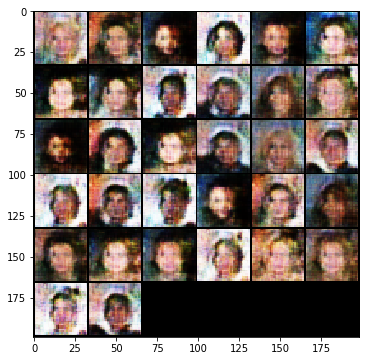

Iteration 46800: dis loss = 0.4129, gen loss = 2.4121, recon loss = 2.4121
Iteration 46850: dis loss = 0.3584, gen loss = 2.4095, recon loss = 2.4095
Iteration 46900: dis loss = 1.9885, gen loss = 2.3213, recon loss = 2.3213
Iteration 46950: dis loss = 1.8597, gen loss = 0.8478, recon loss = 0.8478
Iteration 47000: dis loss = 0.5131, gen loss = 3.4139, recon loss = 3.4139
Iteration 47050: dis loss = 1.3350, gen loss = 1.2948, recon loss = 1.2948
Iteration 47100: dis loss = 0.5114, gen loss = 1.8838, recon loss = 1.8838
Iteration 47150: dis loss = 0.5187, gen loss = 2.0737, recon loss = 2.0737
Iteration 47200: dis loss = 0.5522, gen loss = 2.0479, recon loss = 2.0479
Iteration 47250: dis loss = 0.3135, gen loss = 2.3297, recon loss = 2.3297
7 3500


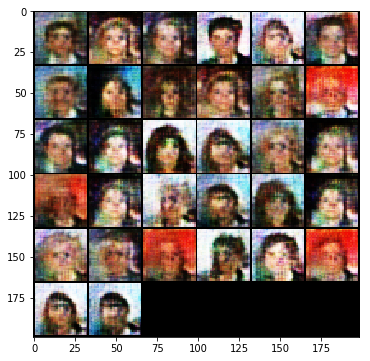

Iteration 47300: dis loss = 1.1059, gen loss = 0.9159, recon loss = 0.9159
Iteration 47350: dis loss = 0.3528, gen loss = 2.2277, recon loss = 2.2277
Iteration 47400: dis loss = 2.3064, gen loss = 1.3532, recon loss = 1.3532
Iteration 47450: dis loss = 0.7747, gen loss = 2.7697, recon loss = 2.7697
Iteration 47500: dis loss = 0.5461, gen loss = 2.1295, recon loss = 2.1295
Iteration 47550: dis loss = 0.5304, gen loss = 2.7051, recon loss = 2.7051
Iteration 47600: dis loss = 0.3753, gen loss = 3.2890, recon loss = 3.2890
Iteration 47650: dis loss = 0.5867, gen loss = 1.7568, recon loss = 1.7568
Iteration 47700: dis loss = 0.4652, gen loss = 2.3795, recon loss = 2.3795
Iteration 47750: dis loss = 0.2796, gen loss = 2.3837, recon loss = 2.3837
7 4000


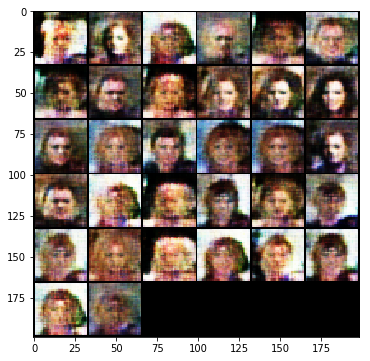

Iteration 47800: dis loss = 2.0730, gen loss = 1.2532, recon loss = 1.2532
Iteration 47850: dis loss = 0.4640, gen loss = 2.3997, recon loss = 2.3997
Iteration 47900: dis loss = 0.8446, gen loss = 2.3261, recon loss = 2.3261
Iteration 47950: dis loss = 0.9147, gen loss = 1.2963, recon loss = 1.2963
Iteration 48000: dis loss = 0.6082, gen loss = 2.3858, recon loss = 2.3858
Iteration 48050: dis loss = 0.3466, gen loss = 2.3219, recon loss = 2.3219
Iteration 48100: dis loss = 0.2280, gen loss = 2.8339, recon loss = 2.8339
Iteration 48150: dis loss = 0.4597, gen loss = 2.0421, recon loss = 2.0421
Iteration 48200: dis loss = 1.6782, gen loss = 2.7644, recon loss = 2.7644
Iteration 48250: dis loss = 1.1690, gen loss = 1.6179, recon loss = 1.6179
7 4500


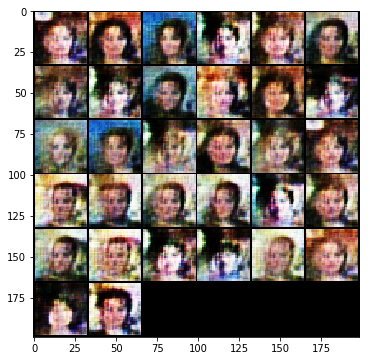

Iteration 48300: dis loss = 1.0692, gen loss = 1.0321, recon loss = 1.0321
Iteration 48350: dis loss = 0.5829, gen loss = 2.5860, recon loss = 2.5860
Iteration 48400: dis loss = 0.7408, gen loss = 1.4603, recon loss = 1.4603
Iteration 48450: dis loss = 0.2064, gen loss = 3.0375, recon loss = 3.0375
Iteration 48500: dis loss = 1.0704, gen loss = 2.3375, recon loss = 2.3375
Iteration 48550: dis loss = 0.3887, gen loss = 2.4309, recon loss = 2.4309
Iteration 48600: dis loss = 0.2805, gen loss = 2.5990, recon loss = 2.5990
Iteration 48650: dis loss = 0.4721, gen loss = 2.3538, recon loss = 2.3538
Iteration 48700: dis loss = 0.4356, gen loss = 2.3206, recon loss = 2.3206
Iteration 48750: dis loss = 0.3934, gen loss = 2.4344, recon loss = 2.4344
7 5000


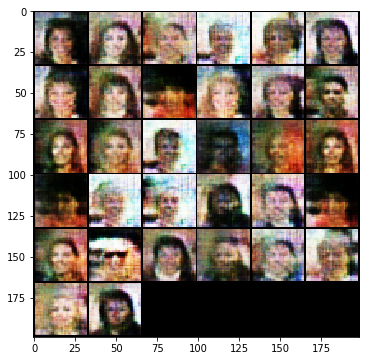

Iteration 48800: dis loss = 0.4858, gen loss = 2.4842, recon loss = 2.4842
Iteration 48850: dis loss = 0.1950, gen loss = 2.7809, recon loss = 2.7809
Iteration 48900: dis loss = 0.7317, gen loss = 2.0126, recon loss = 2.0126
Iteration 48950: dis loss = 0.6327, gen loss = 1.6272, recon loss = 1.6272
Iteration 49000: dis loss = 1.6494, gen loss = 1.7422, recon loss = 1.7422
Iteration 49050: dis loss = 0.7169, gen loss = 1.7951, recon loss = 1.7951
Iteration 49100: dis loss = 0.6747, gen loss = 2.5386, recon loss = 2.5386
Iteration 49150: dis loss = 0.4707, gen loss = 2.5609, recon loss = 2.5609
Iteration 49200: dis loss = 0.9404, gen loss = 1.3269, recon loss = 1.3269
Iteration 49250: dis loss = 1.3961, gen loss = 0.6419, recon loss = 0.6419
7 5500


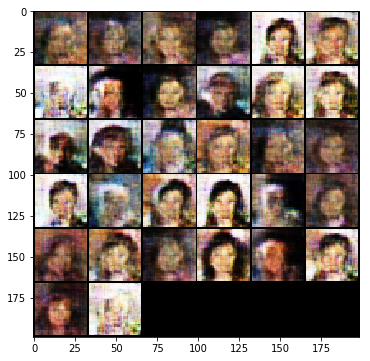

Iteration 49300: dis loss = 0.9451, gen loss = 2.1256, recon loss = 2.1256
Iteration 49350: dis loss = 0.4829, gen loss = 2.0153, recon loss = 2.0153
Iteration 49400: dis loss = 0.4807, gen loss = 2.0578, recon loss = 2.0578
Iteration 49450: dis loss = 1.1569, gen loss = 1.3009, recon loss = 1.3009
Iteration 49500: dis loss = 1.5428, gen loss = 3.1772, recon loss = 3.1772
Iteration 49550: dis loss = 0.6201, gen loss = 1.9080, recon loss = 1.9080
Iteration 49600: dis loss = 0.8835, gen loss = 1.3179, recon loss = 1.3179
Iteration 49650: dis loss = 0.7126, gen loss = 1.7668, recon loss = 1.7668
Iteration 49700: dis loss = 0.5731, gen loss = 2.1186, recon loss = 2.1186
Iteration 49750: dis loss = 0.6139, gen loss = 1.6249, recon loss = 1.6249
7 6000


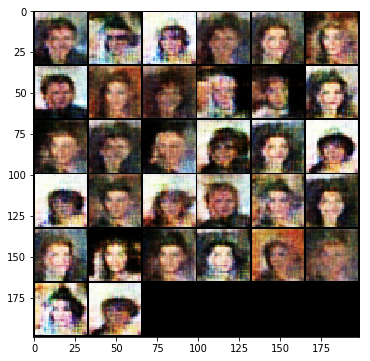

Iteration 49800: dis loss = 0.2495, gen loss = 2.6758, recon loss = 2.6758
Iteration 49850: dis loss = 0.7217, gen loss = 1.9356, recon loss = 1.9356
Iteration 49900: dis loss = 1.1625, gen loss = 1.8343, recon loss = 1.8343
Iteration 49950: dis loss = 0.6237, gen loss = 2.7593, recon loss = 2.7593
Iteration 50000: dis loss = 0.3154, gen loss = 2.3181, recon loss = 2.3181


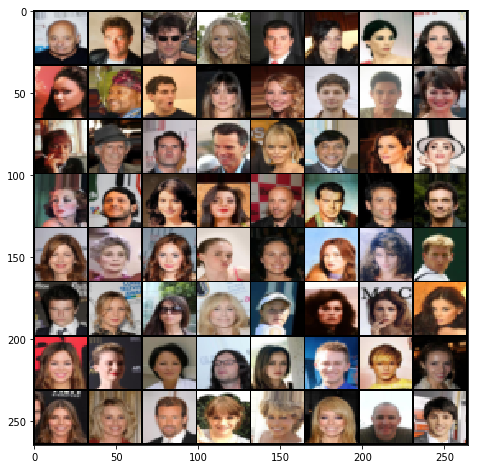

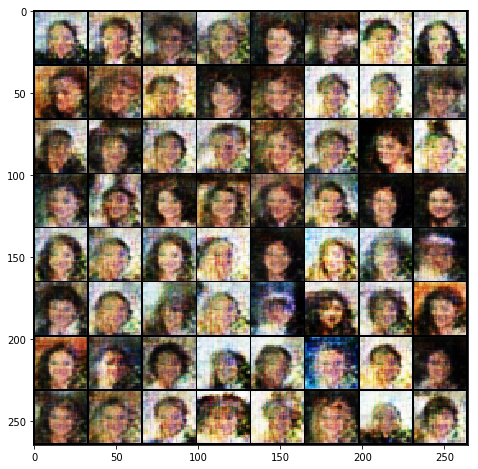

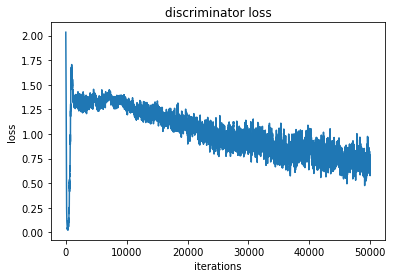

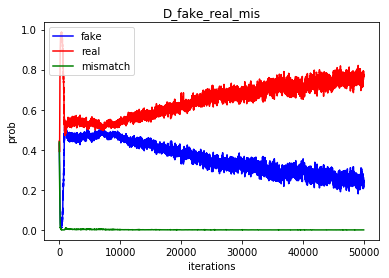

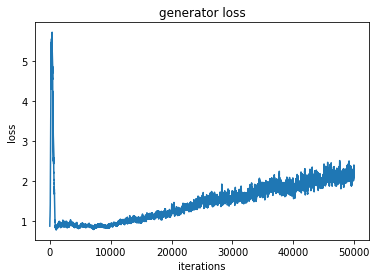

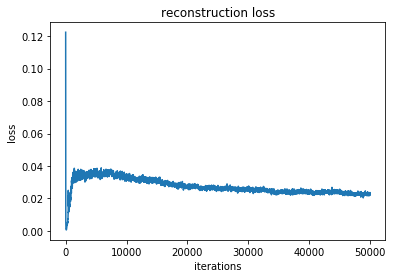

8 0


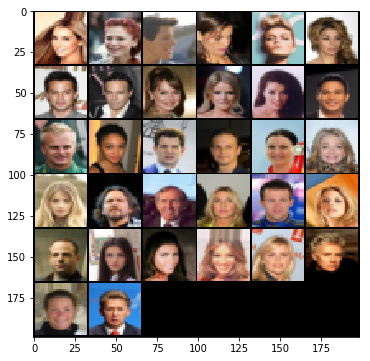

Iteration 50050: dis loss = 1.3489, gen loss = 1.9500, recon loss = 1.9500
Iteration 50100: dis loss = 1.1173, gen loss = 2.4755, recon loss = 2.4755
Iteration 50150: dis loss = 0.5495, gen loss = 2.7334, recon loss = 2.7334
Iteration 50200: dis loss = 0.2555, gen loss = 2.3991, recon loss = 2.3991
Iteration 50250: dis loss = 0.2949, gen loss = 4.4795, recon loss = 4.4795
Iteration 50300: dis loss = 1.5194, gen loss = 1.9428, recon loss = 1.9428
Iteration 50350: dis loss = 0.6166, gen loss = 1.7574, recon loss = 1.7574
Iteration 50400: dis loss = 1.5246, gen loss = 2.3372, recon loss = 2.3372
Iteration 50450: dis loss = 0.4899, gen loss = 2.0741, recon loss = 2.0741
Iteration 50500: dis loss = 0.8952, gen loss = 2.5508, recon loss = 2.5508
8 500


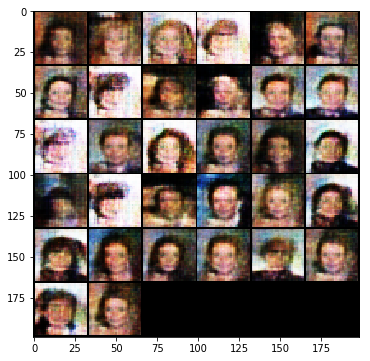

Iteration 50550: dis loss = 1.4468, gen loss = 1.8205, recon loss = 1.8205
Iteration 50600: dis loss = 1.1069, gen loss = 1.1009, recon loss = 1.1009
Iteration 50650: dis loss = 1.5692, gen loss = 2.4048, recon loss = 2.4048
Iteration 50700: dis loss = 0.5639, gen loss = 1.8745, recon loss = 1.8745
Iteration 50750: dis loss = 0.4074, gen loss = 2.5486, recon loss = 2.5486
Iteration 50800: dis loss = 0.3290, gen loss = 2.6299, recon loss = 2.6299
Iteration 50850: dis loss = 0.6405, gen loss = 1.6429, recon loss = 1.6429
Iteration 50900: dis loss = 0.4678, gen loss = 2.2982, recon loss = 2.2982
Iteration 50950: dis loss = 0.2348, gen loss = 2.6999, recon loss = 2.6999
Iteration 51000: dis loss = 0.5835, gen loss = 2.1043, recon loss = 2.1043
8 1000


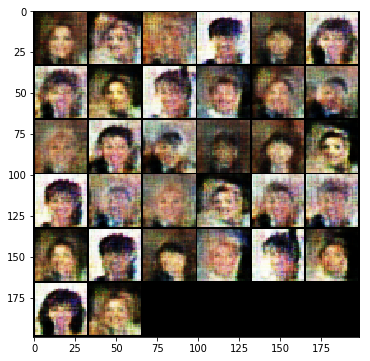

Iteration 51050: dis loss = 0.5256, gen loss = 1.7977, recon loss = 1.7977
Iteration 51100: dis loss = 0.9711, gen loss = 2.4228, recon loss = 2.4228
Iteration 51150: dis loss = 0.8722, gen loss = 1.5813, recon loss = 1.5813
Iteration 51200: dis loss = 0.8486, gen loss = 2.3945, recon loss = 2.3945
Iteration 51250: dis loss = 0.5907, gen loss = 1.7848, recon loss = 1.7848
Iteration 51300: dis loss = 0.2782, gen loss = 2.5514, recon loss = 2.5514
Iteration 51350: dis loss = 0.6865, gen loss = 1.4570, recon loss = 1.4570
Iteration 51400: dis loss = 1.0594, gen loss = 1.3025, recon loss = 1.3025
Iteration 51450: dis loss = 1.2677, gen loss = 1.2841, recon loss = 1.2841
Iteration 51500: dis loss = 0.6356, gen loss = 2.4468, recon loss = 2.4468
8 1500


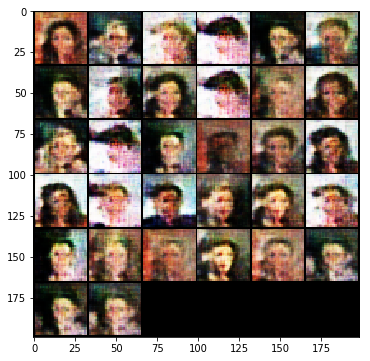

Iteration 51550: dis loss = 0.4470, gen loss = 2.3299, recon loss = 2.3299
Iteration 51600: dis loss = 0.7939, gen loss = 1.9905, recon loss = 1.9905
Iteration 51650: dis loss = 0.3765, gen loss = 2.4778, recon loss = 2.4778
Iteration 51700: dis loss = 0.5078, gen loss = 2.6303, recon loss = 2.6303
Iteration 51750: dis loss = 0.5968, gen loss = 1.7869, recon loss = 1.7869
Iteration 51800: dis loss = 0.1946, gen loss = 3.3340, recon loss = 3.3340
Iteration 51850: dis loss = 0.9405, gen loss = 1.7852, recon loss = 1.7852
Iteration 51900: dis loss = 0.2068, gen loss = 3.0949, recon loss = 3.0949
Iteration 51950: dis loss = 1.2756, gen loss = 1.6750, recon loss = 1.6750
Iteration 52000: dis loss = 0.7852, gen loss = 2.5689, recon loss = 2.5689
8 2000


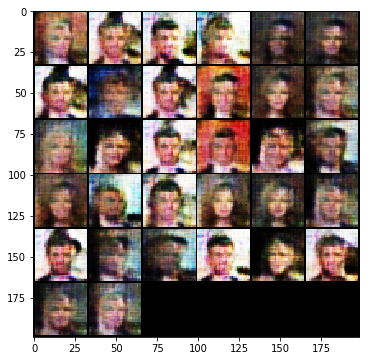

Iteration 52050: dis loss = 0.5805, gen loss = 1.8036, recon loss = 1.8036
Iteration 52100: dis loss = 0.6341, gen loss = 2.3870, recon loss = 2.3870
Iteration 52150: dis loss = 1.6096, gen loss = 0.8553, recon loss = 0.8553
Iteration 52200: dis loss = 0.2260, gen loss = 3.4095, recon loss = 3.4095
Iteration 52250: dis loss = 1.9363, gen loss = 2.1888, recon loss = 2.1888
Iteration 52300: dis loss = 0.5289, gen loss = 2.6211, recon loss = 2.6211
Iteration 52350: dis loss = 0.3763, gen loss = 3.5024, recon loss = 3.5024
Iteration 52400: dis loss = 0.6151, gen loss = 2.3498, recon loss = 2.3498
Iteration 52450: dis loss = 0.5627, gen loss = 3.1036, recon loss = 3.1036
Iteration 52500: dis loss = 0.3210, gen loss = 2.4022, recon loss = 2.4022
8 2500


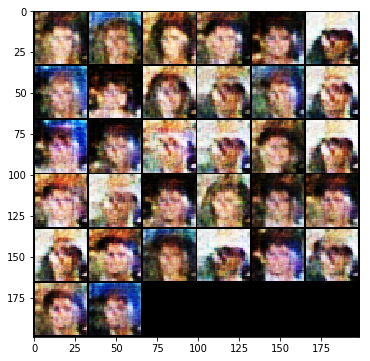

Iteration 52550: dis loss = 0.5594, gen loss = 1.8820, recon loss = 1.8820
Iteration 52600: dis loss = 0.5465, gen loss = 2.6991, recon loss = 2.6991
Iteration 52650: dis loss = 0.8242, gen loss = 1.2809, recon loss = 1.2809
Iteration 52700: dis loss = 0.7493, gen loss = 2.8378, recon loss = 2.8378
Iteration 52750: dis loss = 0.2497, gen loss = 3.3095, recon loss = 3.3095
Iteration 52800: dis loss = 1.9377, gen loss = 1.7392, recon loss = 1.7392
Iteration 52850: dis loss = 0.5511, gen loss = 2.0378, recon loss = 2.0378
Iteration 52900: dis loss = 1.9655, gen loss = 0.8839, recon loss = 0.8839
Iteration 52950: dis loss = 1.4444, gen loss = 2.3068, recon loss = 2.3068
Iteration 53000: dis loss = 0.4885, gen loss = 2.3789, recon loss = 2.3789
8 3000


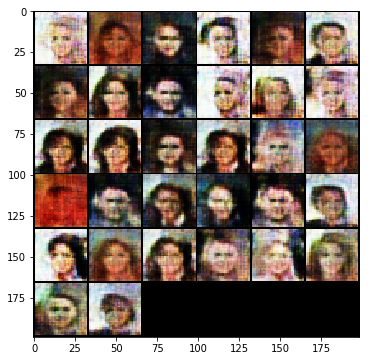

Iteration 53050: dis loss = 0.6715, gen loss = 3.1153, recon loss = 3.1153
Iteration 53100: dis loss = 0.7042, gen loss = 2.1371, recon loss = 2.1371
Iteration 53150: dis loss = 0.4789, gen loss = 2.6815, recon loss = 2.6815
Iteration 53200: dis loss = 1.2332, gen loss = 1.0644, recon loss = 1.0644
Iteration 53250: dis loss = 0.4378, gen loss = 2.4730, recon loss = 2.4730
Iteration 53300: dis loss = 1.0984, gen loss = 2.1823, recon loss = 2.1823
Iteration 53350: dis loss = 0.4625, gen loss = 2.8269, recon loss = 2.8269
Iteration 53400: dis loss = 0.8591, gen loss = 1.8782, recon loss = 1.8782
Iteration 53450: dis loss = 0.6188, gen loss = 1.7947, recon loss = 1.7947
Iteration 53500: dis loss = 0.3659, gen loss = 1.9736, recon loss = 1.9736
8 3500


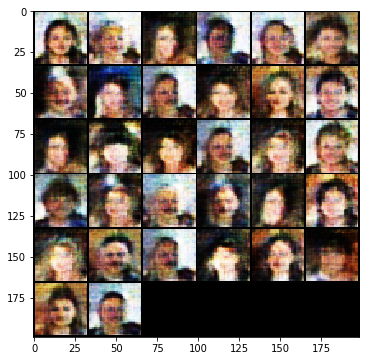

Iteration 53550: dis loss = 1.0993, gen loss = 2.5498, recon loss = 2.5498
Iteration 53600: dis loss = 0.3842, gen loss = 2.4292, recon loss = 2.4292
Iteration 53650: dis loss = 1.9056, gen loss = 2.2811, recon loss = 2.2811
Iteration 53700: dis loss = 1.4149, gen loss = 2.4024, recon loss = 2.4024
Iteration 53750: dis loss = 0.4529, gen loss = 2.0899, recon loss = 2.0899
Iteration 53800: dis loss = 0.2652, gen loss = 2.5846, recon loss = 2.5846
Iteration 53850: dis loss = 0.1969, gen loss = 3.0636, recon loss = 3.0636
Iteration 53900: dis loss = 0.1822, gen loss = 3.0221, recon loss = 3.0221
Iteration 53950: dis loss = 0.1413, gen loss = 3.7994, recon loss = 3.7994
Iteration 54000: dis loss = 0.2208, gen loss = 3.4051, recon loss = 3.4051
8 4000


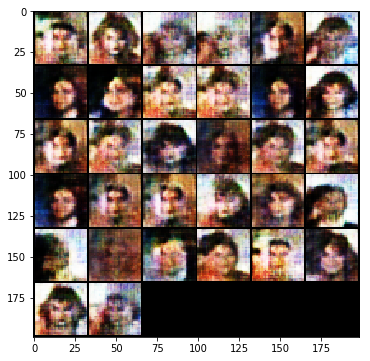

Iteration 54050: dis loss = 1.8715, gen loss = 1.4020, recon loss = 1.4020
Iteration 54100: dis loss = 0.1160, gen loss = 4.5729, recon loss = 4.5729
Iteration 54150: dis loss = 0.4647, gen loss = 3.7921, recon loss = 3.7921
Iteration 54200: dis loss = 0.7961, gen loss = 1.3714, recon loss = 1.3714
Iteration 54250: dis loss = 0.1367, gen loss = 3.8473, recon loss = 3.8473
Iteration 54300: dis loss = 0.4057, gen loss = 2.2728, recon loss = 2.2728
Iteration 54350: dis loss = 0.7105, gen loss = 3.0737, recon loss = 3.0737
Iteration 54400: dis loss = 0.5154, gen loss = 2.9618, recon loss = 2.9618
Iteration 54450: dis loss = 0.3266, gen loss = 2.7469, recon loss = 2.7469
Iteration 54500: dis loss = 0.8615, gen loss = 1.7444, recon loss = 1.7444
8 4500


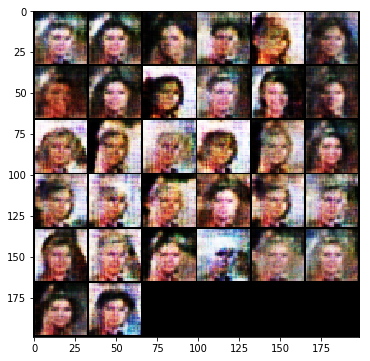

Iteration 54550: dis loss = 1.0917, gen loss = 1.0205, recon loss = 1.0205
Iteration 54600: dis loss = 0.2063, gen loss = 2.9377, recon loss = 2.9377
Iteration 54650: dis loss = 0.5469, gen loss = 2.2097, recon loss = 2.2097
Iteration 54700: dis loss = 0.1972, gen loss = 2.9809, recon loss = 2.9809
Iteration 54750: dis loss = 0.3074, gen loss = 2.8244, recon loss = 2.8244
Iteration 54800: dis loss = 0.3312, gen loss = 2.4956, recon loss = 2.4956
Iteration 54850: dis loss = 0.0825, gen loss = 3.8665, recon loss = 3.8665
Iteration 54900: dis loss = 0.2744, gen loss = 2.7456, recon loss = 2.7456
Iteration 54950: dis loss = 0.3655, gen loss = 2.2120, recon loss = 2.2120
Iteration 55000: dis loss = 0.6873, gen loss = 3.0700, recon loss = 3.0700
8 5000


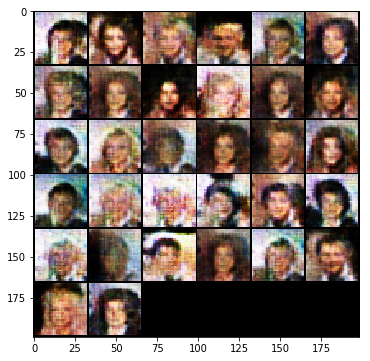

Iteration 55050: dis loss = 0.4479, gen loss = 2.2544, recon loss = 2.2544
Iteration 55100: dis loss = 0.2813, gen loss = 2.7229, recon loss = 2.7229
Iteration 55150: dis loss = 1.4124, gen loss = 2.0954, recon loss = 2.0954
Iteration 55200: dis loss = 1.1518, gen loss = 1.1496, recon loss = 1.1496
Iteration 55250: dis loss = 0.4304, gen loss = 2.0291, recon loss = 2.0291
Iteration 55300: dis loss = 0.5695, gen loss = 2.4155, recon loss = 2.4155
Iteration 55350: dis loss = 0.7900, gen loss = 2.2131, recon loss = 2.2131
Iteration 55400: dis loss = 0.2934, gen loss = 2.7558, recon loss = 2.7558
Iteration 55450: dis loss = 0.7570, gen loss = 1.4942, recon loss = 1.4942
Iteration 55500: dis loss = 0.8930, gen loss = 1.5522, recon loss = 1.5522
8 5500


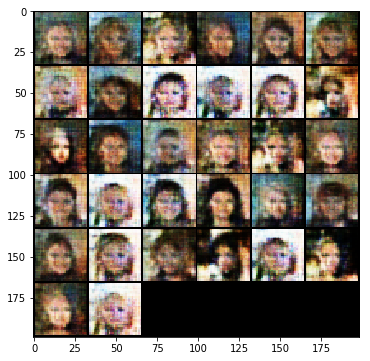

Iteration 55550: dis loss = 0.8875, gen loss = 1.8128, recon loss = 1.8128
Iteration 55600: dis loss = 0.4049, gen loss = 2.4354, recon loss = 2.4354
Iteration 55650: dis loss = 0.4601, gen loss = 3.7075, recon loss = 3.7075
Iteration 55700: dis loss = 0.8808, gen loss = 1.5561, recon loss = 1.5561
Iteration 55750: dis loss = 0.6298, gen loss = 1.8790, recon loss = 1.8790
Iteration 55800: dis loss = 0.5899, gen loss = 2.1979, recon loss = 2.1979
Iteration 55850: dis loss = 0.8790, gen loss = 1.4665, recon loss = 1.4665
Iteration 55900: dis loss = 1.0841, gen loss = 1.3068, recon loss = 1.3068
Iteration 55950: dis loss = 1.2124, gen loss = 1.7823, recon loss = 1.7823
Iteration 56000: dis loss = 0.4837, gen loss = 2.0459, recon loss = 2.0459
8 6000


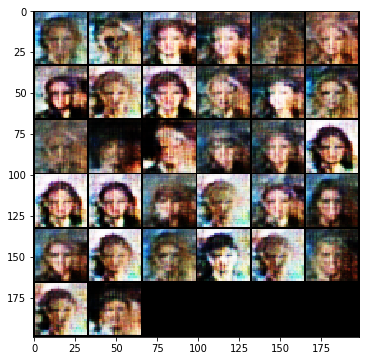

Iteration 56050: dis loss = 0.2315, gen loss = 2.9538, recon loss = 2.9538
Iteration 56100: dis loss = 0.7631, gen loss = 1.9699, recon loss = 1.9699
Iteration 56150: dis loss = 0.6599, gen loss = 2.5940, recon loss = 2.5940
Iteration 56200: dis loss = 0.5908, gen loss = 2.7873, recon loss = 2.7873
Iteration 56250: dis loss = 0.5731, gen loss = 2.6094, recon loss = 2.6094


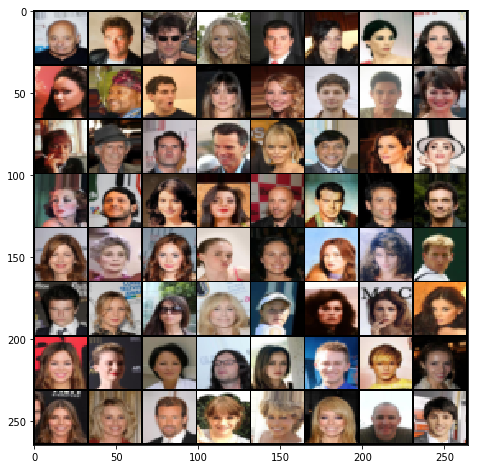

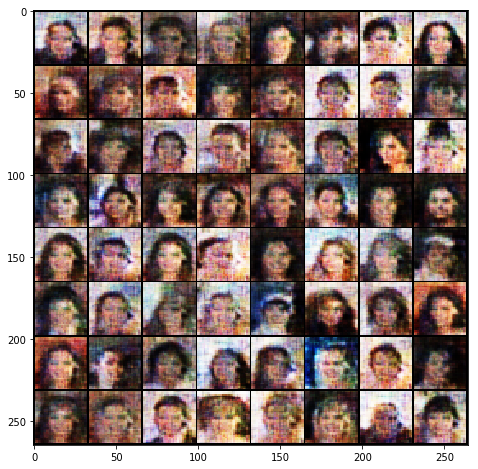

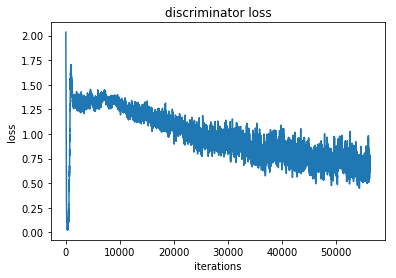

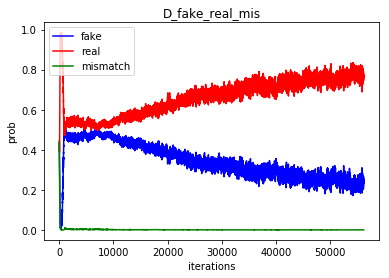

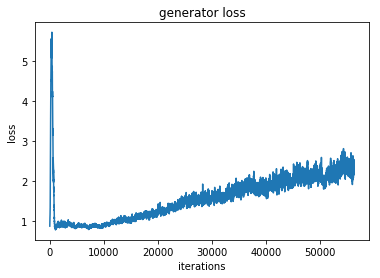

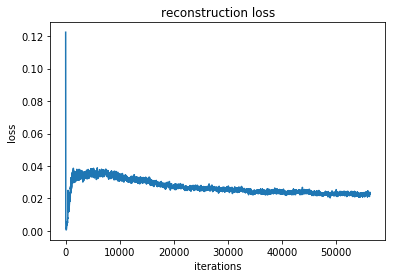

9 0


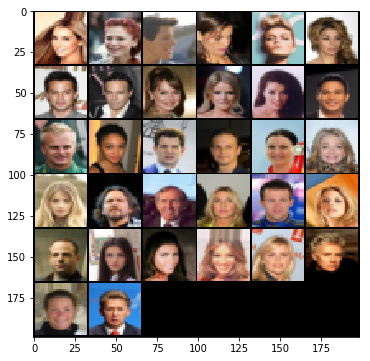

Iteration 56300: dis loss = 1.0589, gen loss = 1.4903, recon loss = 1.4903
Iteration 56350: dis loss = 0.2560, gen loss = 2.5929, recon loss = 2.5929
Iteration 56400: dis loss = 0.3365, gen loss = 2.8494, recon loss = 2.8494
Iteration 56450: dis loss = 0.2795, gen loss = 2.4562, recon loss = 2.4562
Iteration 56500: dis loss = 0.1613, gen loss = 2.9860, recon loss = 2.9860
Iteration 56550: dis loss = 1.0308, gen loss = 1.8763, recon loss = 1.8763
Iteration 56600: dis loss = 0.5811, gen loss = 2.2492, recon loss = 2.2492
Iteration 56650: dis loss = 1.2761, gen loss = 2.7256, recon loss = 2.7256
Iteration 56700: dis loss = 0.3044, gen loss = 2.6499, recon loss = 2.6499
Iteration 56750: dis loss = 0.6213, gen loss = 2.8199, recon loss = 2.8199
9 500


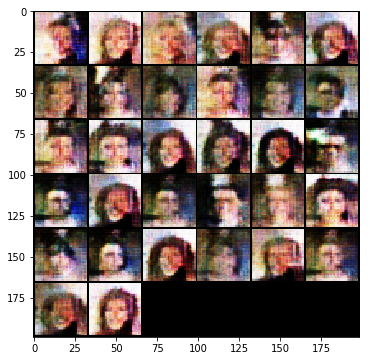

Iteration 56800: dis loss = 2.1694, gen loss = 2.2043, recon loss = 2.2043
Iteration 56850: dis loss = 0.9027, gen loss = 1.4840, recon loss = 1.4840
Iteration 56900: dis loss = 0.6587, gen loss = 3.1205, recon loss = 3.1205
Iteration 56950: dis loss = 0.2938, gen loss = 2.7692, recon loss = 2.7692
Iteration 57000: dis loss = 0.4466, gen loss = 2.2526, recon loss = 2.2526
Iteration 57050: dis loss = 0.3147, gen loss = 3.0008, recon loss = 3.0008
Iteration 57100: dis loss = 0.7560, gen loss = 2.5480, recon loss = 2.5480
Iteration 57150: dis loss = 0.4364, gen loss = 2.1284, recon loss = 2.1284
Iteration 57200: dis loss = 0.3174, gen loss = 2.6677, recon loss = 2.6677
Iteration 57250: dis loss = 0.5629, gen loss = 2.1207, recon loss = 2.1207
9 1000


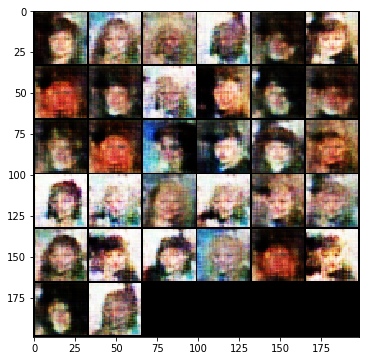

Iteration 57300: dis loss = 0.5299, gen loss = 1.8739, recon loss = 1.8739
Iteration 57350: dis loss = 0.7104, gen loss = 1.9187, recon loss = 1.9187
Iteration 57400: dis loss = 0.4405, gen loss = 2.2550, recon loss = 2.2550
Iteration 57450: dis loss = 0.8921, gen loss = 2.5604, recon loss = 2.5604
Iteration 57500: dis loss = 0.5141, gen loss = 2.7263, recon loss = 2.7263
Iteration 57550: dis loss = 0.3297, gen loss = 2.5859, recon loss = 2.5859
Iteration 57600: dis loss = 0.3332, gen loss = 2.4606, recon loss = 2.4606
Iteration 57650: dis loss = 1.1601, gen loss = 1.7412, recon loss = 1.7412
Iteration 57700: dis loss = 1.0356, gen loss = 2.2819, recon loss = 2.2819
Iteration 57750: dis loss = 0.8949, gen loss = 1.1386, recon loss = 1.1386
9 1500


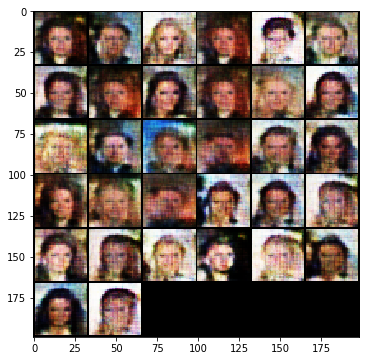

Iteration 57800: dis loss = 0.2101, gen loss = 2.9307, recon loss = 2.9307
Iteration 57850: dis loss = 0.3026, gen loss = 2.8536, recon loss = 2.8536
Iteration 57900: dis loss = 0.7328, gen loss = 1.6394, recon loss = 1.6394
Iteration 57950: dis loss = 0.3967, gen loss = 2.9046, recon loss = 2.9046
Iteration 58000: dis loss = 0.6921, gen loss = 2.5033, recon loss = 2.5033
Iteration 58050: dis loss = 0.1509, gen loss = 3.3400, recon loss = 3.3400
Iteration 58100: dis loss = 1.3731, gen loss = 2.9963, recon loss = 2.9963
Iteration 58150: dis loss = 0.5253, gen loss = 2.6824, recon loss = 2.6824
Iteration 58200: dis loss = 1.6467, gen loss = 2.0723, recon loss = 2.0723
Iteration 58250: dis loss = 1.1495, gen loss = 2.2376, recon loss = 2.2376
9 2000


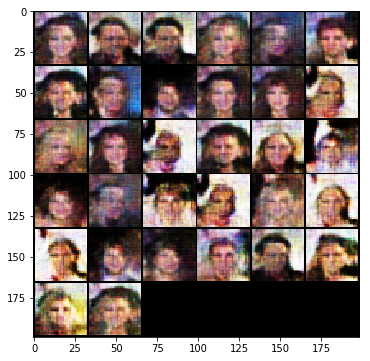

Iteration 58300: dis loss = 0.3940, gen loss = 2.2272, recon loss = 2.2272
Iteration 58350: dis loss = 0.3155, gen loss = 2.5306, recon loss = 2.5306
Iteration 58400: dis loss = 1.7556, gen loss = 0.9509, recon loss = 0.9509
Iteration 58450: dis loss = 0.2347, gen loss = 3.3729, recon loss = 3.3729
Iteration 58500: dis loss = 1.0353, gen loss = 1.8856, recon loss = 1.8856
Iteration 58550: dis loss = 0.2965, gen loss = 2.8935, recon loss = 2.8935
Iteration 58600: dis loss = 0.3578, gen loss = 2.4158, recon loss = 2.4158
Iteration 58650: dis loss = 0.5842, gen loss = 1.8998, recon loss = 1.8998
Iteration 58700: dis loss = 0.6280, gen loss = 3.1563, recon loss = 3.1563
Iteration 58750: dis loss = 0.2818, gen loss = 2.6061, recon loss = 2.6061
9 2500


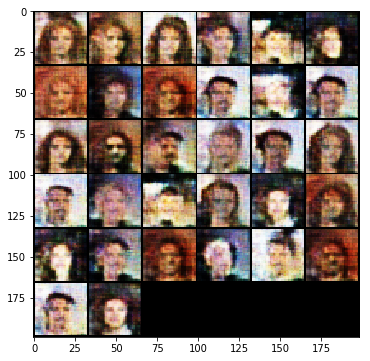

Iteration 58800: dis loss = 0.5224, gen loss = 2.3761, recon loss = 2.3761
Iteration 58850: dis loss = 0.8112, gen loss = 2.2898, recon loss = 2.2898
Iteration 58900: dis loss = 0.6532, gen loss = 2.6628, recon loss = 2.6628
Iteration 58950: dis loss = 0.1711, gen loss = 2.9997, recon loss = 2.9997
Iteration 59000: dis loss = 0.2479, gen loss = 2.8999, recon loss = 2.8999
Iteration 59050: dis loss = 0.4902, gen loss = 2.1770, recon loss = 2.1770
Iteration 59100: dis loss = 0.3779, gen loss = 2.4769, recon loss = 2.4769
Iteration 59150: dis loss = 2.3190, gen loss = 0.6456, recon loss = 0.6456
Iteration 59200: dis loss = 0.1956, gen loss = 2.8118, recon loss = 2.8118
Iteration 59250: dis loss = 0.5670, gen loss = 1.7338, recon loss = 1.7338
9 3000


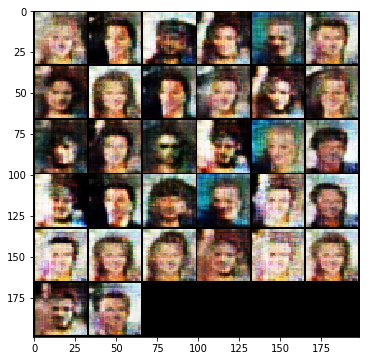

Iteration 59300: dis loss = 0.2688, gen loss = 3.0020, recon loss = 3.0020
Iteration 59350: dis loss = 0.3183, gen loss = 4.4239, recon loss = 4.4239
Iteration 59400: dis loss = 0.8008, gen loss = 2.6967, recon loss = 2.6967
Iteration 59450: dis loss = 1.5633, gen loss = 1.0624, recon loss = 1.0624
Iteration 59500: dis loss = 0.2561, gen loss = 2.9259, recon loss = 2.9259
Iteration 59550: dis loss = 0.7065, gen loss = 1.2933, recon loss = 1.2933
Iteration 59600: dis loss = 1.4381, gen loss = 3.1504, recon loss = 3.1504
Iteration 59650: dis loss = 0.4997, gen loss = 2.0207, recon loss = 2.0207
Iteration 59700: dis loss = 0.8493, gen loss = 2.2744, recon loss = 2.2744
Iteration 59750: dis loss = 0.4268, gen loss = 2.7486, recon loss = 2.7486
9 3500


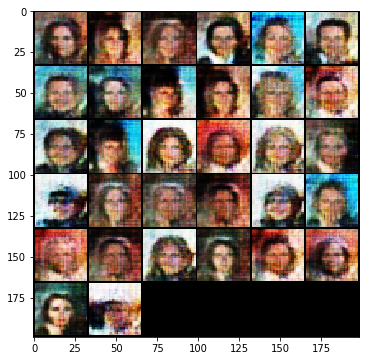

Iteration 59800: dis loss = 0.8848, gen loss = 1.5807, recon loss = 1.5807
Iteration 59850: dis loss = 0.2450, gen loss = 2.7853, recon loss = 2.7853
Iteration 59900: dis loss = 2.5907, gen loss = 3.3428, recon loss = 3.3428
Iteration 59950: dis loss = 1.8240, gen loss = 2.3622, recon loss = 2.3622
Iteration 60000: dis loss = 0.2131, gen loss = 2.8442, recon loss = 2.8442
Iteration 60050: dis loss = 0.2717, gen loss = 2.8522, recon loss = 2.8522
Iteration 60100: dis loss = 0.4633, gen loss = 1.6103, recon loss = 1.6103
Iteration 60150: dis loss = 0.4460, gen loss = 2.3726, recon loss = 2.3726
Iteration 60200: dis loss = 0.3424, gen loss = 2.5538, recon loss = 2.5538
Iteration 60250: dis loss = 0.1147, gen loss = 3.4743, recon loss = 3.4743
9 4000


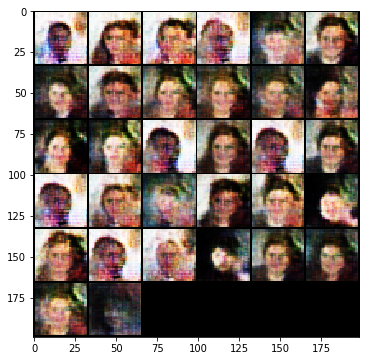

Iteration 60300: dis loss = 1.2729, gen loss = 1.2569, recon loss = 1.2569
Iteration 60350: dis loss = 0.6114, gen loss = 2.6979, recon loss = 2.6979
Iteration 60400: dis loss = 0.8921, gen loss = 1.9855, recon loss = 1.9855
Iteration 60450: dis loss = 0.6102, gen loss = 1.6007, recon loss = 1.6007
Iteration 60500: dis loss = 0.6310, gen loss = 3.2778, recon loss = 3.2778
Iteration 60550: dis loss = 0.2906, gen loss = 2.5426, recon loss = 2.5426
Iteration 60600: dis loss = 0.2949, gen loss = 3.0685, recon loss = 3.0685
Iteration 60650: dis loss = 0.4284, gen loss = 2.3521, recon loss = 2.3521
Iteration 60700: dis loss = 0.9416, gen loss = 2.5648, recon loss = 2.5648
Iteration 60750: dis loss = 0.8666, gen loss = 2.2455, recon loss = 2.2455
9 4500


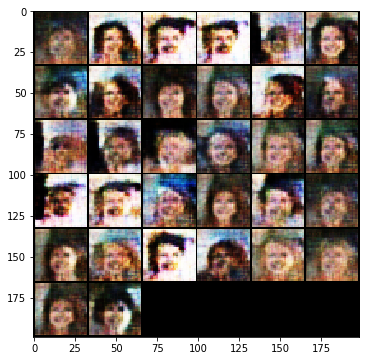

Iteration 60800: dis loss = 1.3544, gen loss = 1.4198, recon loss = 1.4198
Iteration 60850: dis loss = 0.8623, gen loss = 3.3546, recon loss = 3.3546
Iteration 60900: dis loss = 0.3874, gen loss = 2.4898, recon loss = 2.4898
Iteration 60950: dis loss = 0.2818, gen loss = 3.0207, recon loss = 3.0207
Iteration 61000: dis loss = 0.5001, gen loss = 2.7533, recon loss = 2.7533
Iteration 61050: dis loss = 0.1577, gen loss = 3.2992, recon loss = 3.2992
Iteration 61100: dis loss = 0.7411, gen loss = 3.3298, recon loss = 3.3298
Iteration 61150: dis loss = 0.4995, gen loss = 2.6523, recon loss = 2.6523
Iteration 61200: dis loss = 0.4564, gen loss = 2.9381, recon loss = 2.9381
Iteration 61250: dis loss = 0.6275, gen loss = 2.9117, recon loss = 2.9117
9 5000


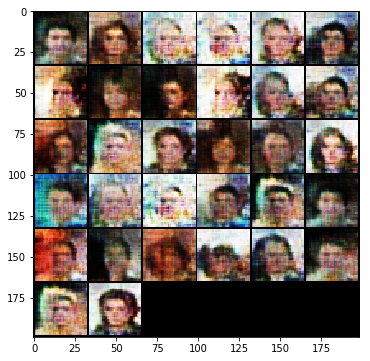

Iteration 61300: dis loss = 0.5069, gen loss = 2.7574, recon loss = 2.7574
Iteration 61350: dis loss = 0.5238, gen loss = 2.5851, recon loss = 2.5851
Iteration 61400: dis loss = 1.2028, gen loss = 2.1976, recon loss = 2.1976
Iteration 61450: dis loss = 1.1400, gen loss = 2.0614, recon loss = 2.0614
Iteration 61500: dis loss = 0.5063, gen loss = 2.0396, recon loss = 2.0396
Iteration 61550: dis loss = 0.5319, gen loss = 2.2965, recon loss = 2.2965
Iteration 61600: dis loss = 0.4823, gen loss = 2.3060, recon loss = 2.3060
Iteration 61650: dis loss = 2.5866, gen loss = 1.9004, recon loss = 1.9004
Iteration 61700: dis loss = 1.0038, gen loss = 2.0788, recon loss = 2.0788
Iteration 61750: dis loss = 0.7102, gen loss = 2.7688, recon loss = 2.7688
9 5500


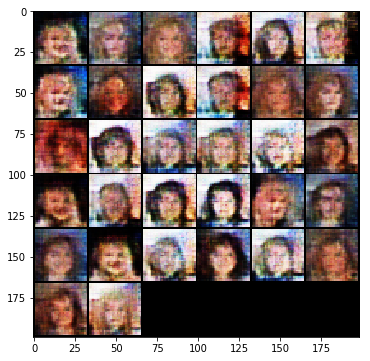

Iteration 61800: dis loss = 0.8095, gen loss = 1.7349, recon loss = 1.7349
Iteration 61850: dis loss = 0.1755, gen loss = 5.0632, recon loss = 5.0632
Iteration 61900: dis loss = 0.7777, gen loss = 1.5067, recon loss = 1.5067
Iteration 61950: dis loss = 1.2939, gen loss = 1.5109, recon loss = 1.5109
Iteration 62000: dis loss = 1.1785, gen loss = 3.5896, recon loss = 3.5896
Iteration 62050: dis loss = 0.4025, gen loss = 2.2020, recon loss = 2.2020
Iteration 62100: dis loss = 1.0995, gen loss = 1.8616, recon loss = 1.8616
Iteration 62150: dis loss = 0.7422, gen loss = 1.6222, recon loss = 1.6222
Iteration 62200: dis loss = 0.4126, gen loss = 2.1379, recon loss = 2.1379
Iteration 62250: dis loss = 0.5763, gen loss = 3.9411, recon loss = 3.9411
9 6000


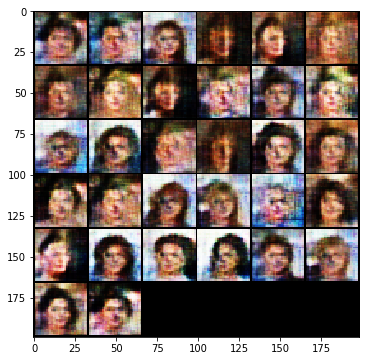

Iteration 62300: dis loss = 0.1438, gen loss = 3.0921, recon loss = 3.0921
Iteration 62350: dis loss = 2.1713, gen loss = 1.8298, recon loss = 1.8298
Iteration 62400: dis loss = 0.2625, gen loss = 2.8032, recon loss = 2.8032
Iteration 62450: dis loss = 0.4725, gen loss = 4.9237, recon loss = 4.9237
Iteration 62500: dis loss = 1.4461, gen loss = 2.6804, recon loss = 2.6804


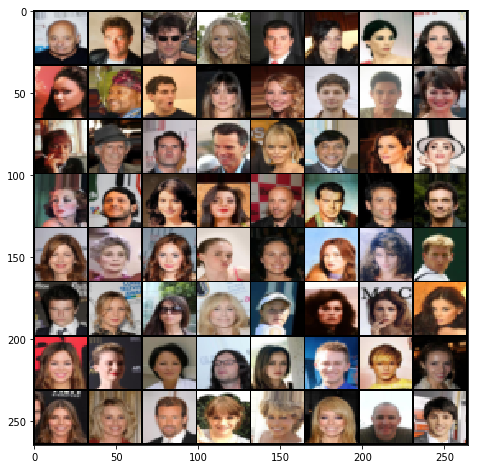

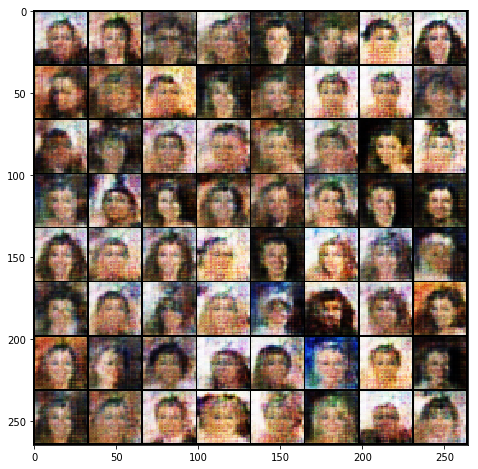

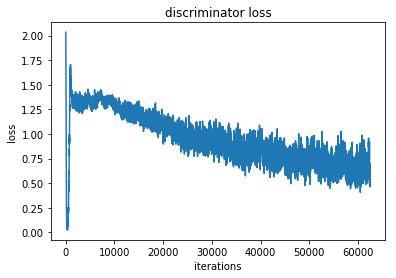

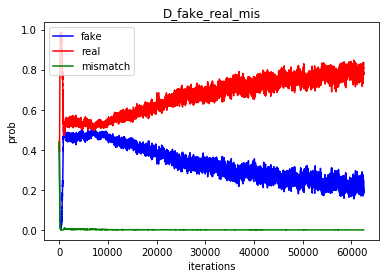

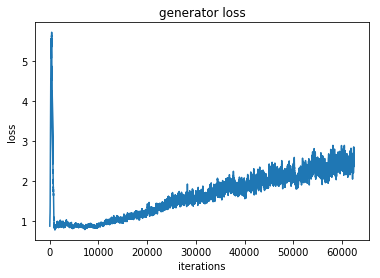

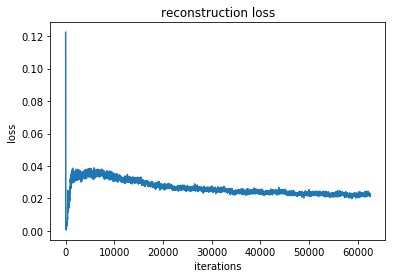

10 0


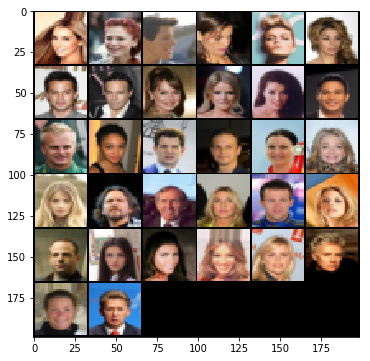

Iteration 62550: dis loss = 0.8287, gen loss = 1.9308, recon loss = 1.9308
Iteration 62600: dis loss = 0.3021, gen loss = 2.7528, recon loss = 2.7528
Iteration 62650: dis loss = 0.2004, gen loss = 2.9093, recon loss = 2.9093
Iteration 62700: dis loss = 0.1691, gen loss = 3.5652, recon loss = 3.5652
Iteration 62750: dis loss = 0.1879, gen loss = 3.9315, recon loss = 3.9315
Iteration 62800: dis loss = 1.3643, gen loss = 2.1140, recon loss = 2.1140
Iteration 62850: dis loss = 0.5571, gen loss = 2.0495, recon loss = 2.0495
Iteration 62900: dis loss = 0.4105, gen loss = 2.2112, recon loss = 2.2112
Iteration 62950: dis loss = 0.2874, gen loss = 2.6718, recon loss = 2.6718
Iteration 63000: dis loss = 0.4774, gen loss = 3.0049, recon loss = 3.0049
10 500


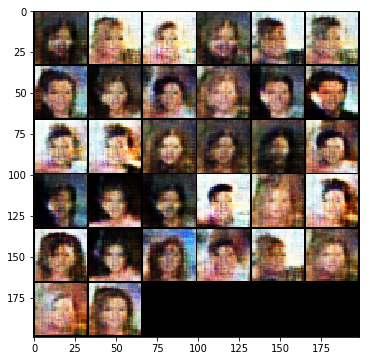

Iteration 63050: dis loss = 0.6242, gen loss = 1.7121, recon loss = 1.7121
Iteration 63100: dis loss = 0.5387, gen loss = 2.2975, recon loss = 2.2975
Iteration 63150: dis loss = 0.6635, gen loss = 2.6899, recon loss = 2.6899
Iteration 63200: dis loss = 0.2924, gen loss = 2.8404, recon loss = 2.8404
Iteration 63250: dis loss = 0.3921, gen loss = 2.6176, recon loss = 2.6176
Iteration 63300: dis loss = 0.3973, gen loss = 2.6020, recon loss = 2.6020
Iteration 63350: dis loss = 0.6127, gen loss = 1.7971, recon loss = 1.7971
Iteration 63400: dis loss = 0.3005, gen loss = 2.5275, recon loss = 2.5275
Iteration 63450: dis loss = 0.4438, gen loss = 2.9177, recon loss = 2.9177
Iteration 63500: dis loss = 0.8066, gen loss = 1.7133, recon loss = 1.7133
10 1000


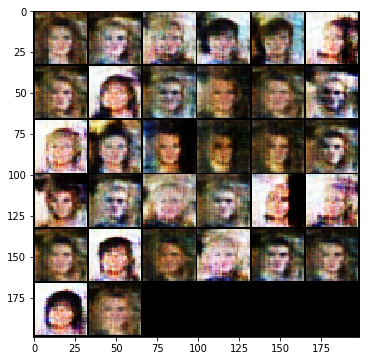

Iteration 63550: dis loss = 0.8766, gen loss = 2.2839, recon loss = 2.2839
Iteration 63600: dis loss = 0.8807, gen loss = 1.3588, recon loss = 1.3588
Iteration 63650: dis loss = 1.2886, gen loss = 2.2420, recon loss = 2.2420
Iteration 63700: dis loss = 0.8736, gen loss = 1.2488, recon loss = 1.2488
Iteration 63750: dis loss = 0.5004, gen loss = 2.8332, recon loss = 2.8332
Iteration 63800: dis loss = 0.2524, gen loss = 2.7585, recon loss = 2.7585
Iteration 63850: dis loss = 0.2907, gen loss = 2.7867, recon loss = 2.7867
Iteration 63900: dis loss = 0.8751, gen loss = 1.9993, recon loss = 1.9993
Iteration 63950: dis loss = 0.5918, gen loss = 1.6756, recon loss = 1.6756
Iteration 64000: dis loss = 0.5540, gen loss = 1.9428, recon loss = 1.9428
10 1500


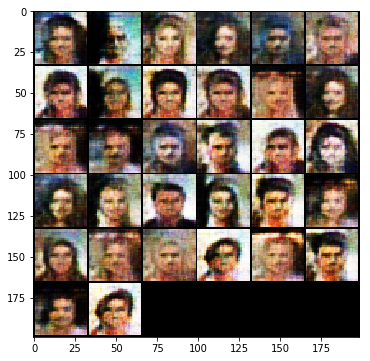

Iteration 64050: dis loss = 1.4925, gen loss = 2.8313, recon loss = 2.8313
Iteration 64100: dis loss = 0.3575, gen loss = 2.3255, recon loss = 2.3255
Iteration 64150: dis loss = 0.8939, gen loss = 1.9424, recon loss = 1.9424
Iteration 64200: dis loss = 0.7733, gen loss = 3.3315, recon loss = 3.3315
Iteration 64250: dis loss = 0.4256, gen loss = 2.0803, recon loss = 2.0803
Iteration 64300: dis loss = 0.1046, gen loss = 3.5100, recon loss = 3.5100
Iteration 64350: dis loss = 0.5491, gen loss = 2.4334, recon loss = 2.4334
Iteration 64400: dis loss = 0.2197, gen loss = 3.0800, recon loss = 3.0800
Iteration 64450: dis loss = 1.3090, gen loss = 0.7332, recon loss = 0.7332
Iteration 64500: dis loss = 0.8588, gen loss = 2.5495, recon loss = 2.5495
10 2000


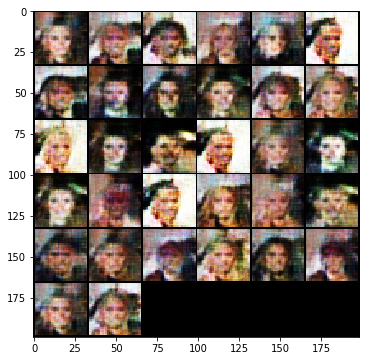

Iteration 64550: dis loss = 0.3105, gen loss = 2.4860, recon loss = 2.4860
Iteration 64600: dis loss = 0.6021, gen loss = 2.6084, recon loss = 2.6084
Iteration 64650: dis loss = 1.3493, gen loss = 1.2554, recon loss = 1.2554
Iteration 64700: dis loss = 1.0126, gen loss = 2.8360, recon loss = 2.8360
Iteration 64750: dis loss = 1.1647, gen loss = 2.3969, recon loss = 2.3969
Iteration 64800: dis loss = 0.4027, gen loss = 3.0877, recon loss = 3.0877
Iteration 64850: dis loss = 0.1338, gen loss = 3.3774, recon loss = 3.3774
Iteration 64900: dis loss = 0.4242, gen loss = 2.7066, recon loss = 2.7066
Iteration 64950: dis loss = 1.2895, gen loss = 2.8741, recon loss = 2.8741
Iteration 65000: dis loss = 0.6672, gen loss = 2.1330, recon loss = 2.1330
10 2500


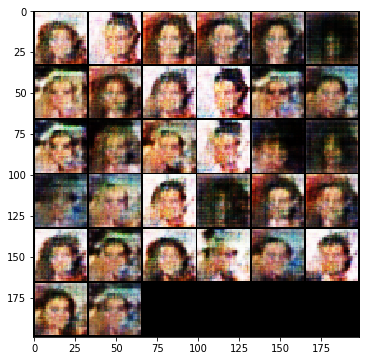

Iteration 65050: dis loss = 0.9843, gen loss = 2.6923, recon loss = 2.6923
Iteration 65100: dis loss = 0.3514, gen loss = 3.8795, recon loss = 3.8795
Iteration 65150: dis loss = 1.5898, gen loss = 2.1683, recon loss = 2.1683
Iteration 65200: dis loss = 0.3560, gen loss = 2.8637, recon loss = 2.8637
Iteration 65250: dis loss = 0.1629, gen loss = 3.2079, recon loss = 3.2079
Iteration 65300: dis loss = 0.2921, gen loss = 2.7044, recon loss = 2.7044
Iteration 65350: dis loss = 0.5107, gen loss = 1.9279, recon loss = 1.9279
Iteration 65400: dis loss = 1.8664, gen loss = 0.6140, recon loss = 0.6140
Iteration 65450: dis loss = 0.6030, gen loss = 2.9109, recon loss = 2.9109
Iteration 65500: dis loss = 0.0954, gen loss = 3.6494, recon loss = 3.6494
10 3000


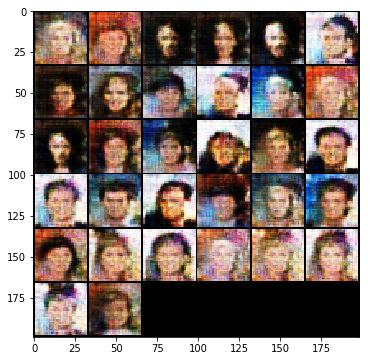

Iteration 65550: dis loss = 0.1999, gen loss = 3.0693, recon loss = 3.0693
Iteration 65600: dis loss = 0.4876, gen loss = 2.3573, recon loss = 2.3573
Iteration 65650: dis loss = 0.8299, gen loss = 2.5996, recon loss = 2.5996
Iteration 65700: dis loss = 1.2263, gen loss = 0.9725, recon loss = 0.9725
Iteration 65750: dis loss = 0.2483, gen loss = 3.5936, recon loss = 3.5936
Iteration 65800: dis loss = 0.9455, gen loss = 1.6173, recon loss = 1.6173
Iteration 65850: dis loss = 0.6450, gen loss = 2.3615, recon loss = 2.3615
Iteration 65900: dis loss = 0.9840, gen loss = 2.9003, recon loss = 2.9003
Iteration 65950: dis loss = 0.5387, gen loss = 2.1484, recon loss = 2.1484
Iteration 66000: dis loss = 0.4869, gen loss = 3.2094, recon loss = 3.2094
10 3500


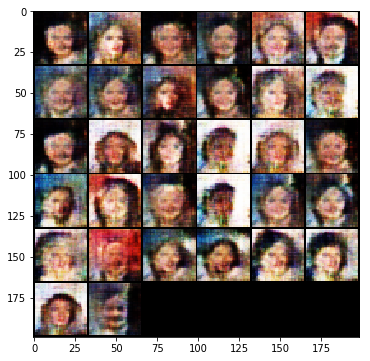

Iteration 66050: dis loss = 1.1062, gen loss = 1.3383, recon loss = 1.3383
Iteration 66100: dis loss = 0.5117, gen loss = 2.9169, recon loss = 2.9169
Iteration 66150: dis loss = 2.5448, gen loss = 2.6843, recon loss = 2.6843
Iteration 66200: dis loss = 0.7918, gen loss = 2.5756, recon loss = 2.5756
Iteration 66250: dis loss = 0.7859, gen loss = 1.7530, recon loss = 1.7530
Iteration 66300: dis loss = 1.1969, gen loss = 2.6867, recon loss = 2.6867
Iteration 66350: dis loss = 0.5104, gen loss = 2.8349, recon loss = 2.8349
Iteration 66400: dis loss = 0.2340, gen loss = 3.3718, recon loss = 3.3718
Iteration 66450: dis loss = 0.6158, gen loss = 2.0620, recon loss = 2.0620
Iteration 66500: dis loss = 0.2413, gen loss = 3.2058, recon loss = 3.2058
10 4000


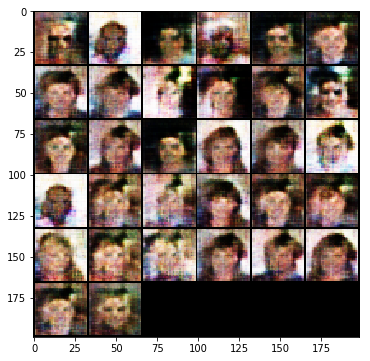

Iteration 66550: dis loss = 2.3920, gen loss = 1.2670, recon loss = 1.2670
Iteration 66600: dis loss = 0.2378, gen loss = 3.9444, recon loss = 3.9444
Iteration 66650: dis loss = 0.2901, gen loss = 2.8010, recon loss = 2.8010
Iteration 66700: dis loss = 0.9766, gen loss = 1.3483, recon loss = 1.3483
Iteration 66750: dis loss = 0.1490, gen loss = 3.1002, recon loss = 3.1002
Iteration 66800: dis loss = 1.0701, gen loss = 1.8564, recon loss = 1.8564
Iteration 66850: dis loss = 0.1939, gen loss = 3.1067, recon loss = 3.1067
Iteration 66900: dis loss = 0.8956, gen loss = 1.5836, recon loss = 1.5836
Iteration 66950: dis loss = 0.5563, gen loss = 2.6157, recon loss = 2.6157
Iteration 67000: dis loss = 1.3537, gen loss = 1.2484, recon loss = 1.2484
10 4500


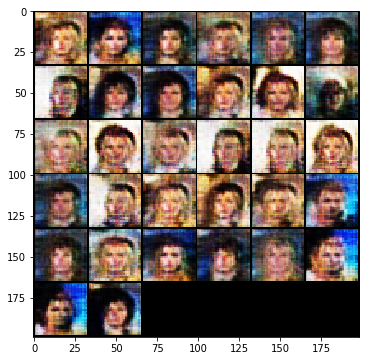

Iteration 67050: dis loss = 1.4439, gen loss = 1.2174, recon loss = 1.2174
Iteration 67100: dis loss = 0.8335, gen loss = 3.0197, recon loss = 3.0197
Iteration 67150: dis loss = 0.1951, gen loss = 3.0381, recon loss = 3.0381
Iteration 67200: dis loss = 0.6894, gen loss = 2.6199, recon loss = 2.6199
Iteration 67250: dis loss = 0.2608, gen loss = 2.7708, recon loss = 2.7708
Iteration 67300: dis loss = 0.3668, gen loss = 2.4784, recon loss = 2.4784
Iteration 67350: dis loss = 0.2738, gen loss = 3.1852, recon loss = 3.1852
Iteration 67400: dis loss = 0.1923, gen loss = 3.0152, recon loss = 3.0152
Iteration 67450: dis loss = 0.3661, gen loss = 2.1456, recon loss = 2.1456
Iteration 67500: dis loss = 0.1510, gen loss = 3.0668, recon loss = 3.0668
10 5000


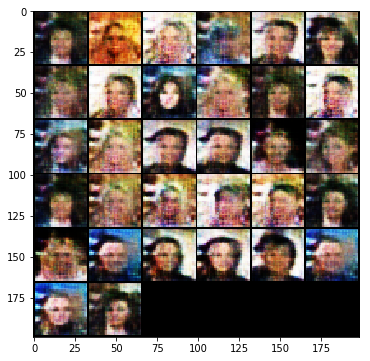

Iteration 67550: dis loss = 0.7338, gen loss = 1.4248, recon loss = 1.4248
Iteration 67600: dis loss = 0.1834, gen loss = 3.2026, recon loss = 3.2026
Iteration 67650: dis loss = 1.0542, gen loss = 2.0808, recon loss = 2.0808
Iteration 67700: dis loss = 0.3421, gen loss = 2.4065, recon loss = 2.4065
Iteration 67750: dis loss = 0.7305, gen loss = 1.1682, recon loss = 1.1682
Iteration 67800: dis loss = 0.8889, gen loss = 1.7043, recon loss = 1.7043
Iteration 67850: dis loss = 1.2788, gen loss = 2.2944, recon loss = 2.2944
Iteration 67900: dis loss = 1.2423, gen loss = 2.6343, recon loss = 2.6343
Iteration 67950: dis loss = 0.7306, gen loss = 1.6564, recon loss = 1.6564
Iteration 68000: dis loss = 0.7448, gen loss = 2.2186, recon loss = 2.2186
10 5500


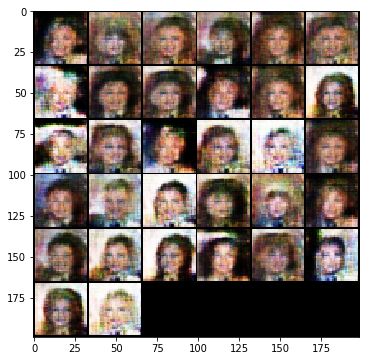

Iteration 68050: dis loss = 1.3681, gen loss = 2.2656, recon loss = 2.2656
Iteration 68100: dis loss = 0.2610, gen loss = 3.0850, recon loss = 3.0850
Iteration 68150: dis loss = 0.7858, gen loss = 2.1132, recon loss = 2.1132
Iteration 68200: dis loss = 1.8640, gen loss = 0.6896, recon loss = 0.6896
Iteration 68250: dis loss = 0.4724, gen loss = 2.2099, recon loss = 2.2099
Iteration 68300: dis loss = 0.6602, gen loss = 1.9487, recon loss = 1.9487
Iteration 68350: dis loss = 0.7186, gen loss = 2.1857, recon loss = 2.1857
Iteration 68400: dis loss = 1.1850, gen loss = 1.3450, recon loss = 1.3450
Iteration 68450: dis loss = 0.6674, gen loss = 2.0832, recon loss = 2.0832
Iteration 68500: dis loss = 0.5265, gen loss = 3.0373, recon loss = 3.0373
10 6000


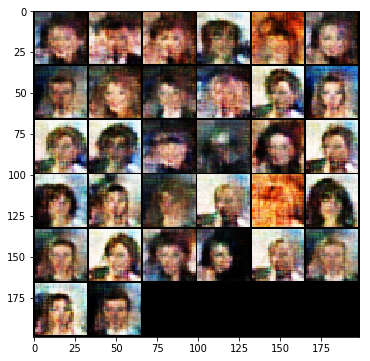

Iteration 68550: dis loss = 0.4333, gen loss = 3.3570, recon loss = 3.3570
Iteration 68600: dis loss = 0.9532, gen loss = 2.4000, recon loss = 2.4000
Iteration 68650: dis loss = 0.2709, gen loss = 2.5934, recon loss = 2.5934
Iteration 68700: dis loss = 0.3752, gen loss = 2.4524, recon loss = 2.4524
Iteration 68750: dis loss = 0.3461, gen loss = 2.7397, recon loss = 2.7397


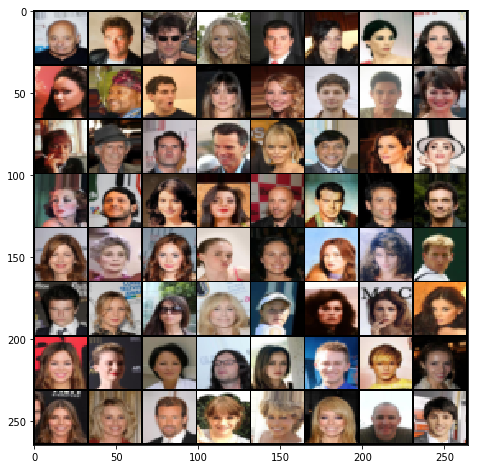

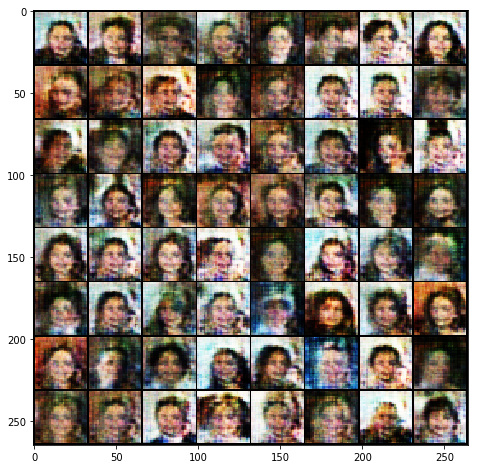

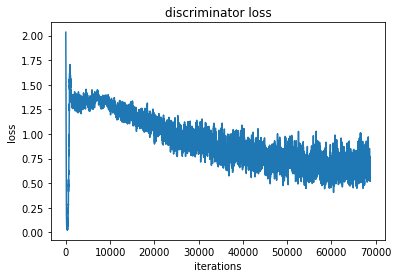

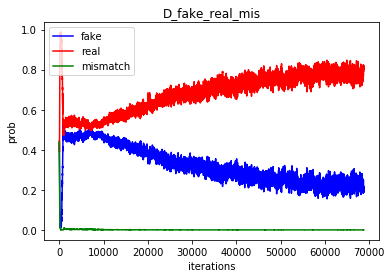

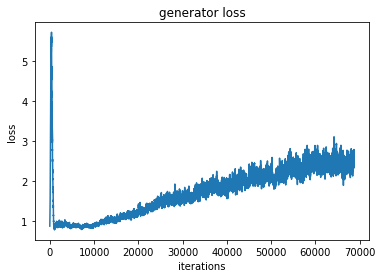

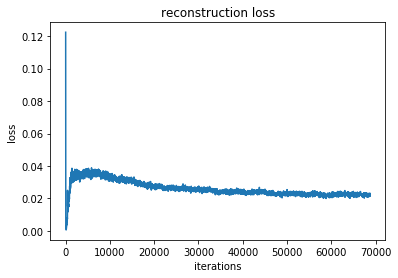

11 0


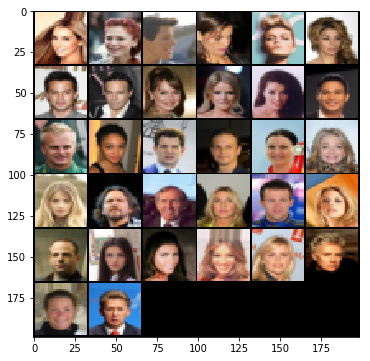

Iteration 68800: dis loss = 1.2402, gen loss = 2.5007, recon loss = 2.5007
Iteration 68850: dis loss = 0.6075, gen loss = 2.7934, recon loss = 2.7934
Iteration 68900: dis loss = 0.4786, gen loss = 1.8481, recon loss = 1.8481
Iteration 68950: dis loss = 0.1425, gen loss = 4.2292, recon loss = 4.2292
Iteration 69000: dis loss = 0.2848, gen loss = 3.4396, recon loss = 3.4396
Iteration 69050: dis loss = 2.1084, gen loss = 1.9484, recon loss = 1.9484
Iteration 69100: dis loss = 0.7180, gen loss = 1.9002, recon loss = 1.9002
Iteration 69150: dis loss = 1.2730, gen loss = 2.3508, recon loss = 2.3508
Iteration 69200: dis loss = 0.5936, gen loss = 2.4223, recon loss = 2.4223
Iteration 69250: dis loss = 0.3242, gen loss = 3.2546, recon loss = 3.2546
11 500


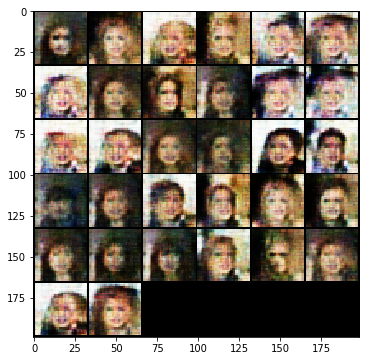

Iteration 69300: dis loss = 1.3109, gen loss = 1.7018, recon loss = 1.7018
Iteration 69350: dis loss = 0.8223, gen loss = 2.1367, recon loss = 2.1367
Iteration 69400: dis loss = 0.3464, gen loss = 2.8125, recon loss = 2.8125
Iteration 69450: dis loss = 0.2324, gen loss = 2.7636, recon loss = 2.7636
Iteration 69500: dis loss = 0.4055, gen loss = 2.6166, recon loss = 2.6166
Iteration 69550: dis loss = 0.1072, gen loss = 3.6802, recon loss = 3.6802
Iteration 69600: dis loss = 0.5135, gen loss = 1.8412, recon loss = 1.8412
Iteration 69650: dis loss = 0.4470, gen loss = 2.1626, recon loss = 2.1626
Iteration 69700: dis loss = 0.1753, gen loss = 3.7060, recon loss = 3.7060
Iteration 69750: dis loss = 0.9232, gen loss = 2.5886, recon loss = 2.5886
11 1000


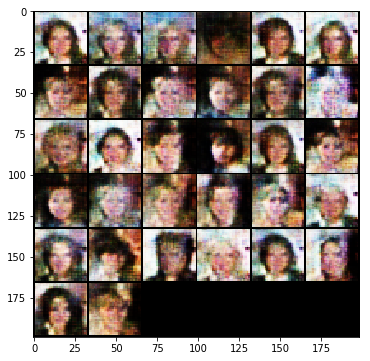

Iteration 69800: dis loss = 0.6333, gen loss = 1.6961, recon loss = 1.6961
Iteration 69850: dis loss = 0.4672, gen loss = 2.1415, recon loss = 2.1415
Iteration 69900: dis loss = 0.6423, gen loss = 1.7498, recon loss = 1.7498
Iteration 69950: dis loss = 0.7675, gen loss = 2.5044, recon loss = 2.5044
Iteration 70000: dis loss = 0.3711, gen loss = 2.3443, recon loss = 2.3443
Iteration 70050: dis loss = 0.4086, gen loss = 3.0918, recon loss = 3.0918
Iteration 70100: dis loss = 0.2733, gen loss = 2.6247, recon loss = 2.6247
Iteration 70150: dis loss = 0.7131, gen loss = 1.6657, recon loss = 1.6657
Iteration 70200: dis loss = 0.5150, gen loss = 2.9403, recon loss = 2.9403
Iteration 70250: dis loss = 1.0628, gen loss = 2.2962, recon loss = 2.2962
11 1500


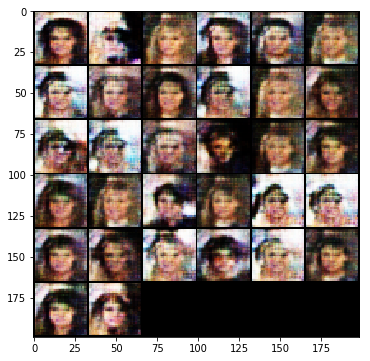

Iteration 70300: dis loss = 0.3475, gen loss = 2.9152, recon loss = 2.9152
Iteration 70350: dis loss = 0.5611, gen loss = 2.4009, recon loss = 2.4009
Iteration 70400: dis loss = 1.0053, gen loss = 3.4127, recon loss = 3.4127
Iteration 70450: dis loss = 0.8504, gen loss = 3.4568, recon loss = 3.4568
Iteration 70500: dis loss = 0.5102, gen loss = 2.4599, recon loss = 2.4599
Iteration 70550: dis loss = 0.2288, gen loss = 3.3211, recon loss = 3.3211
Iteration 70600: dis loss = 0.5338, gen loss = 2.4156, recon loss = 2.4156
Iteration 70650: dis loss = 0.2182, gen loss = 2.7994, recon loss = 2.7994
Iteration 70700: dis loss = 1.1974, gen loss = 1.0790, recon loss = 1.0790
Iteration 70750: dis loss = 0.5964, gen loss = 2.7250, recon loss = 2.7250
11 2000


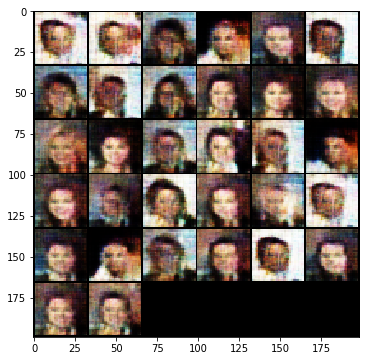

Iteration 70800: dis loss = 0.3672, gen loss = 2.2818, recon loss = 2.2818
Iteration 70850: dis loss = 0.2792, gen loss = 2.5777, recon loss = 2.5777
Iteration 70900: dis loss = 1.1405, gen loss = 1.3404, recon loss = 1.3404
Iteration 70950: dis loss = 0.5011, gen loss = 3.3120, recon loss = 3.3120
Iteration 71000: dis loss = 1.9648, gen loss = 2.6839, recon loss = 2.6839
Iteration 71050: dis loss = 0.0699, gen loss = 3.5565, recon loss = 3.5565
Iteration 71100: dis loss = 0.1595, gen loss = 4.2831, recon loss = 4.2831
Iteration 71150: dis loss = 0.4039, gen loss = 2.8724, recon loss = 2.8724
Iteration 71200: dis loss = 0.3320, gen loss = 2.9112, recon loss = 2.9112
Iteration 71250: dis loss = 0.2481, gen loss = 3.4688, recon loss = 3.4688
11 2500


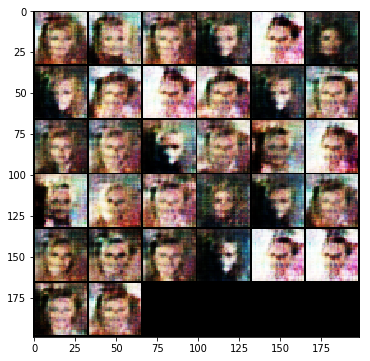

Iteration 71300: dis loss = 0.8349, gen loss = 3.6535, recon loss = 3.6535
Iteration 71350: dis loss = 0.6842, gen loss = 2.8631, recon loss = 2.8631
Iteration 71400: dis loss = 0.4873, gen loss = 2.8994, recon loss = 2.8994
Iteration 71450: dis loss = 0.1141, gen loss = 3.3838, recon loss = 3.3838
Iteration 71500: dis loss = 0.0553, gen loss = 3.6867, recon loss = 3.6867
Iteration 71550: dis loss = 0.4257, gen loss = 2.7355, recon loss = 2.7355
Iteration 71600: dis loss = 0.3180, gen loss = 2.4975, recon loss = 2.4975
Iteration 71650: dis loss = 2.0335, gen loss = 0.5599, recon loss = 0.5599
Iteration 71700: dis loss = 1.2130, gen loss = 2.4428, recon loss = 2.4428
Iteration 71750: dis loss = 0.1380, gen loss = 3.4349, recon loss = 3.4349
11 3000


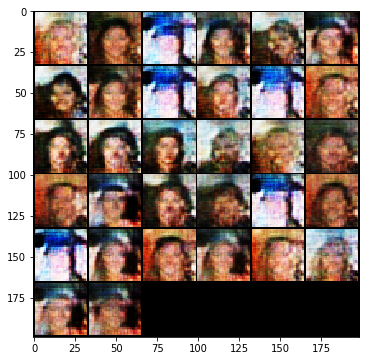

Iteration 71800: dis loss = 0.1917, gen loss = 3.0557, recon loss = 3.0557
Iteration 71850: dis loss = 0.6384, gen loss = 1.7383, recon loss = 1.7383
Iteration 71900: dis loss = 1.0373, gen loss = 2.6187, recon loss = 2.6187
Iteration 71950: dis loss = 2.0190, gen loss = 0.6784, recon loss = 0.6784
Iteration 72000: dis loss = 0.6162, gen loss = 3.2453, recon loss = 3.2453
Iteration 72050: dis loss = 0.6386, gen loss = 2.9124, recon loss = 2.9124
Iteration 72100: dis loss = 1.2087, gen loss = 2.2274, recon loss = 2.2274
Iteration 72150: dis loss = 0.6287, gen loss = 2.7946, recon loss = 2.7946
Iteration 72200: dis loss = 1.1703, gen loss = 2.9204, recon loss = 2.9204
Iteration 72250: dis loss = 0.3078, gen loss = 4.1759, recon loss = 4.1759
11 3500


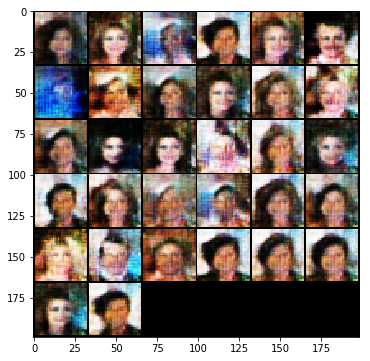

Iteration 72300: dis loss = 0.4275, gen loss = 2.2726, recon loss = 2.2726
Iteration 72350: dis loss = 0.3284, gen loss = 2.3560, recon loss = 2.3560
Iteration 72400: dis loss = 3.6594, gen loss = 4.0067, recon loss = 4.0067
Iteration 72450: dis loss = 0.7043, gen loss = 3.2379, recon loss = 3.2379
Iteration 72500: dis loss = 0.8830, gen loss = 2.9592, recon loss = 2.9592
Iteration 72550: dis loss = 0.6401, gen loss = 3.0553, recon loss = 3.0553
Iteration 72600: dis loss = 0.4440, gen loss = 2.9818, recon loss = 2.9818
Iteration 72650: dis loss = 0.3260, gen loss = 2.5054, recon loss = 2.5054
Iteration 72700: dis loss = 0.1526, gen loss = 3.1741, recon loss = 3.1741
Iteration 72750: dis loss = 0.1427, gen loss = 3.5154, recon loss = 3.5154
11 4000


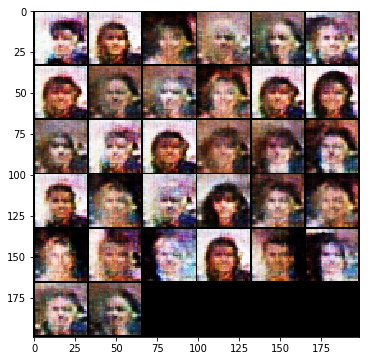

Iteration 72800: dis loss = 2.1344, gen loss = 1.5602, recon loss = 1.5602
Iteration 72850: dis loss = 0.3027, gen loss = 3.7077, recon loss = 3.7077
Iteration 72900: dis loss = 0.3777, gen loss = 2.3091, recon loss = 2.3091
Iteration 72950: dis loss = 0.4537, gen loss = 2.8484, recon loss = 2.8484
Iteration 73000: dis loss = 0.4296, gen loss = 2.7652, recon loss = 2.7652
Iteration 73050: dis loss = 0.4704, gen loss = 2.3276, recon loss = 2.3276
Iteration 73100: dis loss = 0.2573, gen loss = 2.7561, recon loss = 2.7561
Iteration 73150: dis loss = 0.5270, gen loss = 2.1128, recon loss = 2.1128
Iteration 73200: dis loss = 0.8122, gen loss = 3.3789, recon loss = 3.3789
Iteration 73250: dis loss = 1.0464, gen loss = 2.2628, recon loss = 2.2628
11 4500


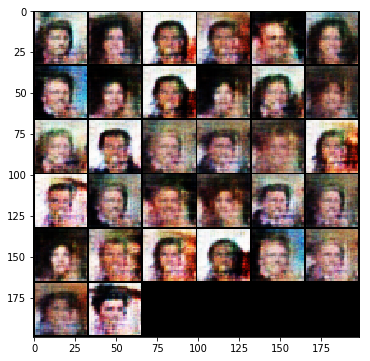

Iteration 73300: dis loss = 1.9374, gen loss = 2.0054, recon loss = 2.0054
Iteration 73350: dis loss = 0.2572, gen loss = 2.5342, recon loss = 2.5342
Iteration 73400: dis loss = 0.3854, gen loss = 2.3204, recon loss = 2.3204
Iteration 73450: dis loss = 0.3087, gen loss = 3.0660, recon loss = 3.0660
Iteration 73500: dis loss = 0.2977, gen loss = 2.8645, recon loss = 2.8645
Iteration 73550: dis loss = 0.2561, gen loss = 3.4156, recon loss = 3.4156
Iteration 73600: dis loss = 0.2712, gen loss = 2.8674, recon loss = 2.8674
Iteration 73650: dis loss = 0.2634, gen loss = 3.6819, recon loss = 3.6819
Iteration 73700: dis loss = 0.5541, gen loss = 2.4179, recon loss = 2.4179
Iteration 73750: dis loss = 0.4868, gen loss = 3.0452, recon loss = 3.0452
11 5000


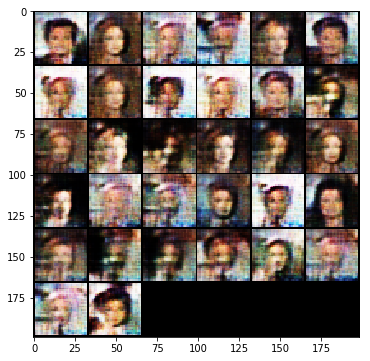

Iteration 73800: dis loss = 0.4279, gen loss = 2.7787, recon loss = 2.7787
Iteration 73850: dis loss = 0.2414, gen loss = 3.0918, recon loss = 3.0918
Iteration 73900: dis loss = 2.5020, gen loss = 1.6539, recon loss = 1.6539
Iteration 73950: dis loss = 0.7576, gen loss = 1.7895, recon loss = 1.7895
Iteration 74000: dis loss = 0.3378, gen loss = 4.1183, recon loss = 4.1183
Iteration 74050: dis loss = 0.4424, gen loss = 2.4358, recon loss = 2.4358
Iteration 74100: dis loss = 0.5964, gen loss = 2.5313, recon loss = 2.5313
Iteration 74150: dis loss = 0.6522, gen loss = 2.3850, recon loss = 2.3850
Iteration 74200: dis loss = 0.9625, gen loss = 1.4278, recon loss = 1.4278
Iteration 74250: dis loss = 1.0082, gen loss = 1.2499, recon loss = 1.2499
11 5500


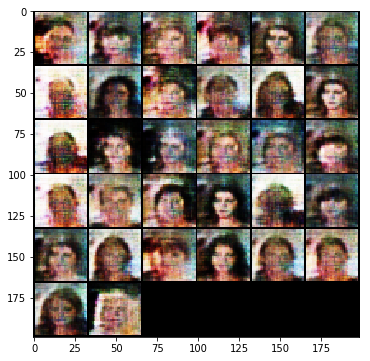

Iteration 74300: dis loss = 1.9728, gen loss = 1.7621, recon loss = 1.7621
Iteration 74350: dis loss = 0.3023, gen loss = 2.4916, recon loss = 2.4916
Iteration 74400: dis loss = 0.9579, gen loss = 1.3104, recon loss = 1.3104
Iteration 74450: dis loss = 1.2488, gen loss = 1.3898, recon loss = 1.3898
Iteration 74500: dis loss = 0.8688, gen loss = 2.3530, recon loss = 2.3530
Iteration 74550: dis loss = 0.6178, gen loss = 2.5572, recon loss = 2.5572
Iteration 74600: dis loss = 0.6279, gen loss = 2.1919, recon loss = 2.1919
Iteration 74650: dis loss = 1.1817, gen loss = 2.2409, recon loss = 2.2409
Iteration 74700: dis loss = 0.6992, gen loss = 1.8609, recon loss = 1.8609
Iteration 74750: dis loss = 0.5406, gen loss = 3.4952, recon loss = 3.4952
11 6000


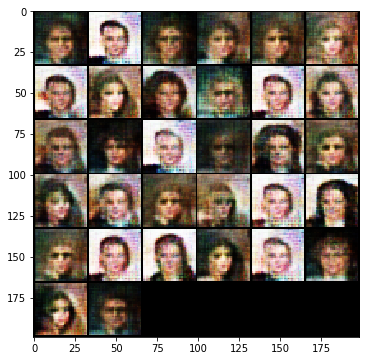

Iteration 74800: dis loss = 0.2871, gen loss = 2.7279, recon loss = 2.7279
Iteration 74850: dis loss = 1.0470, gen loss = 2.4064, recon loss = 2.4064
Iteration 74900: dis loss = 0.8650, gen loss = 2.5520, recon loss = 2.5520
Iteration 74950: dis loss = 0.3869, gen loss = 3.4578, recon loss = 3.4578
Iteration 75000: dis loss = 0.5455, gen loss = 3.3201, recon loss = 3.3201


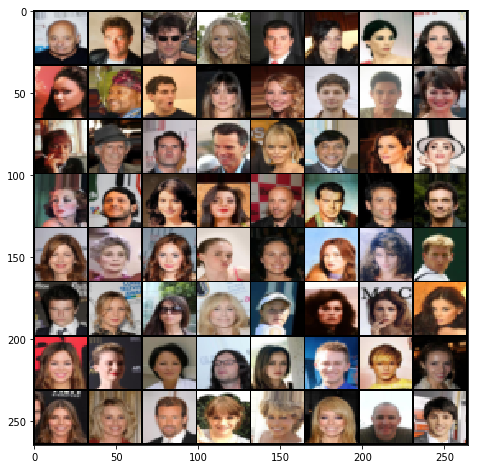

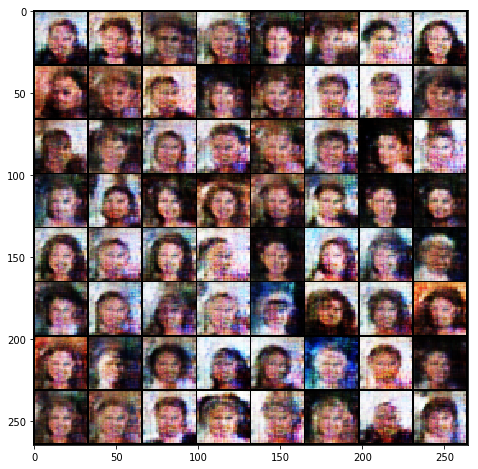

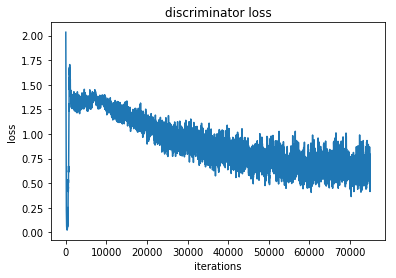

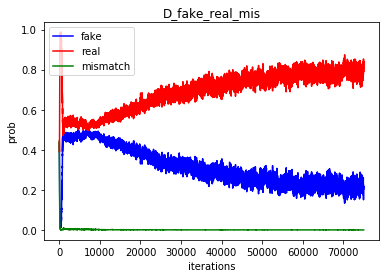

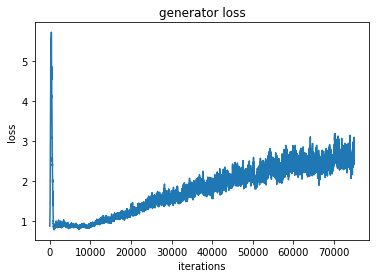

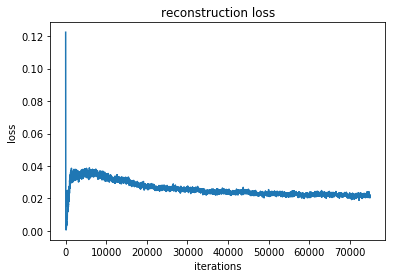

12 0


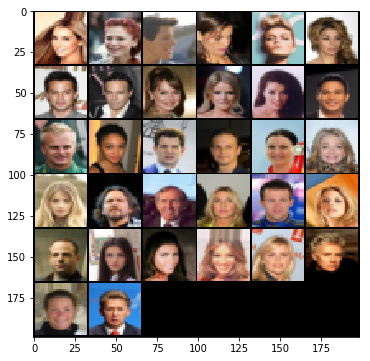

Iteration 75050: dis loss = 1.1330, gen loss = 1.0279, recon loss = 1.0279
Iteration 75100: dis loss = 0.2919, gen loss = 3.3011, recon loss = 3.3011
Iteration 75150: dis loss = 0.5156, gen loss = 2.1105, recon loss = 2.1105
Iteration 75200: dis loss = 0.1104, gen loss = 4.9390, recon loss = 4.9390
Iteration 75250: dis loss = 0.1853, gen loss = 3.1439, recon loss = 3.1439
Iteration 75300: dis loss = 2.2459, gen loss = 1.5888, recon loss = 1.5888
Iteration 75350: dis loss = 0.3644, gen loss = 2.6424, recon loss = 2.6424
Iteration 75400: dis loss = 0.6273, gen loss = 2.9998, recon loss = 2.9998
Iteration 75450: dis loss = 0.9227, gen loss = 3.1173, recon loss = 3.1173
Iteration 75500: dis loss = 0.1779, gen loss = 3.2268, recon loss = 3.2268
12 500


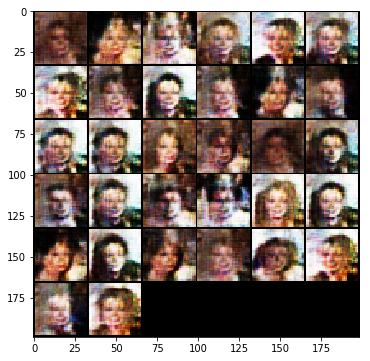

Iteration 75550: dis loss = 0.6755, gen loss = 2.2281, recon loss = 2.2281
Iteration 75600: dis loss = 0.7134, gen loss = 1.5355, recon loss = 1.5355
Iteration 75650: dis loss = 0.1532, gen loss = 3.3351, recon loss = 3.3351
Iteration 75700: dis loss = 0.5690, gen loss = 2.2638, recon loss = 2.2638
Iteration 75750: dis loss = 0.2980, gen loss = 2.8927, recon loss = 2.8927
Iteration 75800: dis loss = 0.2564, gen loss = 2.8419, recon loss = 2.8419
Iteration 75850: dis loss = 1.1305, gen loss = 2.0872, recon loss = 2.0872
Iteration 75900: dis loss = 0.1793, gen loss = 5.1087, recon loss = 5.1087
Iteration 75950: dis loss = 0.2135, gen loss = 3.1902, recon loss = 3.1902
Iteration 76000: dis loss = 0.9533, gen loss = 2.0989, recon loss = 2.0989
12 1000


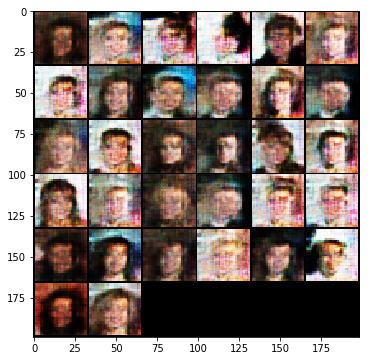

Iteration 76050: dis loss = 0.5453, gen loss = 2.1203, recon loss = 2.1203
Iteration 76100: dis loss = 1.6550, gen loss = 3.2136, recon loss = 3.2136
Iteration 76150: dis loss = 0.6092, gen loss = 2.0443, recon loss = 2.0443
Iteration 76200: dis loss = 0.5243, gen loss = 1.9336, recon loss = 1.9336
Iteration 76250: dis loss = 0.8256, gen loss = 3.2055, recon loss = 3.2055
Iteration 76300: dis loss = 0.1125, gen loss = 3.8554, recon loss = 3.8554
Iteration 76350: dis loss = 0.4556, gen loss = 2.0509, recon loss = 2.0509
Iteration 76400: dis loss = 0.9118, gen loss = 1.9618, recon loss = 1.9618
Iteration 76450: dis loss = 0.6270, gen loss = 1.9797, recon loss = 1.9797
Iteration 76500: dis loss = 0.8831, gen loss = 2.0899, recon loss = 2.0899
12 1500


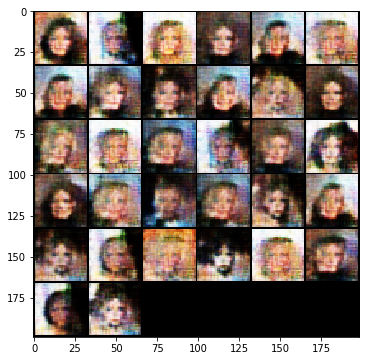

Iteration 76550: dis loss = 0.9693, gen loss = 2.4889, recon loss = 2.4889
Iteration 76600: dis loss = 0.1841, gen loss = 5.2340, recon loss = 5.2340
Iteration 76650: dis loss = 0.5712, gen loss = 3.1806, recon loss = 3.1806
Iteration 76700: dis loss = 1.0676, gen loss = 2.6344, recon loss = 2.6344
Iteration 76750: dis loss = 0.4143, gen loss = 2.8000, recon loss = 2.8000
Iteration 76800: dis loss = 0.1026, gen loss = 4.3153, recon loss = 4.3153
Iteration 76850: dis loss = 1.2033, gen loss = 3.1507, recon loss = 3.1507
Iteration 76900: dis loss = 0.3271, gen loss = 2.6252, recon loss = 2.6252
Iteration 76950: dis loss = 1.5340, gen loss = 0.8930, recon loss = 0.8930
Iteration 77000: dis loss = 0.5779, gen loss = 2.5743, recon loss = 2.5743
12 2000


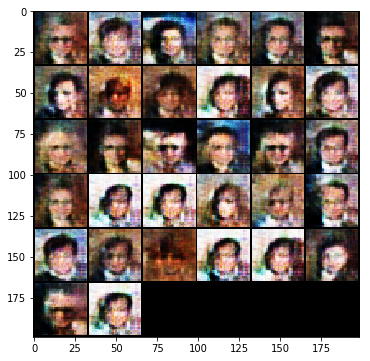

Iteration 77050: dis loss = 0.6997, gen loss = 2.5160, recon loss = 2.5160
Iteration 77100: dis loss = 0.6120, gen loss = 3.0065, recon loss = 3.0065
Iteration 77150: dis loss = 1.4170, gen loss = 0.8673, recon loss = 0.8673
Iteration 77200: dis loss = 0.2852, gen loss = 3.6806, recon loss = 3.6806
Iteration 77250: dis loss = 1.0400, gen loss = 2.4241, recon loss = 2.4241
Iteration 77300: dis loss = 0.2302, gen loss = 3.0825, recon loss = 3.0825
Iteration 77350: dis loss = 0.1567, gen loss = 3.1008, recon loss = 3.1008
Iteration 77400: dis loss = 0.7744, gen loss = 2.6894, recon loss = 2.6894
Iteration 77450: dis loss = 0.3102, gen loss = 2.5580, recon loss = 2.5580
Iteration 77500: dis loss = 0.4199, gen loss = 2.7923, recon loss = 2.7923
12 2500


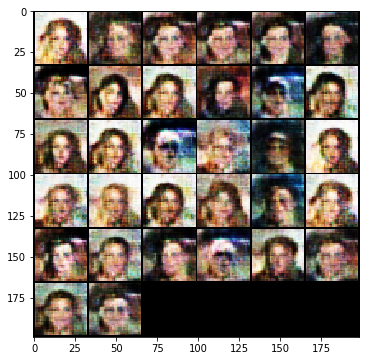

Iteration 77550: dis loss = 0.6720, gen loss = 2.4115, recon loss = 2.4115
Iteration 77600: dis loss = 0.3877, gen loss = 2.2604, recon loss = 2.2604
Iteration 77650: dis loss = 0.8663, gen loss = 3.1786, recon loss = 3.1786
Iteration 77700: dis loss = 0.1410, gen loss = 3.3521, recon loss = 3.3521
Iteration 77750: dis loss = 0.0864, gen loss = 4.6873, recon loss = 4.6873
Iteration 77800: dis loss = 0.2490, gen loss = 2.7816, recon loss = 2.7816
Iteration 77850: dis loss = 0.6354, gen loss = 2.3167, recon loss = 2.3167
Iteration 77900: dis loss = 1.7473, gen loss = 0.6488, recon loss = 0.6488
Iteration 77950: dis loss = 0.3036, gen loss = 3.2198, recon loss = 3.2198
Iteration 78000: dis loss = 0.1086, gen loss = 3.5535, recon loss = 3.5535
12 3000


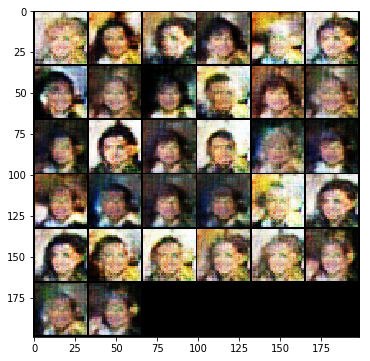

Iteration 78050: dis loss = 0.4433, gen loss = 3.0550, recon loss = 3.0550
Iteration 78100: dis loss = 0.6104, gen loss = 3.9892, recon loss = 3.9892
Iteration 78150: dis loss = 0.8437, gen loss = 2.9099, recon loss = 2.9099
Iteration 78200: dis loss = 2.7177, gen loss = 0.7527, recon loss = 0.7527
Iteration 78250: dis loss = 0.2155, gen loss = 3.9387, recon loss = 3.9387
Iteration 78300: dis loss = 1.2534, gen loss = 1.1215, recon loss = 1.1215
Iteration 78350: dis loss = 0.7069, gen loss = 2.5526, recon loss = 2.5526
Iteration 78400: dis loss = 0.6022, gen loss = 2.4087, recon loss = 2.4087
Iteration 78450: dis loss = 1.1097, gen loss = 3.0078, recon loss = 3.0078
Iteration 78500: dis loss = 0.7304, gen loss = 2.0545, recon loss = 2.0545
12 3500


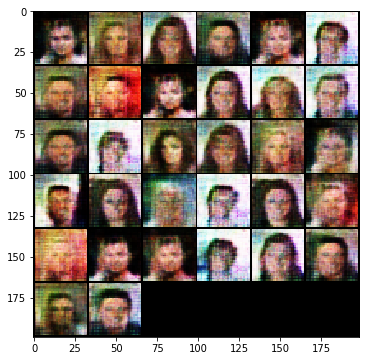

Iteration 78550: dis loss = 0.5144, gen loss = 2.1485, recon loss = 2.1485
Iteration 78600: dis loss = 0.3595, gen loss = 2.7392, recon loss = 2.7392
Iteration 78650: dis loss = 3.5753, gen loss = 4.1987, recon loss = 4.1987
Iteration 78700: dis loss = 0.6067, gen loss = 3.2711, recon loss = 3.2711
Iteration 78750: dis loss = 0.4301, gen loss = 2.2476, recon loss = 2.2476
Iteration 78800: dis loss = 0.5115, gen loss = 3.4364, recon loss = 3.4364
Iteration 78850: dis loss = 0.0969, gen loss = 3.6844, recon loss = 3.6844
Iteration 78900: dis loss = 0.1251, gen loss = 3.7261, recon loss = 3.7261
Iteration 78950: dis loss = 0.4052, gen loss = 2.1938, recon loss = 2.1938
Iteration 79000: dis loss = 0.2876, gen loss = 2.5302, recon loss = 2.5302
12 4000


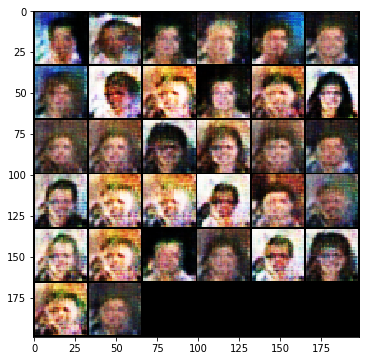

Iteration 79050: dis loss = 1.1764, gen loss = 1.2425, recon loss = 1.2425
Iteration 79100: dis loss = 0.2522, gen loss = 3.5398, recon loss = 3.5398
Iteration 79150: dis loss = 0.8931, gen loss = 1.5991, recon loss = 1.5991
Iteration 79200: dis loss = 0.6846, gen loss = 1.5817, recon loss = 1.5817
Iteration 79250: dis loss = 0.6824, gen loss = 3.3729, recon loss = 3.3729
Iteration 79300: dis loss = 0.2260, gen loss = 4.0546, recon loss = 4.0546
Iteration 79350: dis loss = 0.4896, gen loss = 2.7395, recon loss = 2.7395
Iteration 79400: dis loss = 0.7107, gen loss = 2.3423, recon loss = 2.3423
Iteration 79450: dis loss = 0.5430, gen loss = 2.8847, recon loss = 2.8847
Iteration 79500: dis loss = 0.9522, gen loss = 1.2570, recon loss = 1.2570
12 4500


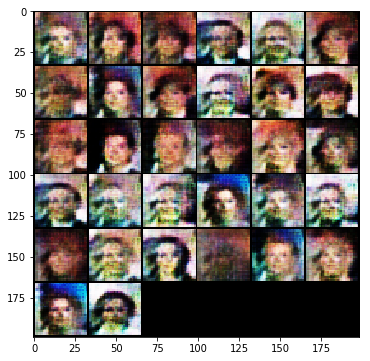

Iteration 79550: dis loss = 1.3567, gen loss = 1.0329, recon loss = 1.0329
Iteration 79600: dis loss = 0.3667, gen loss = 2.7262, recon loss = 2.7262
Iteration 79650: dis loss = 0.4339, gen loss = 3.0516, recon loss = 3.0516
Iteration 79700: dis loss = 0.2213, gen loss = 3.0148, recon loss = 3.0148
Iteration 79750: dis loss = 0.8110, gen loss = 2.6140, recon loss = 2.6140
Iteration 79800: dis loss = 0.1259, gen loss = 3.4566, recon loss = 3.4566
Iteration 79850: dis loss = 0.3866, gen loss = 2.6092, recon loss = 2.6092
Iteration 79900: dis loss = 0.2284, gen loss = 3.4616, recon loss = 3.4616
Iteration 79950: dis loss = 0.3359, gen loss = 4.2435, recon loss = 4.2435
Iteration 80000: dis loss = 0.3019, gen loss = 2.7618, recon loss = 2.7618
12 5000


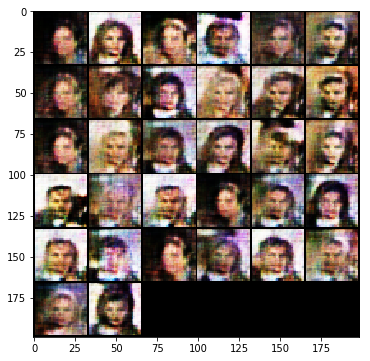

Iteration 80050: dis loss = 0.5987, gen loss = 2.1343, recon loss = 2.1343
Iteration 80100: dis loss = 0.2713, gen loss = 3.1866, recon loss = 3.1866
Iteration 80150: dis loss = 1.0717, gen loss = 2.2921, recon loss = 2.2921
Iteration 80200: dis loss = 0.6484, gen loss = 1.7490, recon loss = 1.7490
Iteration 80250: dis loss = 0.3952, gen loss = 2.7950, recon loss = 2.7950
Iteration 80300: dis loss = 0.5666, gen loss = 2.0264, recon loss = 2.0264
Iteration 80350: dis loss = 0.7633, gen loss = 1.6864, recon loss = 1.6864
Iteration 80400: dis loss = 1.1750, gen loss = 3.3775, recon loss = 3.3775
Iteration 80450: dis loss = 1.0256, gen loss = 3.0072, recon loss = 3.0072
Iteration 80500: dis loss = 1.3160, gen loss = 1.8019, recon loss = 1.8019
12 5500


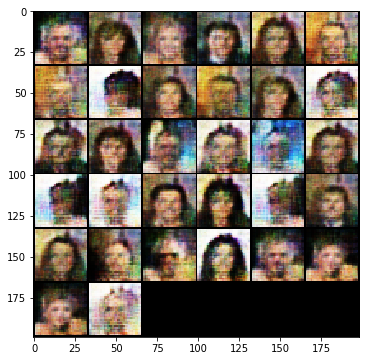

Iteration 80550: dis loss = 0.9303, gen loss = 1.5010, recon loss = 1.5010
Iteration 80600: dis loss = 0.1724, gen loss = 3.0676, recon loss = 3.0676
Iteration 80650: dis loss = 0.9790, gen loss = 1.9362, recon loss = 1.9362
Iteration 80700: dis loss = 1.2624, gen loss = 1.2536, recon loss = 1.2536
Iteration 80750: dis loss = 0.8858, gen loss = 2.4698, recon loss = 2.4698
Iteration 80800: dis loss = 0.7656, gen loss = 2.5073, recon loss = 2.5073
Iteration 80850: dis loss = 0.2179, gen loss = 3.3386, recon loss = 3.3386
Iteration 80900: dis loss = 1.1124, gen loss = 1.3863, recon loss = 1.3863
Iteration 80950: dis loss = 0.5175, gen loss = 2.2892, recon loss = 2.2892
Iteration 81000: dis loss = 0.3160, gen loss = 3.3358, recon loss = 3.3358
12 6000


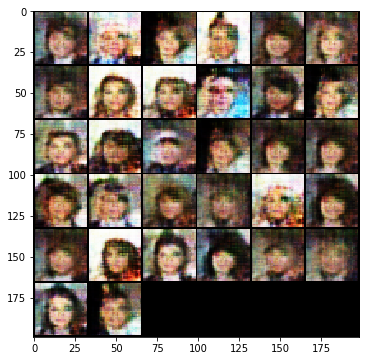

Iteration 81050: dis loss = 0.1561, gen loss = 4.0538, recon loss = 4.0538
Iteration 81100: dis loss = 0.4195, gen loss = 2.4049, recon loss = 2.4049
Iteration 81150: dis loss = 0.5203, gen loss = 2.7160, recon loss = 2.7160
Iteration 81200: dis loss = 0.5641, gen loss = 2.4319, recon loss = 2.4319
Iteration 81250: dis loss = 0.3342, gen loss = 3.0025, recon loss = 3.0025


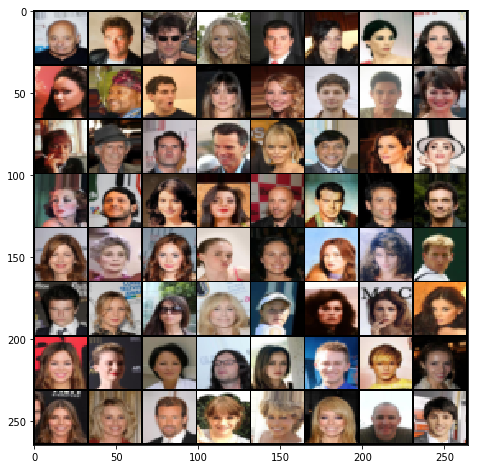

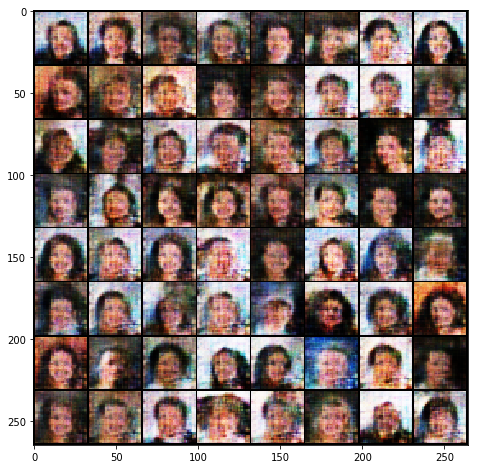

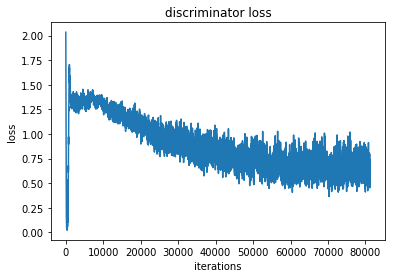

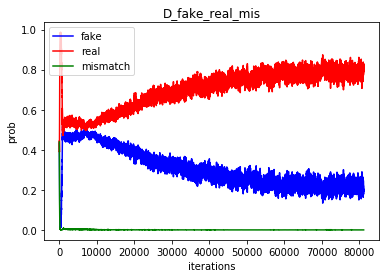

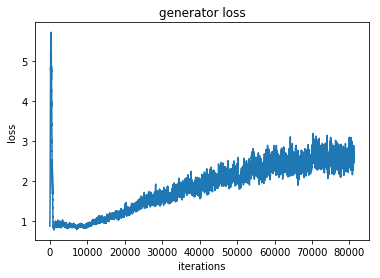

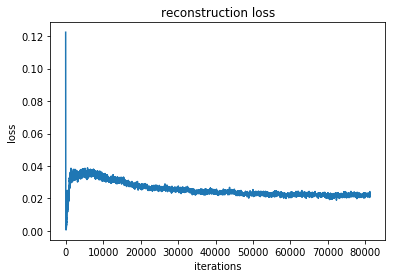

13 0


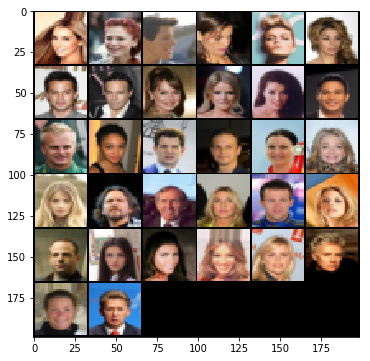

Iteration 81300: dis loss = 2.0147, gen loss = 1.4252, recon loss = 1.4252
Iteration 81350: dis loss = 1.8329, gen loss = 2.8915, recon loss = 2.8915
Iteration 81400: dis loss = 0.5732, gen loss = 2.5469, recon loss = 2.5469
Iteration 81450: dis loss = 0.1934, gen loss = 2.9649, recon loss = 2.9649
Iteration 81500: dis loss = 0.4793, gen loss = 2.5651, recon loss = 2.5651
Iteration 81550: dis loss = 1.8190, gen loss = 1.7216, recon loss = 1.7216
Iteration 81600: dis loss = 0.8582, gen loss = 2.3213, recon loss = 2.3213
Iteration 81650: dis loss = 0.4579, gen loss = 2.8621, recon loss = 2.8621
Iteration 81700: dis loss = 0.2718, gen loss = 2.8653, recon loss = 2.8653
Iteration 81750: dis loss = 1.0646, gen loss = 2.9914, recon loss = 2.9914
13 500


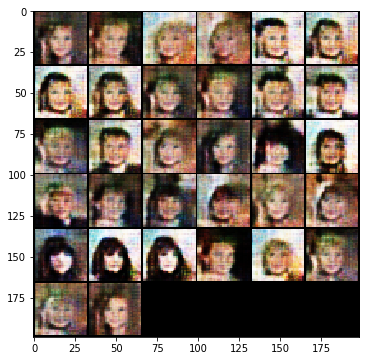

Iteration 81800: dis loss = 0.9112, gen loss = 2.3041, recon loss = 2.3041
Iteration 81850: dis loss = 0.7299, gen loss = 1.9717, recon loss = 1.9717
Iteration 81900: dis loss = 0.3889, gen loss = 2.8502, recon loss = 2.8502
Iteration 81950: dis loss = 0.1338, gen loss = 3.4148, recon loss = 3.4148
Iteration 82000: dis loss = 0.8367, gen loss = 1.9722, recon loss = 1.9722
Iteration 82050: dis loss = 0.1505, gen loss = 2.9998, recon loss = 2.9998
Iteration 82100: dis loss = 0.6403, gen loss = 2.2444, recon loss = 2.2444
Iteration 82150: dis loss = 0.1449, gen loss = 3.3684, recon loss = 3.3684
Iteration 82200: dis loss = 0.3189, gen loss = 3.4138, recon loss = 3.4138
Iteration 82250: dis loss = 0.4025, gen loss = 1.9810, recon loss = 1.9810
13 1000


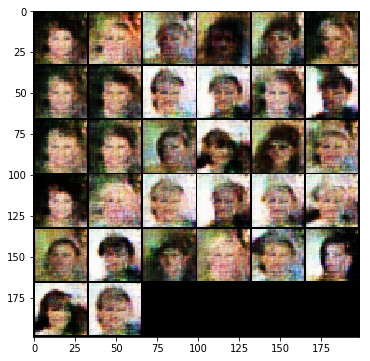

Iteration 82300: dis loss = 0.5359, gen loss = 2.6840, recon loss = 2.6840
Iteration 82350: dis loss = 0.5640, gen loss = 1.9786, recon loss = 1.9786
Iteration 82400: dis loss = 0.9289, gen loss = 1.5049, recon loss = 1.5049
Iteration 82450: dis loss = 0.5541, gen loss = 2.1118, recon loss = 2.1118
Iteration 82500: dis loss = 0.3258, gen loss = 2.6096, recon loss = 2.6096
Iteration 82550: dis loss = 0.3487, gen loss = 2.6704, recon loss = 2.6704
Iteration 82600: dis loss = 0.3218, gen loss = 2.2974, recon loss = 2.2974
Iteration 82650: dis loss = 0.6219, gen loss = 1.8742, recon loss = 1.8742
Iteration 82700: dis loss = 0.8915, gen loss = 1.4527, recon loss = 1.4527
Iteration 82750: dis loss = 0.9260, gen loss = 1.2229, recon loss = 1.2229
13 1500


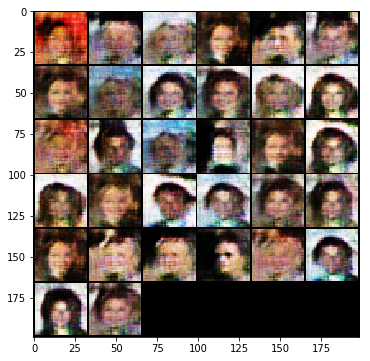

Iteration 82800: dis loss = 0.6441, gen loss = 2.6738, recon loss = 2.6738
Iteration 82850: dis loss = 0.3346, gen loss = 2.7613, recon loss = 2.7613
Iteration 82900: dis loss = 0.3042, gen loss = 2.7138, recon loss = 2.7138
Iteration 82950: dis loss = 0.3737, gen loss = 3.5081, recon loss = 3.5081
Iteration 83000: dis loss = 0.2015, gen loss = 3.0603, recon loss = 3.0603
Iteration 83050: dis loss = 0.6304, gen loss = 3.0019, recon loss = 3.0019
Iteration 83100: dis loss = 0.7987, gen loss = 3.4266, recon loss = 3.4266
Iteration 83150: dis loss = 0.2889, gen loss = 2.7384, recon loss = 2.7384
Iteration 83200: dis loss = 1.1559, gen loss = 0.7732, recon loss = 0.7732
Iteration 83250: dis loss = 0.9088, gen loss = 2.5465, recon loss = 2.5465
13 2000


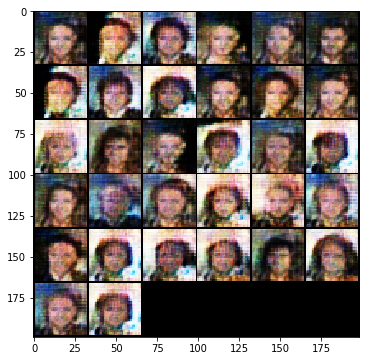

Iteration 83300: dis loss = 1.9012, gen loss = 2.2957, recon loss = 2.2957
Iteration 83350: dis loss = 1.8975, gen loss = 2.8767, recon loss = 2.8767
Iteration 83400: dis loss = 1.2860, gen loss = 1.0907, recon loss = 1.0907
Iteration 83450: dis loss = 0.6044, gen loss = 2.5991, recon loss = 2.5991
Iteration 83500: dis loss = 0.6790, gen loss = 2.3586, recon loss = 2.3586
Iteration 83550: dis loss = 0.2067, gen loss = 2.8256, recon loss = 2.8256
Iteration 83600: dis loss = 0.2388, gen loss = 3.5076, recon loss = 3.5076
Iteration 83650: dis loss = 0.5197, gen loss = 2.3387, recon loss = 2.3387
Iteration 83700: dis loss = 0.4490, gen loss = 3.0547, recon loss = 3.0547
Iteration 83750: dis loss = 0.5773, gen loss = 2.4326, recon loss = 2.4326
13 2500


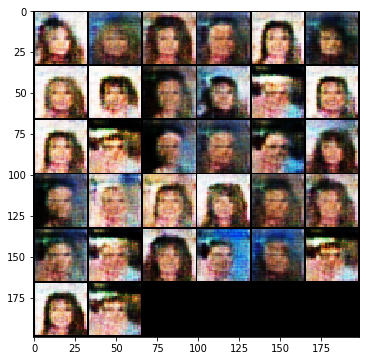

Iteration 83800: dis loss = 0.5509, gen loss = 2.7745, recon loss = 2.7745
Iteration 83850: dis loss = 0.3509, gen loss = 3.0443, recon loss = 3.0443
Iteration 83900: dis loss = 0.2736, gen loss = 2.8838, recon loss = 2.8838
Iteration 83950: dis loss = 0.4233, gen loss = 3.4395, recon loss = 3.4395
Iteration 84000: dis loss = 0.1386, gen loss = 3.1680, recon loss = 3.1680
Iteration 84050: dis loss = 0.3535, gen loss = 2.7253, recon loss = 2.7253
Iteration 84100: dis loss = 0.1846, gen loss = 3.1019, recon loss = 3.1019
Iteration 84150: dis loss = 1.6294, gen loss = 0.7659, recon loss = 0.7659
Iteration 84200: dis loss = 0.8636, gen loss = 2.9412, recon loss = 2.9412
Iteration 84250: dis loss = 0.4985, gen loss = 2.8408, recon loss = 2.8408
13 3000


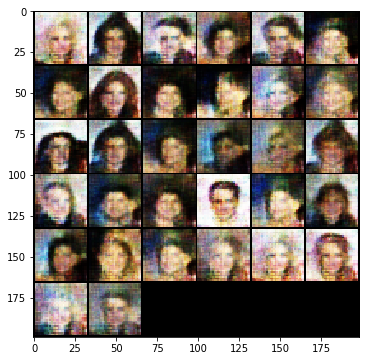

Iteration 84300: dis loss = 0.2434, gen loss = 3.0994, recon loss = 3.0994
Iteration 84350: dis loss = 0.6833, gen loss = 3.7783, recon loss = 3.7783
Iteration 84400: dis loss = 1.4442, gen loss = 2.4867, recon loss = 2.4867
Iteration 84450: dis loss = 1.9672, gen loss = 0.7231, recon loss = 0.7231
Iteration 84500: dis loss = 0.1600, gen loss = 3.4554, recon loss = 3.4554
Iteration 84550: dis loss = 0.5773, gen loss = 3.3453, recon loss = 3.3453
Iteration 84600: dis loss = 0.6339, gen loss = 2.7304, recon loss = 2.7304
Iteration 84650: dis loss = 0.8660, gen loss = 1.7048, recon loss = 1.7048
Iteration 84700: dis loss = 0.7691, gen loss = 2.9861, recon loss = 2.9861
Iteration 84750: dis loss = 0.7596, gen loss = 2.0146, recon loss = 2.0146
13 3500


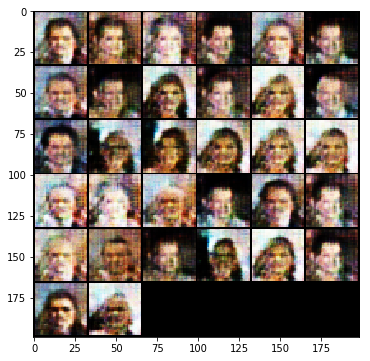

Iteration 84800: dis loss = 0.7259, gen loss = 1.9780, recon loss = 1.9780
Iteration 84850: dis loss = 0.3450, gen loss = 3.0414, recon loss = 3.0414
Iteration 84900: dis loss = 2.2396, gen loss = 3.1352, recon loss = 3.1352
Iteration 84950: dis loss = 1.8247, gen loss = 2.3587, recon loss = 2.3587
Iteration 85000: dis loss = 0.2432, gen loss = 2.6179, recon loss = 2.6179
Iteration 85050: dis loss = 0.1282, gen loss = 3.1129, recon loss = 3.1129
Iteration 85100: dis loss = 0.1540, gen loss = 5.3789, recon loss = 5.3789
Iteration 85150: dis loss = 0.5426, gen loss = 2.0956, recon loss = 2.0956
Iteration 85200: dis loss = 0.9850, gen loss = 3.2278, recon loss = 3.2278
Iteration 85250: dis loss = 0.3748, gen loss = 2.4153, recon loss = 2.4153
13 4000


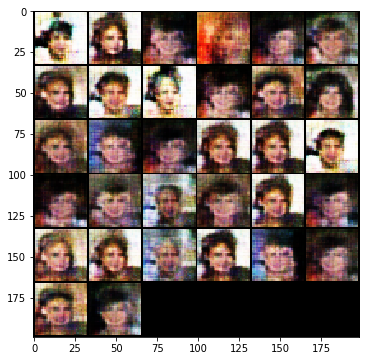

Iteration 85300: dis loss = 2.0345, gen loss = 1.3905, recon loss = 1.3905
Iteration 85350: dis loss = 0.2999, gen loss = 2.7764, recon loss = 2.7764
Iteration 85400: dis loss = 0.5358, gen loss = 2.1236, recon loss = 2.1236
Iteration 85450: dis loss = 0.8223, gen loss = 2.3545, recon loss = 2.3545
Iteration 85500: dis loss = 0.4362, gen loss = 2.8428, recon loss = 2.8428
Iteration 85550: dis loss = 0.3406, gen loss = 2.5409, recon loss = 2.5409
Iteration 85600: dis loss = 0.2023, gen loss = 3.1096, recon loss = 3.1096
Iteration 85650: dis loss = 0.1950, gen loss = 3.0572, recon loss = 3.0572
Iteration 85700: dis loss = 2.0442, gen loss = 2.7615, recon loss = 2.7615
Iteration 85750: dis loss = 1.1119, gen loss = 2.0530, recon loss = 2.0530
13 4500


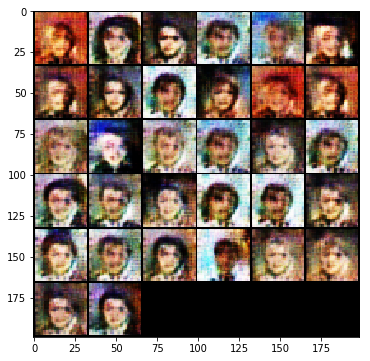

Iteration 85800: dis loss = 2.2980, gen loss = 0.6841, recon loss = 0.6841
Iteration 85850: dis loss = 0.3921, gen loss = 2.4766, recon loss = 2.4766
Iteration 85900: dis loss = 0.4031, gen loss = 3.8107, recon loss = 3.8107
Iteration 85950: dis loss = 1.5827, gen loss = 2.4832, recon loss = 2.4832
Iteration 86000: dis loss = 0.3458, gen loss = 2.7027, recon loss = 2.7027
Iteration 86050: dis loss = 0.0876, gen loss = 3.6913, recon loss = 3.6913
Iteration 86100: dis loss = 0.4446, gen loss = 2.2790, recon loss = 2.2790
Iteration 86150: dis loss = 0.1524, gen loss = 3.3422, recon loss = 3.3422
Iteration 86200: dis loss = 0.6950, gen loss = 2.0412, recon loss = 2.0412
Iteration 86250: dis loss = 0.8677, gen loss = 2.5273, recon loss = 2.5273
13 5000


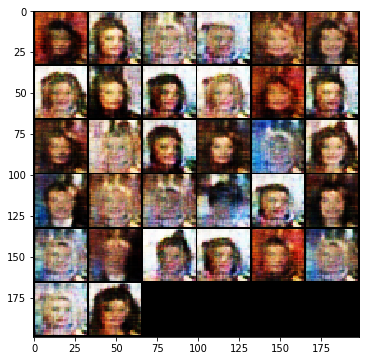

Iteration 86300: dis loss = 0.3509, gen loss = 3.1116, recon loss = 3.1116
Iteration 86350: dis loss = 0.1577, gen loss = 3.2789, recon loss = 3.2789
Iteration 86400: dis loss = 1.5786, gen loss = 1.8964, recon loss = 1.8964
Iteration 86450: dis loss = 0.9863, gen loss = 1.7259, recon loss = 1.7259
Iteration 86500: dis loss = 0.3013, gen loss = 2.3370, recon loss = 2.3370
Iteration 86550: dis loss = 1.1338, gen loss = 1.6003, recon loss = 1.6003
Iteration 86600: dis loss = 0.8329, gen loss = 1.4604, recon loss = 1.4604
Iteration 86650: dis loss = 0.8188, gen loss = 2.7861, recon loss = 2.7861
Iteration 86700: dis loss = 0.4948, gen loss = 2.8344, recon loss = 2.8344
Iteration 86750: dis loss = 1.0148, gen loss = 1.5395, recon loss = 1.5395
13 5500


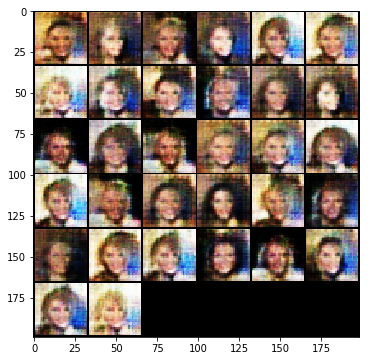

Iteration 86800: dis loss = 0.9041, gen loss = 1.5237, recon loss = 1.5237
Iteration 86850: dis loss = 0.3710, gen loss = 2.8085, recon loss = 2.8085
Iteration 86900: dis loss = 0.5744, gen loss = 1.8246, recon loss = 1.8246
Iteration 86950: dis loss = 0.9222, gen loss = 1.7769, recon loss = 1.7769
Iteration 87000: dis loss = 1.1055, gen loss = 4.2215, recon loss = 4.2215
Iteration 87050: dis loss = 0.4615, gen loss = 3.3798, recon loss = 3.3798
Iteration 87100: dis loss = 0.9396, gen loss = 1.3562, recon loss = 1.3562
Iteration 87150: dis loss = 0.7656, gen loss = 1.6704, recon loss = 1.6704
Iteration 87200: dis loss = 0.4636, gen loss = 2.4224, recon loss = 2.4224
Iteration 87250: dis loss = 0.5719, gen loss = 1.9643, recon loss = 1.9643
13 6000


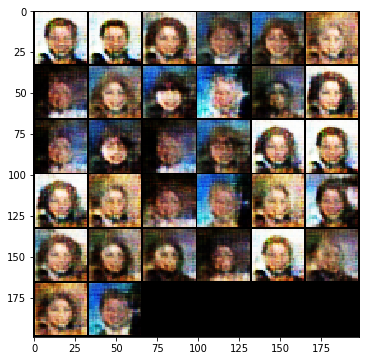

Iteration 87300: dis loss = 0.2639, gen loss = 3.0102, recon loss = 3.0102
Iteration 87350: dis loss = 0.6389, gen loss = 2.0398, recon loss = 2.0398
Iteration 87400: dis loss = 0.3065, gen loss = 2.9058, recon loss = 2.9058
Iteration 87450: dis loss = 0.3738, gen loss = 3.1140, recon loss = 3.1140
Iteration 87500: dis loss = 0.7418, gen loss = 3.0078, recon loss = 3.0078


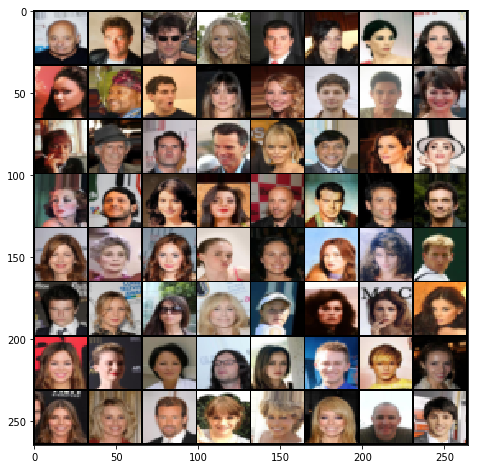

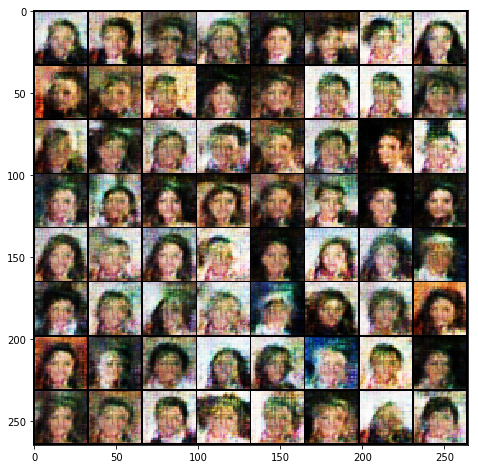

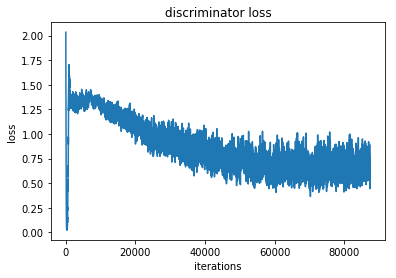

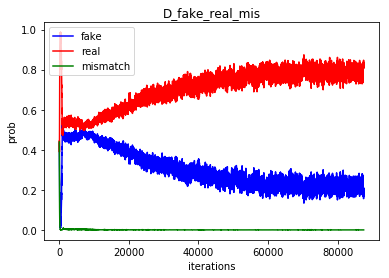

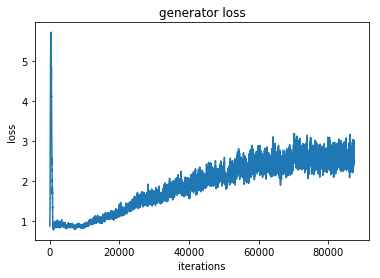

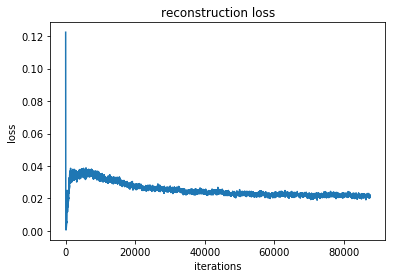

14 0


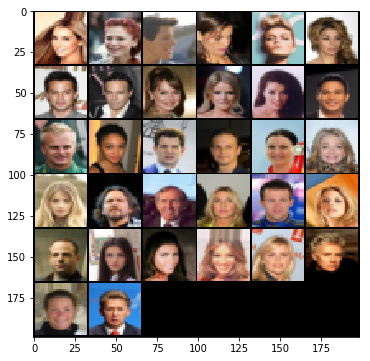

Iteration 87550: dis loss = 1.2068, gen loss = 1.5183, recon loss = 1.5183
Iteration 87600: dis loss = 0.6132, gen loss = 3.0273, recon loss = 3.0273
Iteration 87650: dis loss = 0.5297, gen loss = 2.5924, recon loss = 2.5924
Iteration 87700: dis loss = 0.0618, gen loss = 4.0109, recon loss = 4.0109
Iteration 87750: dis loss = 0.2947, gen loss = 2.5924, recon loss = 2.5924
Iteration 87800: dis loss = 1.7605, gen loss = 1.9761, recon loss = 1.9761
Iteration 87850: dis loss = 0.7876, gen loss = 2.0353, recon loss = 2.0353
Iteration 87900: dis loss = 1.7748, gen loss = 2.4015, recon loss = 2.4015
Iteration 87950: dis loss = 0.8381, gen loss = 2.6697, recon loss = 2.6697
Iteration 88000: dis loss = 0.6520, gen loss = 2.5691, recon loss = 2.5691
14 500


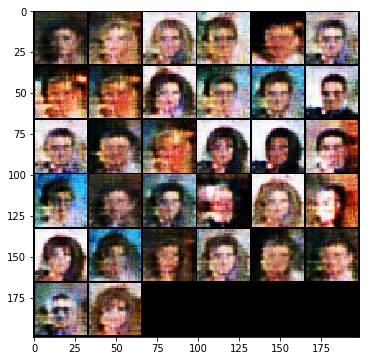

Iteration 88050: dis loss = 1.0102, gen loss = 1.4650, recon loss = 1.4650
Iteration 88100: dis loss = 1.5271, gen loss = 1.3694, recon loss = 1.3694
Iteration 88150: dis loss = 0.5857, gen loss = 3.0258, recon loss = 3.0258
Iteration 88200: dis loss = 0.1413, gen loss = 3.5253, recon loss = 3.5253
Iteration 88250: dis loss = 0.5725, gen loss = 2.0813, recon loss = 2.0813
Iteration 88300: dis loss = 0.3080, gen loss = 2.6740, recon loss = 2.6740
Iteration 88350: dis loss = 0.5405, gen loss = 2.0317, recon loss = 2.0317
Iteration 88400: dis loss = 0.4080, gen loss = 3.3822, recon loss = 3.3822
Iteration 88450: dis loss = 0.3408, gen loss = 2.8540, recon loss = 2.8540
Iteration 88500: dis loss = 0.6377, gen loss = 2.4155, recon loss = 2.4155
14 1000


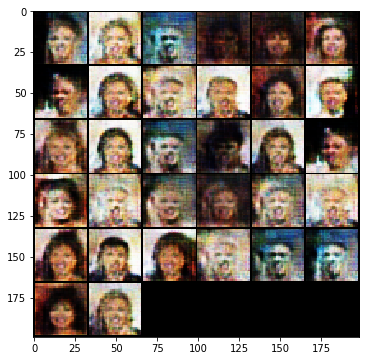

Iteration 88550: dis loss = 1.2568, gen loss = 4.0647, recon loss = 4.0647
Iteration 88600: dis loss = 0.5033, gen loss = 2.1630, recon loss = 2.1630
Iteration 88650: dis loss = 0.5447, gen loss = 2.0464, recon loss = 2.0464
Iteration 88700: dis loss = 0.8675, gen loss = 2.5627, recon loss = 2.5627
Iteration 88750: dis loss = 0.5045, gen loss = 2.7714, recon loss = 2.7714
Iteration 88800: dis loss = 0.1692, gen loss = 3.1204, recon loss = 3.1204
Iteration 88850: dis loss = 0.4825, gen loss = 2.3359, recon loss = 2.3359
Iteration 88900: dis loss = 0.8946, gen loss = 2.0760, recon loss = 2.0760
Iteration 88950: dis loss = 0.8445, gen loss = 1.3250, recon loss = 1.3250
Iteration 89000: dis loss = 0.4249, gen loss = 2.6008, recon loss = 2.6008
14 1500


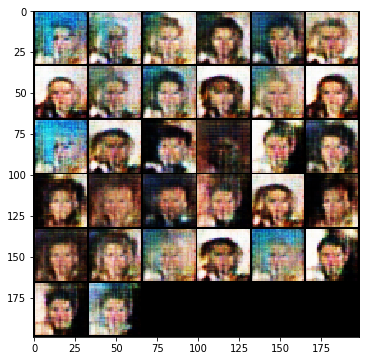

Iteration 89050: dis loss = 1.1744, gen loss = 2.6776, recon loss = 2.6776
Iteration 89100: dis loss = 0.2193, gen loss = 3.0534, recon loss = 3.0534
Iteration 89150: dis loss = 0.9907, gen loss = 1.8066, recon loss = 1.8066
Iteration 89200: dis loss = 0.7498, gen loss = 2.9211, recon loss = 2.9211
Iteration 89250: dis loss = 0.4065, gen loss = 2.6191, recon loss = 2.6191
Iteration 89300: dis loss = 0.1138, gen loss = 3.7450, recon loss = 3.7450
Iteration 89350: dis loss = 0.5773, gen loss = 2.5742, recon loss = 2.5742
Iteration 89400: dis loss = 0.6775, gen loss = 2.2734, recon loss = 2.2734
Iteration 89450: dis loss = 1.6658, gen loss = 2.4215, recon loss = 2.4215
Iteration 89500: dis loss = 0.5560, gen loss = 2.6697, recon loss = 2.6697
14 2000


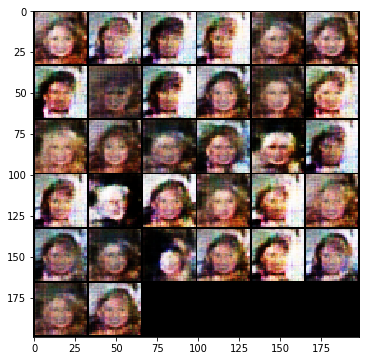

Iteration 89550: dis loss = 1.8551, gen loss = 1.9539, recon loss = 1.9539
Iteration 89600: dis loss = 0.1851, gen loss = 2.8645, recon loss = 2.8645
Iteration 89650: dis loss = 1.0719, gen loss = 1.7893, recon loss = 1.7893
Iteration 89700: dis loss = 0.7122, gen loss = 2.3621, recon loss = 2.3621
Iteration 89750: dis loss = 1.1945, gen loss = 1.2845, recon loss = 1.2845
Iteration 89800: dis loss = 0.1159, gen loss = 3.2359, recon loss = 3.2359
Iteration 89850: dis loss = 0.2516, gen loss = 3.1462, recon loss = 3.1462
Iteration 89900: dis loss = 1.0566, gen loss = 1.5890, recon loss = 1.5890
Iteration 89950: dis loss = 0.5384, gen loss = 2.7023, recon loss = 2.7023
Iteration 90000: dis loss = 0.4720, gen loss = 2.2889, recon loss = 2.2889
14 2500


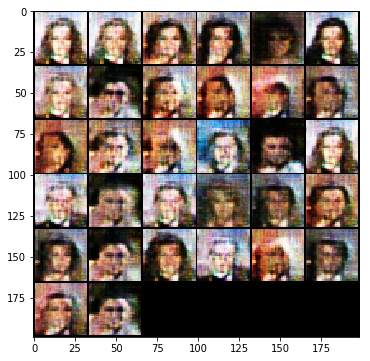

Iteration 90050: dis loss = 0.6259, gen loss = 2.4821, recon loss = 2.4821
Iteration 90100: dis loss = 0.4518, gen loss = 2.5744, recon loss = 2.5744
Iteration 90150: dis loss = 0.2141, gen loss = 3.0373, recon loss = 3.0373
Iteration 90200: dis loss = 0.1161, gen loss = 3.2635, recon loss = 3.2635
Iteration 90250: dis loss = 0.3006, gen loss = 2.7605, recon loss = 2.7605
Iteration 90300: dis loss = 0.5461, gen loss = 2.5250, recon loss = 2.5250
Iteration 90350: dis loss = 0.3914, gen loss = 2.7098, recon loss = 2.7098
Iteration 90400: dis loss = 2.0873, gen loss = 0.5530, recon loss = 0.5530
Iteration 90450: dis loss = 0.5927, gen loss = 3.1169, recon loss = 3.1169
Iteration 90500: dis loss = 0.1357, gen loss = 3.6112, recon loss = 3.6112
14 3000


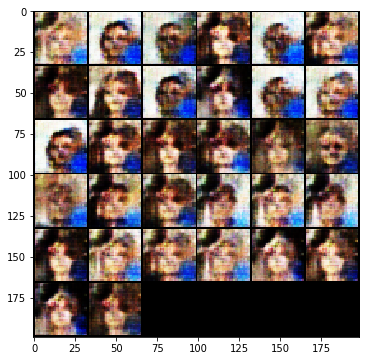

Iteration 90550: dis loss = 0.5357, gen loss = 3.0402, recon loss = 3.0402
Iteration 90600: dis loss = 0.0947, gen loss = 3.7058, recon loss = 3.7058
Iteration 90650: dis loss = 1.0357, gen loss = 2.3801, recon loss = 2.3801
Iteration 90700: dis loss = 2.2208, gen loss = 0.5452, recon loss = 0.5452
Iteration 90750: dis loss = 0.1217, gen loss = 3.7066, recon loss = 3.7066
Iteration 90800: dis loss = 1.0687, gen loss = 1.7348, recon loss = 1.7348
Iteration 90850: dis loss = 0.5721, gen loss = 3.1566, recon loss = 3.1566
Iteration 90900: dis loss = 0.7799, gen loss = 1.6053, recon loss = 1.6053
Iteration 90950: dis loss = 0.9707, gen loss = 1.5564, recon loss = 1.5564
Iteration 91000: dis loss = 0.3567, gen loss = 2.6370, recon loss = 2.6370
14 3500


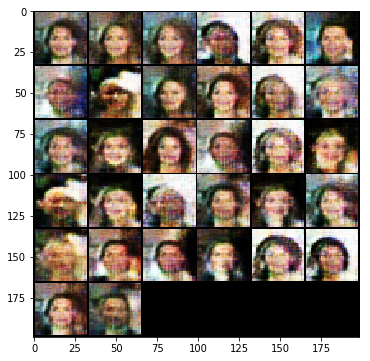

Iteration 91050: dis loss = 0.4906, gen loss = 2.3162, recon loss = 2.3162
Iteration 91100: dis loss = 0.5052, gen loss = 2.3516, recon loss = 2.3516
Iteration 91150: dis loss = 2.5948, gen loss = 2.0336, recon loss = 2.0336
Iteration 91200: dis loss = 1.4629, gen loss = 2.6722, recon loss = 2.6722
Iteration 91250: dis loss = 0.2918, gen loss = 2.8780, recon loss = 2.8780
Iteration 91300: dis loss = 0.6385, gen loss = 3.4749, recon loss = 3.4749
Iteration 91350: dis loss = 0.1759, gen loss = 2.9826, recon loss = 2.9826
Iteration 91400: dis loss = 0.4940, gen loss = 3.0454, recon loss = 3.0454
Iteration 91450: dis loss = 0.6828, gen loss = 2.4960, recon loss = 2.4960
Iteration 91500: dis loss = 0.6699, gen loss = 2.6065, recon loss = 2.6065
14 4000


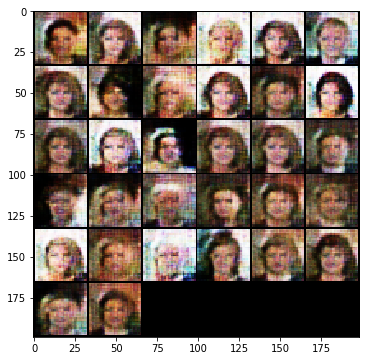

Iteration 91550: dis loss = 1.5603, gen loss = 1.4239, recon loss = 1.4239
Iteration 91600: dis loss = 0.1916, gen loss = 3.0155, recon loss = 3.0155
Iteration 91650: dis loss = 0.6944, gen loss = 1.8141, recon loss = 1.8141
Iteration 91700: dis loss = 1.0975, gen loss = 1.2710, recon loss = 1.2710
Iteration 91750: dis loss = 0.1761, gen loss = 3.0001, recon loss = 3.0001
Iteration 91800: dis loss = 0.4864, gen loss = 3.1080, recon loss = 3.1080
Iteration 91850: dis loss = 0.6138, gen loss = 2.8923, recon loss = 2.8923
Iteration 91900: dis loss = 0.7571, gen loss = 1.9280, recon loss = 1.9280
Iteration 91950: dis loss = 0.3135, gen loss = 3.1445, recon loss = 3.1445
Iteration 92000: dis loss = 1.9846, gen loss = 0.7357, recon loss = 0.7357
14 4500


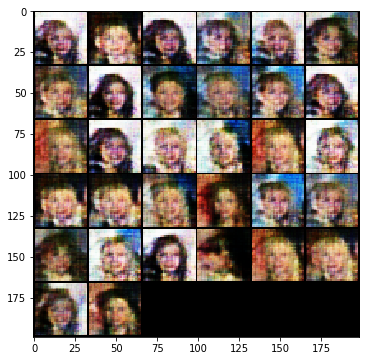

Iteration 92050: dis loss = 1.1759, gen loss = 1.0004, recon loss = 1.0004
Iteration 92100: dis loss = 0.4160, gen loss = 3.1148, recon loss = 3.1148
Iteration 92150: dis loss = 0.3925, gen loss = 3.6423, recon loss = 3.6423
Iteration 92200: dis loss = 0.4283, gen loss = 3.1193, recon loss = 3.1193
Iteration 92250: dis loss = 0.3204, gen loss = 3.0121, recon loss = 3.0121
Iteration 92300: dis loss = 0.0602, gen loss = 4.7921, recon loss = 4.7921
Iteration 92350: dis loss = 0.2888, gen loss = 2.9135, recon loss = 2.9135
Iteration 92400: dis loss = 0.2534, gen loss = 2.7068, recon loss = 2.7068
Iteration 92450: dis loss = 0.7048, gen loss = 1.7642, recon loss = 1.7642
Iteration 92500: dis loss = 0.2032, gen loss = 2.9171, recon loss = 2.9171
14 5000


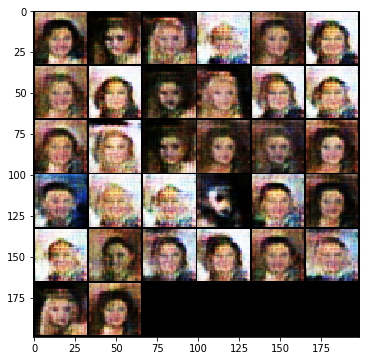

Iteration 92550: dis loss = 0.6363, gen loss = 6.5935, recon loss = 6.5935
Iteration 92600: dis loss = 0.2784, gen loss = 2.8243, recon loss = 2.8243
Iteration 92650: dis loss = 0.7641, gen loss = 2.7448, recon loss = 2.7448
Iteration 92700: dis loss = 1.3345, gen loss = 1.5473, recon loss = 1.5473
Iteration 92750: dis loss = 0.4886, gen loss = 2.1053, recon loss = 2.1053
Iteration 92800: dis loss = 0.9887, gen loss = 2.2606, recon loss = 2.2606
Iteration 92850: dis loss = 0.7848, gen loss = 1.7799, recon loss = 1.7799
Iteration 92900: dis loss = 0.6683, gen loss = 3.3230, recon loss = 3.3230
Iteration 92950: dis loss = 1.5435, gen loss = 2.6876, recon loss = 2.6876
Iteration 93000: dis loss = 0.5890, gen loss = 1.8750, recon loss = 1.8750
14 5500


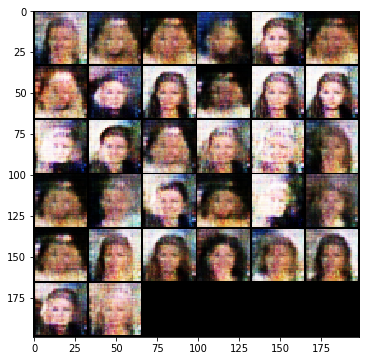

Iteration 93050: dis loss = 1.4401, gen loss = 1.3082, recon loss = 1.3082
Iteration 93100: dis loss = 0.1922, gen loss = 3.4719, recon loss = 3.4719
Iteration 93150: dis loss = 0.4446, gen loss = 2.7214, recon loss = 2.7214
Iteration 93200: dis loss = 1.3430, gen loss = 1.1451, recon loss = 1.1451
Iteration 93250: dis loss = 0.8803, gen loss = 3.4404, recon loss = 3.4404
Iteration 93300: dis loss = 0.7704, gen loss = 2.0446, recon loss = 2.0446
Iteration 93350: dis loss = 0.6804, gen loss = 2.0161, recon loss = 2.0161
Iteration 93400: dis loss = 1.0136, gen loss = 1.6544, recon loss = 1.6544
Iteration 93450: dis loss = 0.4657, gen loss = 2.4298, recon loss = 2.4298
Iteration 93500: dis loss = 0.4922, gen loss = 2.9125, recon loss = 2.9125
14 6000


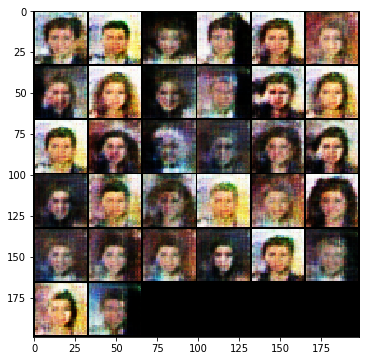

Iteration 93550: dis loss = 0.1217, gen loss = 4.0398, recon loss = 4.0398
Iteration 93600: dis loss = 0.8880, gen loss = 2.7225, recon loss = 2.7225
Iteration 93650: dis loss = 1.7216, gen loss = 2.2947, recon loss = 2.2947
Iteration 93700: dis loss = 1.1822, gen loss = 1.3329, recon loss = 1.3329
Iteration 93750: dis loss = 0.4185, gen loss = 2.9066, recon loss = 2.9066


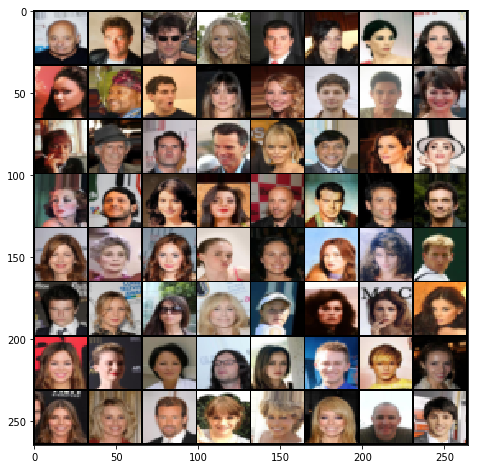

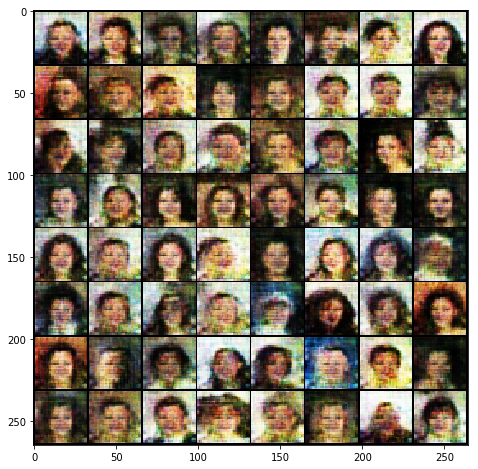

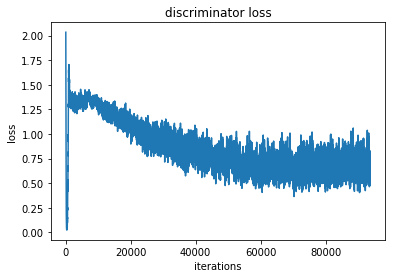

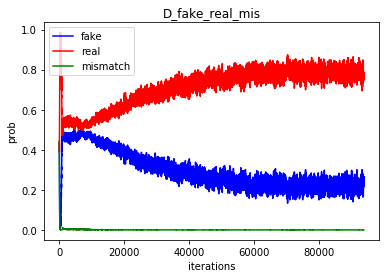

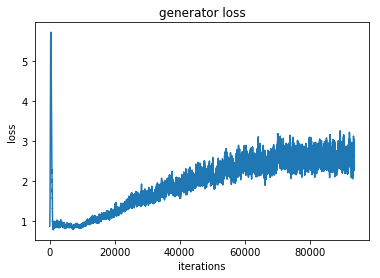

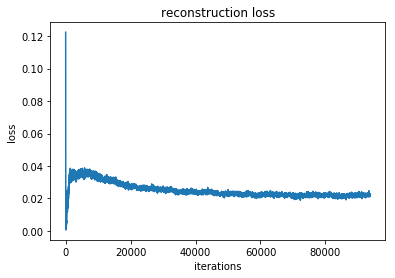

15 0


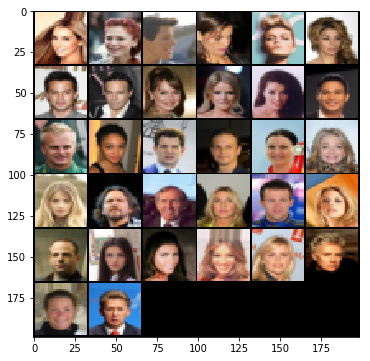

Iteration 93800: dis loss = 1.8062, gen loss = 1.7770, recon loss = 1.7770
Iteration 93850: dis loss = 0.1810, gen loss = 3.2669, recon loss = 3.2669
Iteration 93900: dis loss = 0.4711, gen loss = 3.3775, recon loss = 3.3775
Iteration 93950: dis loss = 0.2526, gen loss = 3.0847, recon loss = 3.0847
Iteration 94000: dis loss = 0.1941, gen loss = 3.1457, recon loss = 3.1457
Iteration 94050: dis loss = 3.0307, gen loss = 1.2297, recon loss = 1.2297
Iteration 94100: dis loss = 0.6266, gen loss = 1.8888, recon loss = 1.8888
Iteration 94150: dis loss = 0.7276, gen loss = 2.6901, recon loss = 2.6901
Iteration 94200: dis loss = 0.2335, gen loss = 2.8240, recon loss = 2.8240
Iteration 94250: dis loss = 1.0995, gen loss = 2.7792, recon loss = 2.7792
15 500


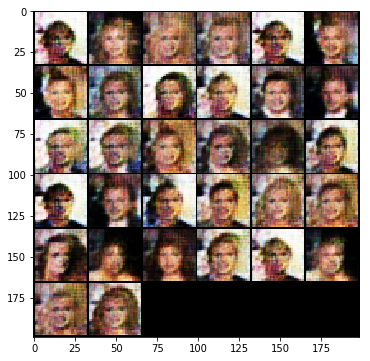

Iteration 94300: dis loss = 0.7507, gen loss = 1.3799, recon loss = 1.3799
Iteration 94350: dis loss = 1.1668, gen loss = 1.7808, recon loss = 1.7808
Iteration 94400: dis loss = 0.2241, gen loss = 3.3298, recon loss = 3.3298
Iteration 94450: dis loss = 0.1775, gen loss = 3.8058, recon loss = 3.8058
Iteration 94500: dis loss = 1.2695, gen loss = 2.1928, recon loss = 2.1928
Iteration 94550: dis loss = 0.1606, gen loss = 3.0390, recon loss = 3.0390
Iteration 94600: dis loss = 0.6787, gen loss = 2.1742, recon loss = 2.1742
Iteration 94650: dis loss = 0.2143, gen loss = 3.6066, recon loss = 3.6066
Iteration 94700: dis loss = 0.2493, gen loss = 2.9916, recon loss = 2.9916
Iteration 94750: dis loss = 0.5574, gen loss = 2.1040, recon loss = 2.1040
15 1000


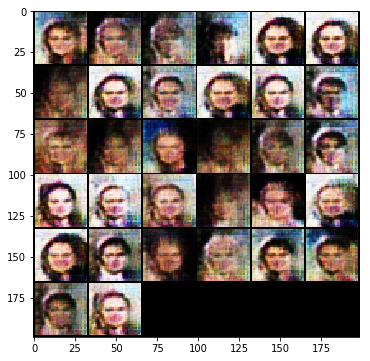

Iteration 94800: dis loss = 0.6958, gen loss = 2.6851, recon loss = 2.6851
Iteration 94850: dis loss = 0.3352, gen loss = 2.7033, recon loss = 2.7033
Iteration 94900: dis loss = 0.7032, gen loss = 2.1877, recon loss = 2.1877
Iteration 94950: dis loss = 0.9847, gen loss = 2.1440, recon loss = 2.1440
Iteration 95000: dis loss = 0.7799, gen loss = 1.7112, recon loss = 1.7112
Iteration 95050: dis loss = 0.1154, gen loss = 4.0685, recon loss = 4.0685
Iteration 95100: dis loss = 0.3615, gen loss = 2.5975, recon loss = 2.5975
Iteration 95150: dis loss = 0.4909, gen loss = 2.0589, recon loss = 2.0589
Iteration 95200: dis loss = 1.0430, gen loss = 1.4694, recon loss = 1.4694
Iteration 95250: dis loss = 0.9770, gen loss = 1.3088, recon loss = 1.3088
15 1500


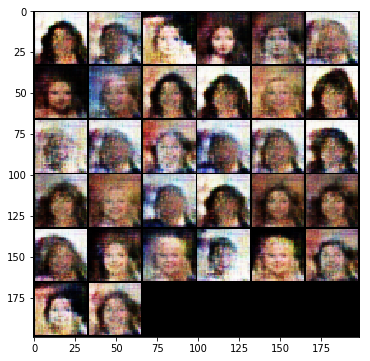

Iteration 95300: dis loss = 0.6923, gen loss = 2.1660, recon loss = 2.1660
Iteration 95350: dis loss = 0.6026, gen loss = 2.0641, recon loss = 2.0641
Iteration 95400: dis loss = 0.6540, gen loss = 2.1906, recon loss = 2.1906
Iteration 95450: dis loss = 0.2757, gen loss = 2.7654, recon loss = 2.7654
Iteration 95500: dis loss = 0.7419, gen loss = 2.8564, recon loss = 2.8564
Iteration 95550: dis loss = 0.0486, gen loss = 4.5326, recon loss = 4.5326
Iteration 95600: dis loss = 0.3646, gen loss = 2.9052, recon loss = 2.9052
Iteration 95650: dis loss = 0.5247, gen loss = 2.7429, recon loss = 2.7429
Iteration 95700: dis loss = 1.2789, gen loss = 0.7214, recon loss = 0.7214
Iteration 95750: dis loss = 0.6858, gen loss = 2.2152, recon loss = 2.2152
15 2000


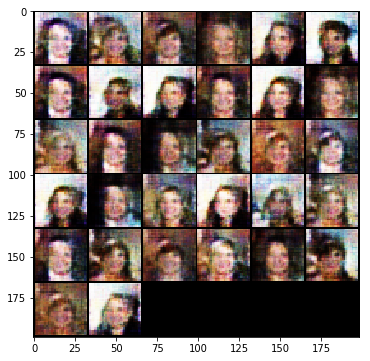

Iteration 95800: dis loss = 1.2450, gen loss = 2.8667, recon loss = 2.8667
Iteration 95850: dis loss = 0.0896, gen loss = 3.8841, recon loss = 3.8841
Iteration 95900: dis loss = 1.4322, gen loss = 1.3614, recon loss = 1.3614
Iteration 95950: dis loss = 0.5981, gen loss = 2.1370, recon loss = 2.1370
Iteration 96000: dis loss = 0.5809, gen loss = 2.0673, recon loss = 2.0673
Iteration 96050: dis loss = 0.9278, gen loss = 2.6950, recon loss = 2.6950
Iteration 96100: dis loss = 0.1970, gen loss = 2.9658, recon loss = 2.9658
Iteration 96150: dis loss = 0.4252, gen loss = 2.2838, recon loss = 2.2838
Iteration 96200: dis loss = 0.6662, gen loss = 2.4918, recon loss = 2.4918
Iteration 96250: dis loss = 0.3202, gen loss = 2.5445, recon loss = 2.5445
15 2500


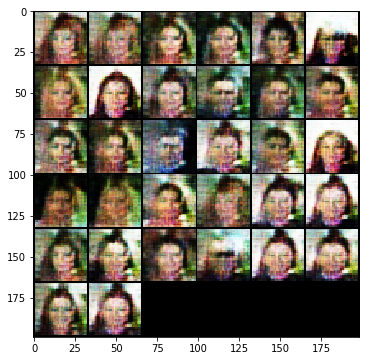

Iteration 96300: dis loss = 0.3281, gen loss = 2.5830, recon loss = 2.5830
Iteration 96350: dis loss = 0.6991, gen loss = 4.0484, recon loss = 4.0484
Iteration 96400: dis loss = 0.3774, gen loss = 2.7667, recon loss = 2.7667
Iteration 96450: dis loss = 0.7014, gen loss = 3.9585, recon loss = 3.9585
Iteration 96500: dis loss = 0.0568, gen loss = 4.7008, recon loss = 4.7008
Iteration 96550: dis loss = 0.9118, gen loss = 2.5002, recon loss = 2.5002
Iteration 96600: dis loss = 0.4819, gen loss = 2.1489, recon loss = 2.1489
Iteration 96650: dis loss = 1.9542, gen loss = 1.0527, recon loss = 1.0527
Iteration 96700: dis loss = 0.6570, gen loss = 2.8633, recon loss = 2.8633
Iteration 96750: dis loss = 0.2654, gen loss = 3.2778, recon loss = 3.2778
15 3000


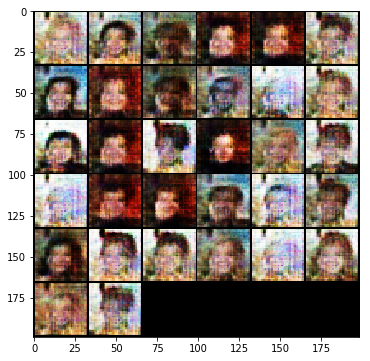

Iteration 96800: dis loss = 0.1249, gen loss = 3.3551, recon loss = 3.3551
Iteration 96850: dis loss = 0.2173, gen loss = 4.5864, recon loss = 4.5864
Iteration 96900: dis loss = 0.7506, gen loss = 2.3650, recon loss = 2.3650
Iteration 96950: dis loss = 1.7573, gen loss = 0.9315, recon loss = 0.9315
Iteration 97000: dis loss = 0.4204, gen loss = 2.6209, recon loss = 2.6209
Iteration 97050: dis loss = 0.6204, gen loss = 2.3658, recon loss = 2.3658
Iteration 97100: dis loss = 0.5692, gen loss = 2.0559, recon loss = 2.0559
Iteration 97150: dis loss = 0.9948, gen loss = 2.1202, recon loss = 2.1202
Iteration 97200: dis loss = 0.6454, gen loss = 2.3540, recon loss = 2.3540
Iteration 97250: dis loss = 0.4570, gen loss = 3.0824, recon loss = 3.0824
15 3500


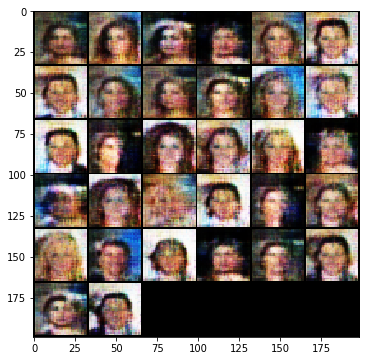

Iteration 97300: dis loss = 1.1447, gen loss = 1.6517, recon loss = 1.6517
Iteration 97350: dis loss = 0.2507, gen loss = 3.0265, recon loss = 3.0265
Iteration 97400: dis loss = 3.4454, gen loss = 4.1812, recon loss = 4.1812
Iteration 97450: dis loss = 0.2665, gen loss = 3.3105, recon loss = 3.3105
Iteration 97500: dis loss = 0.2410, gen loss = 2.6391, recon loss = 2.6391
Iteration 97550: dis loss = 0.6741, gen loss = 2.9236, recon loss = 2.9236
Iteration 97600: dis loss = 0.6504, gen loss = 3.1881, recon loss = 3.1881
Iteration 97650: dis loss = 0.4057, gen loss = 2.3882, recon loss = 2.3882
Iteration 97700: dis loss = 0.4675, gen loss = 2.1176, recon loss = 2.1176
Iteration 97750: dis loss = 1.2895, gen loss = 2.9254, recon loss = 2.9254
15 4000


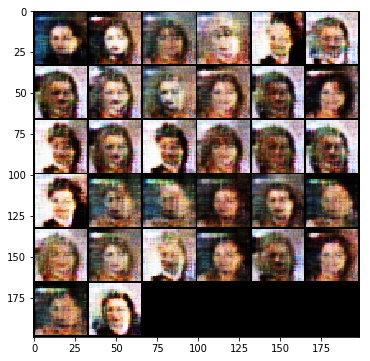

Iteration 97800: dis loss = 0.9829, gen loss = 1.6100, recon loss = 1.6100
Iteration 97850: dis loss = 0.2931, gen loss = 7.0492, recon loss = 7.0492
Iteration 97900: dis loss = 0.4036, gen loss = 2.4374, recon loss = 2.4374
Iteration 97950: dis loss = 0.6699, gen loss = 1.9193, recon loss = 1.9193
Iteration 98000: dis loss = 0.2837, gen loss = 3.0199, recon loss = 3.0199
Iteration 98050: dis loss = 1.6935, gen loss = 2.2125, recon loss = 2.2125
Iteration 98100: dis loss = 0.4805, gen loss = 3.2189, recon loss = 3.2189
Iteration 98150: dis loss = 0.5646, gen loss = 2.4023, recon loss = 2.4023
Iteration 98200: dis loss = 1.3440, gen loss = 3.1188, recon loss = 3.1188
Iteration 98250: dis loss = 1.2829, gen loss = 1.2970, recon loss = 1.2970
15 4500


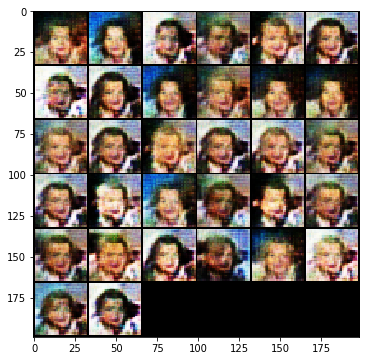

Iteration 98300: dis loss = 0.9095, gen loss = 1.5734, recon loss = 1.5734
Iteration 98350: dis loss = 0.5071, gen loss = 2.8270, recon loss = 2.8270
Iteration 98400: dis loss = 0.1020, gen loss = 3.7356, recon loss = 3.7356
Iteration 98450: dis loss = 0.0850, gen loss = 3.8068, recon loss = 3.8068
Iteration 98500: dis loss = 0.0614, gen loss = 3.6500, recon loss = 3.6500
Iteration 98550: dis loss = 0.0818, gen loss = 4.2454, recon loss = 4.2454
Iteration 98600: dis loss = 0.3540, gen loss = 3.0552, recon loss = 3.0552
Iteration 98650: dis loss = 0.2273, gen loss = 3.0473, recon loss = 3.0473
Iteration 98700: dis loss = 0.3778, gen loss = 4.1282, recon loss = 4.1282
Iteration 98750: dis loss = 0.3733, gen loss = 3.1059, recon loss = 3.1059
15 5000


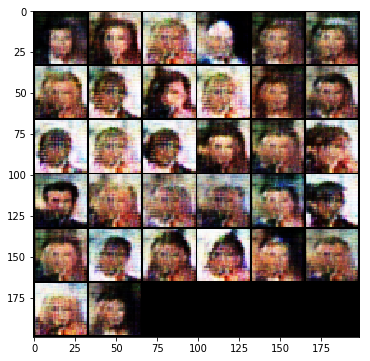

Iteration 98800: dis loss = 0.2621, gen loss = 3.3193, recon loss = 3.3193
Iteration 98850: dis loss = 0.3417, gen loss = 3.0955, recon loss = 3.0955
Iteration 98900: dis loss = 1.5763, gen loss = 1.9095, recon loss = 1.9095
Iteration 98950: dis loss = 0.9640, gen loss = 1.5757, recon loss = 1.5757
Iteration 99000: dis loss = 1.1200, gen loss = 2.2014, recon loss = 2.2014
Iteration 99050: dis loss = 0.5101, gen loss = 2.1181, recon loss = 2.1181
Iteration 99100: dis loss = 0.7916, gen loss = 2.3633, recon loss = 2.3633
Iteration 99150: dis loss = 1.4881, gen loss = 2.6575, recon loss = 2.6575
Iteration 99200: dis loss = 0.6754, gen loss = 2.3981, recon loss = 2.3981
Iteration 99250: dis loss = 0.7164, gen loss = 1.6671, recon loss = 1.6671
15 5500


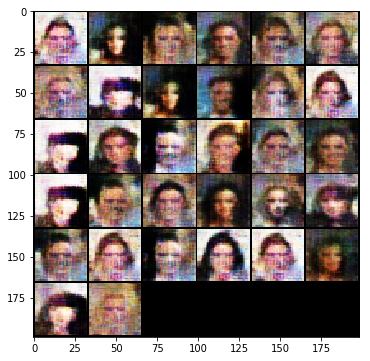

Iteration 99300: dis loss = 1.5753, gen loss = 1.7490, recon loss = 1.7490
Iteration 99350: dis loss = 0.2670, gen loss = 2.9876, recon loss = 2.9876
Iteration 99400: dis loss = 0.3729, gen loss = 2.6345, recon loss = 2.6345
Iteration 99450: dis loss = 1.0042, gen loss = 2.1658, recon loss = 2.1658
Iteration 99500: dis loss = 0.8096, gen loss = 2.9936, recon loss = 2.9936
Iteration 99550: dis loss = 0.3985, gen loss = 2.4963, recon loss = 2.4963
Iteration 99600: dis loss = 0.3994, gen loss = 2.6210, recon loss = 2.6210
Iteration 99650: dis loss = 0.9919, gen loss = 2.1208, recon loss = 2.1208
Iteration 99700: dis loss = 0.4957, gen loss = 2.1108, recon loss = 2.1108
Iteration 99750: dis loss = 0.9422, gen loss = 3.2569, recon loss = 3.2569
15 6000


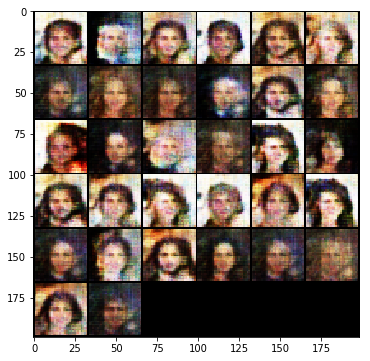

Iteration 99800: dis loss = 0.1527, gen loss = 3.7154, recon loss = 3.7154
Iteration 99850: dis loss = 0.3032, gen loss = 2.4157, recon loss = 2.4157
Iteration 99900: dis loss = 1.0014, gen loss = 2.7344, recon loss = 2.7344
Iteration 99950: dis loss = 0.3518, gen loss = 2.8606, recon loss = 2.8606
Iteration 100000: dis loss = 0.2523, gen loss = 3.1362, recon loss = 3.1362


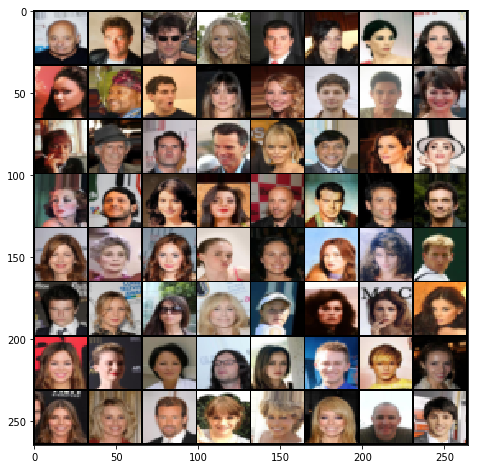

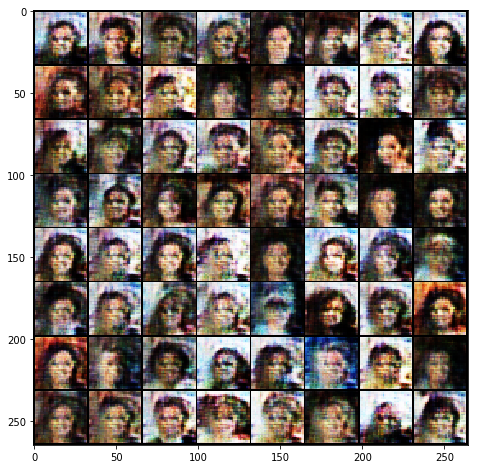

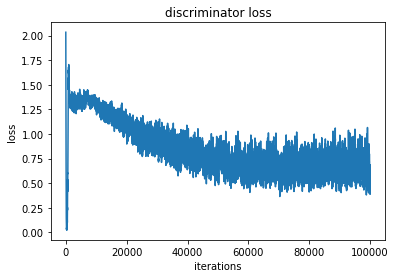

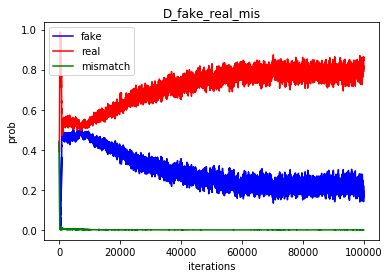

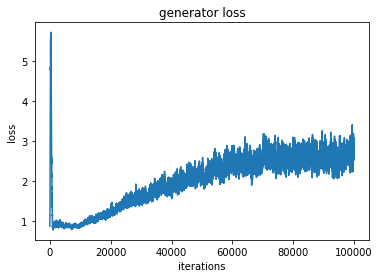

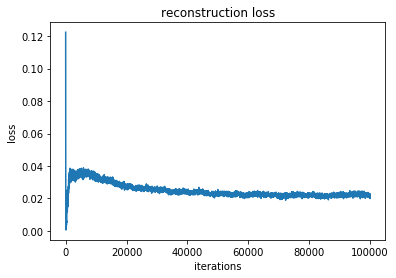

16 0


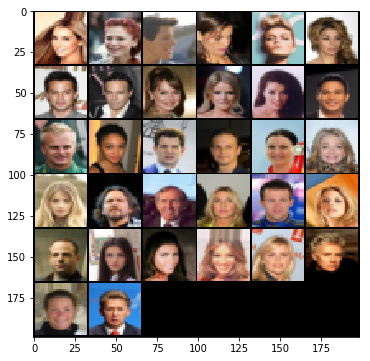

Iteration 100050: dis loss = 1.0154, gen loss = 2.0083, recon loss = 2.0083
Iteration 100100: dis loss = 1.0678, gen loss = 3.2758, recon loss = 3.2758
Iteration 100150: dis loss = 0.2200, gen loss = 3.1224, recon loss = 3.1224
Iteration 100200: dis loss = 0.1552, gen loss = 4.8650, recon loss = 4.8650
Iteration 100250: dis loss = 0.4462, gen loss = 2.2812, recon loss = 2.2812
Iteration 100300: dis loss = 1.3823, gen loss = 2.3134, recon loss = 2.3134
Iteration 100350: dis loss = 0.4022, gen loss = 2.9181, recon loss = 2.9181
Iteration 100400: dis loss = 1.9517, gen loss = 2.0696, recon loss = 2.0696
Iteration 100450: dis loss = 0.4300, gen loss = 2.7594, recon loss = 2.7594
Iteration 100500: dis loss = 0.4376, gen loss = 3.0504, recon loss = 3.0504
16 500


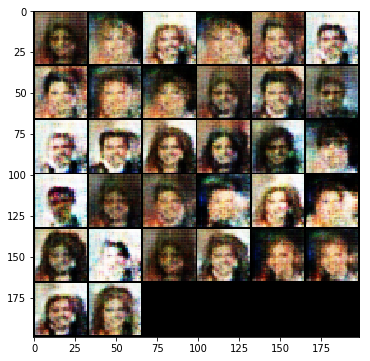

Iteration 100550: dis loss = 1.0022, gen loss = 1.6339, recon loss = 1.6339
Iteration 100600: dis loss = 0.5993, gen loss = 1.8351, recon loss = 1.8351
Iteration 100650: dis loss = 0.1195, gen loss = 3.4865, recon loss = 3.4865
Iteration 100700: dis loss = 0.2741, gen loss = 2.9016, recon loss = 2.9016
Iteration 100750: dis loss = 0.3041, gen loss = 2.7944, recon loss = 2.7944
Iteration 100800: dis loss = 0.1430, gen loss = 3.4816, recon loss = 3.4816
Iteration 100850: dis loss = 0.9606, gen loss = 3.5153, recon loss = 3.5153
Iteration 100900: dis loss = 0.2062, gen loss = 3.8099, recon loss = 3.8099
Iteration 100950: dis loss = 0.2602, gen loss = 2.7329, recon loss = 2.7329
Iteration 101000: dis loss = 0.2356, gen loss = 2.9225, recon loss = 2.9225
16 1000


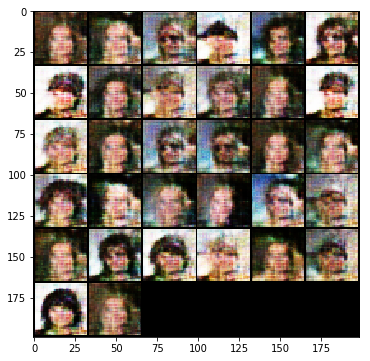

KeyboardInterrupt: 

In [10]:
tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dcgan.train(sess, train_samples, sample_features)
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
        saver.save(sess, 'model1126_20k/dcgan')


## Reloading model and Training
* load the trained model at 'model/dcgan'
* Turn load_flag = True

In [ ]:
tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
        saver.restore(sess, 'model1126_20k/dcgan')
        dcgan.train(sess, train_samples, sample_features, load_flag = True)
        

## Imshow other face features

In [69]:
# cols = ["Black_Hair", "Blond_Hair", "Brown_Hair", "Heavy_Makeup", "Male", "Smiling"]
features = [0, 0, 1, 0, 0, 1] 
# sample feature
sample_features = np.array(features).reshape((-1,len(features)))
attr_dim = len(features) # desired sample attr dim
print sample_features.shape

def createFeature(SampleFeature):
    size = len(SampleFeature)
    return np.array(SampleFeature).reshape((-1,size))

def printFeature(SampleFeature):
    cols = ["Black_Hair", "Blond_Hair", "Brown_Hair", "Heavy_Makeup", "Male", "Smiling"]
    size = len(SampleFeature[0])
    out = ""
    for i in xrange(size):
        if SampleFeature[0][i]:
            out = out + cols[i] + " "
        else:
            out = out + "Not_" + cols[i] + " "
    return out

y_ = scipy.misc.imread('data/img_other/profile2.jpg')
y_ = transform(y_, y_.shape[0], y_.shape[1], H_, W_, True)
print np.amax(y_)
print np.amin(y_)
y_ = np.expand_dims(y_,0)
print y_.shape
# fig = plt.figure()
# plt.imshow(y_[0])

(1, 6)
0.98431372549
0.0
(1, 32, 32, 3)


gen_attr_ dim: Tensor("gen/Reshape_2:0", shape=(?, 60), dtype=float32, device=/device:CPU:0)
Tensor("gen/Sigmoid:0", shape=(?, ?, ?, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
Tensor("Placeholder_1:0", shape=(?, 32, 32, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis_1/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis_1/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
Tensor("Placeholder_1:0", shape=(?, 32, 32, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis_2/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis_2/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
********* d_var ********** 
---------
Variables: name (type shape) [size]
---------
dis/conv1/w:0 (float32_ref 

INFO:tensorflow:Restoring parameters from model1126_20k/dcgan_5


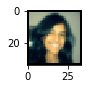

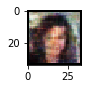

In [70]:
tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
        saver.restore(sess, 'model1126_20k/dcgan_5')
        
        
        fig = plt.figure(figsize = (1, 1)) 
        ax0 = plt.subplot(111)
        image = viz_grid(y_, 1)
        ax0.imshow(image)
        plt.show()
        
        fig = plt.figure(figsize = (1, 1)) 
        ax0 = plt.subplot(111)
        image = viz_grid(dcgan.generate(y_, sample_features), 1)
        ax0.imshow(image)
        plt.show()

        

gen_attr_ dim: Tensor("gen/Reshape_2:0", shape=(?, 60), dtype=float32, device=/device:CPU:0)
Tensor("gen/Sigmoid:0", shape=(?, ?, ?, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
Tensor("Placeholder_1:0", shape=(?, 32, 32, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis_1/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis_1/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
Tensor("Placeholder_1:0", shape=(?, 32, 32, 3), dtype=float32, device=/device:CPU:0)
attr_: Tensor("dis_2/Tile_1:0", shape=(?, 32, 32, 6), dtype=float32, device=/device:CPU:0)
inputs: Tensor("dis_2/concat:0", shape=(?, 32, 32, 9), dtype=float32, device=/device:CPU:0)
********* d_var ********** 
---------
Variables: name (type shape) [size]
---------
dis/conv1/w:0 (float32_ref 

INFO:tensorflow:Restoring parameters from model1126_20k/dcgan_5


original images from 829 to 893
64 
32 
32 
3 


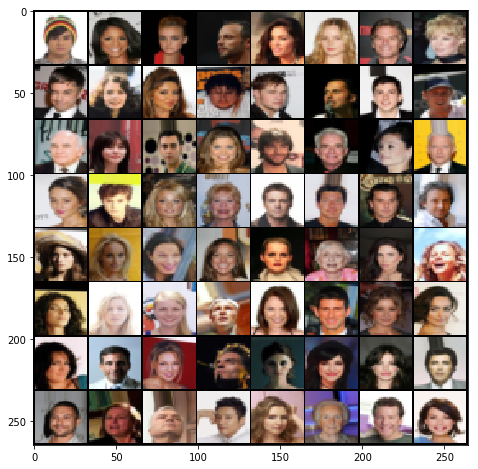

Black_Hair Not_Blond_Hair Not_Brown_Hair Not_Heavy_Makeup Male Smiling 
64 
32 
32 
3 


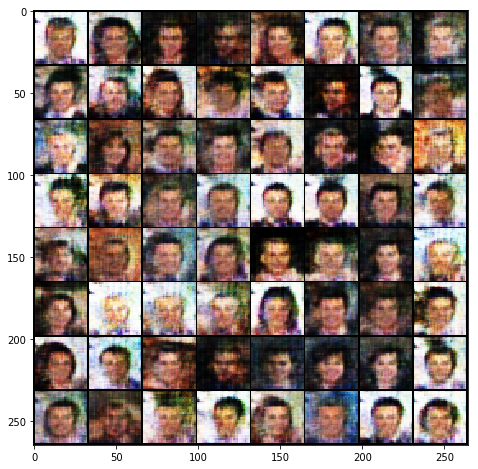

Not_Black_Hair Blond_Hair Not_Brown_Hair Not_Heavy_Makeup Male Smiling 
64 
32 
32 
3 


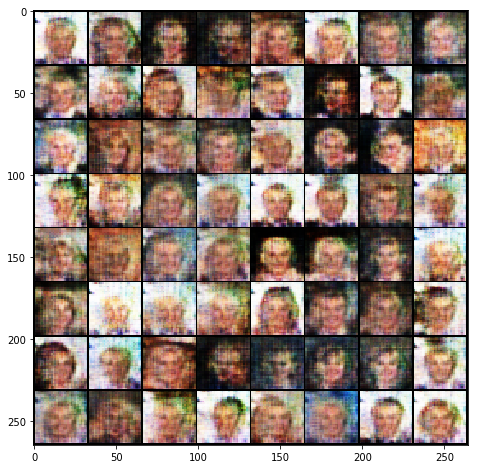

Not_Black_Hair Not_Blond_Hair Brown_Hair Not_Heavy_Makeup Male Smiling 
64 
32 
32 
3 


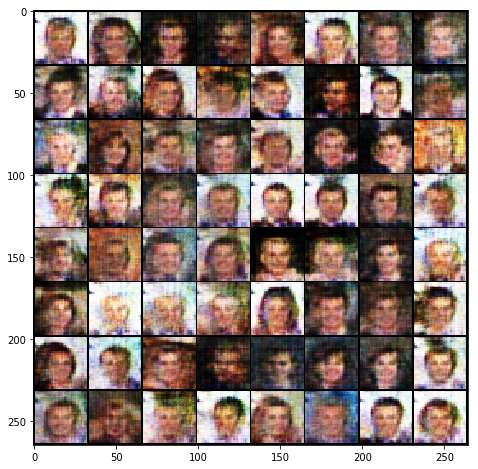

Black_Hair Not_Blond_Hair Not_Brown_Hair Heavy_Makeup Not_Male Smiling 
64 
32 
32 
3 


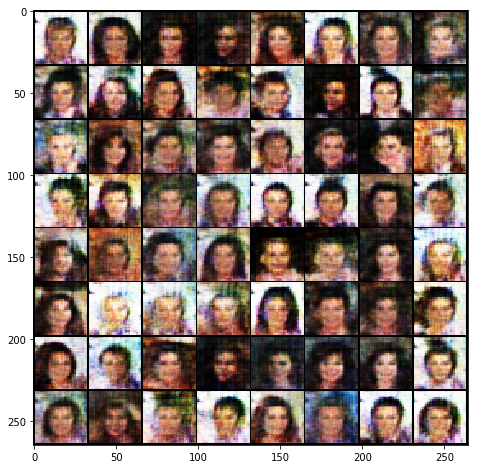

Not_Black_Hair Blond_Hair Not_Brown_Hair Heavy_Makeup Not_Male Smiling 
64 
32 
32 
3 


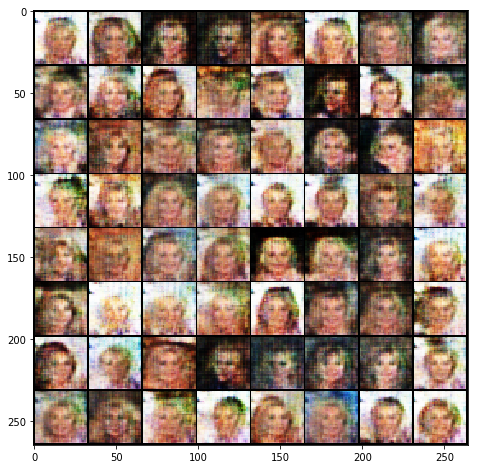

Not_Black_Hair Not_Blond_Hair Brown_Hair Heavy_Makeup Not_Male Smiling 
64 
32 
32 
3 


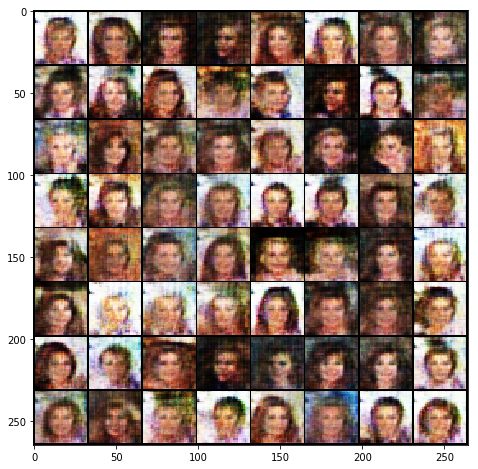

In [47]:

# cols = ["Black_Hair", "Blond_Hair", "Brown_Hair", "Heavy_Makeup", "Male", "Smiling"]
# Male, 1 # Smiling, 1
def createFeature(SampleFeature):
    size = len(SampleFeature)
    return np.array(SampleFeature).reshape((-1,size))

def printFeature(SampleFeature):
    cols = ["Black_Hair", "Blond_Hair", "Brown_Hair", "Heavy_Makeup", "Male", "Smiling"]
    size = len(SampleFeature[0])
    out = ""
    for i in xrange(size):
        if SampleFeature[0][i]:
            out = out + cols[i] + " "
        else:
            out = out + "Not_" + cols[i] + " "
    return out

# store sample feature
feature_samples = []
feature_samples.append(createFeature([1, 0, 0, 0, 1, 1]))
feature_samples.append(createFeature([0, 1, 0, 0, 1, 1]))
feature_samples.append(createFeature([0, 0, 1, 0, 1, 1]))
# Male, not Smile
feature_samples.append(createFeature([1, 0, 0, 1, 0, 1]))
# Female, not Smile
feature_samples.append(createFeature([0, 1, 0, 1, 0, 1]))
# Female, Smiling
feature_samples.append(createFeature([0, 0, 1, 1, 0, 1]))


tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
        saver.restore(sess, 'model1126_20k/dcgan_5')
        
        
        n = np.random.randint(0, high = num_of_img - 64)
        print "original images from {0} to {1}".format(n, n+64)
        
        fig = plt.figure(figsize = (8, 8)) 
        ax0 = plt.subplot(111)
        image = viz_grid(celeb_data[n:n+64], 1)
        ax0.imshow(image)
        plt.show()
        
        for ft in feature_samples:
            print printFeature(ft)
            fig = plt.figure(figsize = (8, 8)) 
            ax1 = plt.subplot(111)
            image = viz_grid(dcgan.generate(celeb_data[n:n+64], ft), 1)
            ax1.imshow(image)
            plt.show()




## Change input as image and modify attributes
* take one image from dataset as input
* feed into model

In [ ]:
tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
        saver.restore(sess, 'model_1124/dcgan')
        
        inp = train_samples[0][0:64]
        
        fig = plt.figure(figsize = (8, 8)) 
        ax1 = plt.subplot(111)
        image = viz_grid(inp, 1)
        #scipy.misc.imsave(filename, image)
        ax1.imshow(image)
        plt.show()
        
        ft = createFeature([1,0])
        inp = train_samples[0][0:64]
        
        fig = plt.figure(figsize = (8, 8)) 
        ax1 = plt.subplot(111)
        
        image = viz_grid(dcgan.generate(inp, ft), 1)
        #scipy.misc.imsave(filename, image)
        ax1.imshow(image)
        plt.show()
        
        ft = createFeature([0,1])
        inp = train_samples[0][0:64]
        
        fig = plt.figure(figsize = (8, 8)) 
        ax1 = plt.subplot(111)
        
        image = viz_grid(dcgan.generate(inp, ft), 1)
        #scipy.misc.imsave(filename, image)
        ax1.imshow(image)
        plt.show()
        
        ft = createFeature([1,1])
        inp = train_samples[0][0:64]
        
        fig = plt.figure(figsize = (8, 8)) 
        ax1 = plt.subplot(111)
        
        image = viz_grid(dcgan.generate(inp, ft), 1)
        #scipy.misc.imsave(filename, image)
        ax1.imshow(image)
        plt.show()
        
        ft = createFeature([0,0])
        inp = train_samples[0][0:64]
        
        fig = plt.figure(figsize = (8, 8)) 
        ax1 = plt.subplot(111)
        
        image = viz_grid(dcgan.generate(inp, ft), 1)
        #scipy.misc.imsave(filename, image)
        ax1.imshow(image)
        plt.show()
        